# MÉTODO DE ENTRADA DE VENTANA FECHA Y VALOR 288 - 96

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [2]:
import tensorflow as tf
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
from array import *
from pickle import dump
import math

import numpy as np
import pandas as pd
import seaborn as sns

np.random.seed(123)

from sklearn.preprocessing import StandardScaler, MinMaxScaler, MaxAbsScaler
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [3]:
FILEPATH = "../../datasources/THC-id-17.csv"
df_original = pd.read_csv(FILEPATH, parse_dates=True)

FILEPATH = "../../datasources/THC-id-17-preprocessed.csv"
df = pd.read_csv(FILEPATH, parse_dates=True)

In [4]:
df_original

,datetime,id,value
0,2019-01-01 03:00:00,17.0,0.087
1,2019-01-01 03:15:00,17.0,0.100
2,2019-01-01 03:30:00,17.0,0.084
3,2019-01-01 03:45:00,17.0,0.057
4,2019-01-01 04:00:00,17.0,0.167
...,...,...,...
64588,2020-11-03 22:00:00,17.0,0.031
64589,2020-11-03 22:15:00,17.0,0.055
64590,2020-11-03 22:30:00,17.0,0.019
64591,2020-11-03 22:45:00,17.0,0.021


In [5]:
df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
0,0.707107,0.707107,-0.993712,-0.111964,0.004172,0.999991,0.087
1,0.751840,0.659346,-0.994716,-0.102669,0.004351,0.999991,0.100
2,0.793353,0.608761,-0.995632,-0.093364,0.004530,0.999990,0.084
3,0.831470,0.555570,-0.996461,-0.084051,0.004709,0.999989,0.057
4,0.866025,0.500000,-0.997204,-0.074730,0.004888,0.999988,0.167
...,...,...,...,...,...,...,...
64588,-0.500000,0.866025,-0.826239,0.563320,-0.835100,0.550099,0.031
64589,-0.442289,0.896873,-0.820936,0.571021,-0.835001,0.550248,0.055
64590,-0.382683,0.923880,-0.815561,0.578671,-0.834902,0.550398,0.019
64591,-0.321439,0.946930,-0.810115,0.586271,-0.834804,0.550548,0.021


In [6]:
df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
0,0.707107,0.707107,-0.993712,-0.111964,0.004172,0.999991,0.087
1,0.751840,0.659346,-0.994716,-0.102669,0.004351,0.999991,0.100
2,0.793353,0.608761,-0.995632,-0.093364,0.004530,0.999990,0.084
3,0.831470,0.555570,-0.996461,-0.084051,0.004709,0.999989,0.057
4,0.866025,0.500000,-0.997204,-0.074730,0.004888,0.999988,0.167
...,...,...,...,...,...,...,...
64588,-0.500000,0.866025,-0.826239,0.563320,-0.835100,0.550099,0.031
64589,-0.442289,0.896873,-0.820936,0.571021,-0.835001,0.550248,0.055
64590,-0.382683,0.923880,-0.815561,0.578671,-0.834902,0.550398,0.019
64591,-0.321439,0.946930,-0.810115,0.586271,-0.834804,0.550548,0.021


### División de los datos

In [7]:
train_df, aux = train_test_split(df, test_size=0.3, shuffle=False)
test_df, val_df = train_test_split(aux, test_size=0.5, shuffle=False)

In [8]:
train_df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
0,0.707107,0.707107,-0.993712,-0.111964,0.004172,0.999991,0.087
1,0.751840,0.659346,-0.994716,-0.102669,0.004351,0.999991,0.100
2,0.793353,0.608761,-0.995632,-0.093364,0.004530,0.999990,0.084
3,0.831470,0.555570,-0.996461,-0.084051,0.004709,0.999989,0.057
4,0.866025,0.500000,-0.997204,-0.074730,0.004888,0.999988,0.167
...,...,...,...,...,...,...,...
45210,0.382683,0.923880,0.056070,0.998427,0.968510,-0.248976,0.041
45211,0.442289,0.896873,0.065403,0.997859,0.968465,-0.249150,0.024
45212,0.500000,0.866025,0.074730,0.997204,0.968420,-0.249323,0.017
45213,0.555570,0.831470,0.084051,0.996461,0.968376,-0.249497,0.046


In [9]:
test_df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
45215,6.593458e-01,0.751840,0.102669,0.994716,0.968286,-0.249844,0.016
45216,7.071068e-01,0.707107,0.111964,0.993712,0.968241,-0.250017,0.046
45217,7.518398e-01,0.659346,0.121251,0.992622,0.968197,-0.250191,0.009
45218,7.933533e-01,0.608761,0.130526,0.991445,0.968152,-0.250364,0.003
45219,8.314696e-01,0.555570,0.139790,0.990181,0.968107,-0.250538,0.034
...,...,...,...,...,...,...,...
54899,-6.540313e-02,0.997859,0.442289,-0.896873,-0.405068,-0.914287,0.018
54900,-5.539676e-12,1.000000,0.433884,-0.900969,-0.405231,-0.914214,0.018
54901,6.540313e-02,0.997859,0.425441,-0.904986,-0.405395,-0.914142,0.038
54902,1.305262e-01,0.991445,0.416961,-0.908924,-0.405559,-0.914069,0.039


In [10]:
val_df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
54904,0.258819,0.965926,0.399892,-0.916562,-0.405887,-0.913923,0.018
54905,0.321439,0.946930,0.391305,-0.920261,-0.406050,-0.913851,0.017
54906,0.382683,0.923880,0.382683,-0.923880,-0.406214,-0.913778,0.018
54907,0.442289,0.896873,0.374029,-0.927417,-0.406378,-0.913705,0.048
54908,0.500000,0.866025,0.365341,-0.930874,-0.406541,-0.913632,0.024
...,...,...,...,...,...,...,...
64588,-0.500000,0.866025,-0.826239,0.563320,-0.835100,0.550099,0.031
64589,-0.442289,0.896873,-0.820936,0.571021,-0.835001,0.550248,0.055
64590,-0.382683,0.923880,-0.815561,0.578671,-0.834902,0.550398,0.019
64591,-0.321439,0.946930,-0.810115,0.586271,-0.834804,0.550548,0.021


## Funciones auxiliares

In [11]:
def split_data(data, n_input, n_out):
    X, y = list(), list()
    in_start = 0
    
    for _ in range(len(data)):
        in_end = in_start + n_input
        out_end = in_end + n_out
        if out_end <= len(data):
            X.append(np.array(data.iloc[in_start:in_end, :]))
            y.append(np.array(data.iloc[in_end:out_end, -1]))
        in_start += 1
        
    return np.array(X).reshape(len(X), n_input, data.shape[1]), np.array(y)

In [12]:
def plot_history(history):
    hist = pd.DataFrame(history.history)
    hist['epoch'] = history.epoch
    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Abs Error [MPG]')
    plt.plot(hist['epoch'], hist['mae'], label='Train Error')
    plt.plot(hist['epoch'], hist['val_mae'], label = 'Val Error')
    plt.ylim(bottom=0)
    plt.legend()
    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Square Error [$MPG^2$]')
    plt.plot(hist['epoch'], hist['mse'], label='Train Error')
    plt.plot(hist['epoch'], hist['val_mse'], label = 'Val Error')
    plt.ylim(bottom=0)
    plt.legend()
    plt.show()

In [13]:
def plot_window_predictions(index_min, index_max, real_outputs, pred_outputs, num_plots, start):
    for n in range(start, start + num_plots):
        limit = index_min + n + n_entrada
        input_indices = np.array(df_original['datetime'].iloc[index_min + n : limit])
        input_values = np.array(df_original['value'].iloc[index_min + n : limit])
        output_indices = np.array(df_original['datetime'].iloc[limit : limit + n_predicciones])
        real_values = real_outputs[n]
        pred_values = pred_outputs[n]
        
        plt.figure()
        plt.xlabel('Time')
        plt.ylabel(f'Valores de prediccion - Iteracion {n+1}')
        plt.scatter(input_indices, input_values, color='b',zorder=2)
        plt.plot(input_indices, input_values, label='Inputs', color='b', zorder=1)
        plt.scatter(output_indices, real_values, edgecolors='k', label='Real output', c='#2ca02c', s=64)
        plt.scatter(output_indices, pred_values, marker='X', edgecolors='k', label='Prediction output', c='#ff7f0e', s=64)
        plt.xticks(rotation = 90)
        plt.legend()

In [14]:
def plot_window_predictions_values(index_min, pred_outputs, max_plots):
    plt.figure()
    plt.xlabel('Time')
    plt.ylabel(f'Valores de prediccion')
    plt.plot(np.array(df_original['datetime'].iloc[index_min + n_entrada : index_min + n_entrada + max_plots + n_predicciones]), 
             np.array(df_original['value'].iloc[index_min + n_entrada : index_min + n_entrada + max_plots + n_predicciones]), 
             color='b', zorder=1)
    
    for n in range(max_plots):
        limit = index_min + n + n_entrada
        output_indices = np.array(df_original['datetime'].iloc[limit : limit + n_predicciones])
        pred_values = pred_outputs[n]
        
        plt.scatter(output_indices, pred_values, marker='X', edgecolors='k', label='Prediction output', c='#ff7f0e', s=64)
        plt.xticks(rotation = 90)

In [15]:
import tensorflow.keras.backend as K

def smape(y_true, y_pred):
    return K.mean(2*K.abs(y_pred-y_true)/(K.abs(y_true)+K.abs(y_pred)))

## Parámetros
####  En este caso vamos a generar una ventana de 288 valores de entrada que corresponde a los 3 días anteriores y una salida de 96 valores que corresponden al consumo del siguiente día

In [16]:
###### PARAMETERS ######
n_epochs = 200
batch_size = 128
n_entrada = 288           # Número de mediciones en los 3 días anteriores
n_predicciones = 96       # Mediciones en un día
n_features = df.shape[1] 
########################

## Extraer datos de entrada y salida

In [17]:
data_trainX, data_trainY = split_data(train_df, n_entrada, n_predicciones)
data_valX, data_valY = split_data(val_df, n_entrada, n_predicciones)
data_testX, data_testY = split_data(test_df, n_entrada, n_predicciones)

In [18]:
data_trainX.shape

(44832, 288, 7)

In [19]:
data_trainY.shape

(44832, 96)

In [20]:
data_valX.shape

(9306, 288, 7)

In [21]:
data_valY.shape

(9306, 96)

In [22]:
data_testX.shape

(9306, 288, 7)

In [23]:
data_testY.shape

(9306, 96)

In [24]:
data_trainX[0]

array([[ 0.70710678,  0.70710678, -0.99371221, ...,  0.00417166,
         0.9999913 ,  0.087     ],
       [ 0.75183981,  0.65934582, -0.99471562, ...,  0.00435086,
         0.99999053,  0.1       ],
       [ 0.79335334,  0.60876143, -0.99563208, ...,  0.00453005,
         0.99998974,  0.084     ],
       ...,
       [ 0.55557023,  0.83146961,  0.83146961, ...,  0.05521432,
         0.99847453,  0.051     ],
       [ 0.60876143,  0.79335334,  0.83662776, ...,  0.05539325,
         0.99846462,  0.015     ],
       [ 0.65934582,  0.75183981,  0.84171277, ...,  0.05557217,
         0.99845467,  0.016     ]])

In [25]:
data_trainY[0]

array([0.041, 0.01 , 0.015, 0.04 , 0.007, 0.014, 0.041, 0.003, 0.013,
       0.041, 0.004, 0.01 , 0.04 , 0.004, 0.006, 0.042, 0.007, 0.005,
       0.039, 0.013, 0.004, 0.026, 0.023, 0.004, 0.012, 0.036, 0.004,
       0.004, 0.032, 0.015, 0.004, 0.012, 0.035, 0.004, 0.004, 0.11 ,
       0.424, 0.406, 0.442, 0.384, 0.162, 0.169, 0.017, 0.005, 0.122,
       0.036, 0.004, 0.097, 0.041, 0.018, 0.018, 0.185, 0.063, 0.08 ,
       0.064, 0.03 , 0.041, 0.063, 0.035, 0.116, 0.096, 0.04 , 0.039,
       0.066, 0.063, 0.063, 0.062, 0.026, 0.047, 0.063, 0.062, 0.061,
       0.061, 0.062, 0.033, 0.186, 0.09 , 0.203, 0.063, 0.198, 0.08 ,
       0.057, 0.04 , 0.098, 0.223, 0.075, 0.081, 0.048, 0.064, 0.063,
       0.027, 0.039, 0.059, 0.028, 0.032, 0.05 ])

## Estandarización y normalización de los datos

In [26]:
# Normalizado
maxabs_scaler = MaxAbsScaler()
    
maxabs_scaler.fit(data_trainX.reshape(-1, data_trainX.shape[-1]))
    
scaled_trainX = maxabs_scaler.transform(data_trainX.reshape(-1, data_trainX.shape[-1])).reshape(data_trainX.shape)
scaled_valX = maxabs_scaler.transform(data_valX.reshape(-1, data_valX.shape[-1])).reshape(data_valX.shape)
scaled_testX = maxabs_scaler.transform(data_testX.reshape(-1, data_testX.shape[-1])).reshape(data_testX.shape)

In [27]:
scaled_trainX.shape

(44832, 288, 7)

In [28]:
scaled_valX.shape

(9306, 288, 7)

In [29]:
scaled_testX.shape

(9306, 288, 7)

In [30]:
scaled_trainX[0]

array([[ 0.70710678,  0.70710678, -0.99371221, ...,  0.00417166,
         0.9999913 ,  0.12869822],
       [ 0.75183981,  0.65934582, -0.99471562, ...,  0.00435086,
         0.99999053,  0.14792899],
       [ 0.79335334,  0.60876143, -0.99563208, ...,  0.00453005,
         0.99998974,  0.12426036],
       ...,
       [ 0.55557023,  0.83146961,  0.83146961, ...,  0.05521432,
         0.99847453,  0.07544379],
       [ 0.60876143,  0.79335334,  0.83662776, ...,  0.05539325,
         0.99846462,  0.02218935],
       [ 0.65934582,  0.75183981,  0.84171277, ...,  0.05557217,
         0.99845467,  0.02366864]])

### Algunos modelos necesitan otros tipos de entrada

In [31]:
scaled_trainX_4D = scaled_trainX.reshape(scaled_trainX.shape[0], 1, n_entrada, n_features)
scaled_valX_4D = scaled_valX.reshape(scaled_valX.shape[0], 1, n_entrada, n_features)
scaled_testX_4D = scaled_testX.reshape(scaled_testX.shape[0], 1, n_entrada, n_features)

scaled_trainX_5D = scaled_trainX.reshape(scaled_trainX.shape[0], 1, 1, n_entrada, n_features)
scaled_valX_5D = scaled_valX.reshape(scaled_valX.shape[0], 1, 1, n_entrada, n_features)
scaled_testX_5D = scaled_testX.reshape(scaled_testX.shape[0], 1, 1, n_entrada, n_features)

data_trainY_3D = data_trainY.reshape(data_trainY.shape[0], 1, n_predicciones)
data_valY_3D = data_valY.reshape(data_valY.shape[0], 1, n_predicciones)
data_testY_3D = data_testY.reshape(data_testY.shape[0], 1, n_predicciones)

data_trainY_3D_2 = data_trainY.reshape(data_trainY.shape[0], n_predicciones, 1)
data_valY_3D_2 = data_valY.reshape(data_valY.shape[0], n_predicciones, 1)
data_testY_3D_2 = data_testY.reshape(data_testY.shape[0], n_predicciones, 1)

### Early stopping

In [32]:
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=100)

# MODELO 1: LSTM DE UNA CAPA

### Construimos el modelo

In [33]:
def build_model1():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [34]:
model1 = build_model1()
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 128)               69632     
                                                                 
 dense (Dense)               (None, 96)                12384     
                                                                 
Total params: 82,016
Trainable params: 82,016
Non-trainable params: 0
_________________________________________________________________


2022-06-24 05:40:40.150545: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-06-24 05:40:40.629705: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 27984 MB memory:  -> device: 0, name: Tesla V100-PCIE-32GB, pci bus id: 0000:5b:00.0, compute capability: 7.0


### Entrenamiento del modelo

In [35]:
history1 = model1.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200


2022-06-24 05:40:43.038799: I tensorflow/stream_executor/cuda/cuda_dnn.cc:366] Loaded cuDNN version 8100


351/351 [==============================] - 14s 35ms/step - loss: 0.0065 - mae: 0.0485 - mse: 0.0065 - smape: 0.8717 - val_loss: 0.0066 - val_mae: 0.0489 - val_mse: 0.0066 - val_smape: 0.9496
Epoch 2/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0059 - mae: 0.0462 - mse: 0.0059 - smape: 0.8246 - val_loss: 0.0066 - val_mae: 0.0476 - val_mse: 0.0066 - val_smape: 0.8872
Epoch 3/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0057 - mae: 0.0451 - mse: 0.0057 - smape: 0.8076 - val_loss: 0.0066 - val_mae: 0.0471 - val_mse: 0.0066 - val_smape: 0.8612
Epoch 4/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0056 - mae: 0.0442 - mse: 0.0056 - smape: 0.7903 - val_loss: 0.0068 - val_mae: 0.0481 - val_mse: 0.0068 - val_smape: 0.8613
Epoch 5/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0055 - mae: 0.0437 - mse: 0.0055 - smape: 0.7845 - val_loss: 0.0067 - val_mae: 0.0464 - val_mse: 0.0067 - val_smape: 0.83

351/351 [==============================] - 12s 35ms/step - loss: 0.0031 - mae: 0.0341 - mse: 0.0031 - smape: 0.7356 - val_loss: 0.0079 - val_mae: 0.0485 - val_mse: 0.0079 - val_smape: 0.8522
Epoch 82/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0031 - mae: 0.0343 - mse: 0.0031 - smape: 0.7352 - val_loss: 0.0083 - val_mae: 0.0472 - val_mse: 0.0083 - val_smape: 0.8458
Epoch 83/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0027 - mae: 0.0325 - mse: 0.0027 - smape: 0.7258 - val_loss: 0.0085 - val_mae: 0.0481 - val_mse: 0.0085 - val_smape: 0.8673
Epoch 84/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0027 - mae: 0.0325 - mse: 0.0027 - smape: 0.7253 - val_loss: 0.0085 - val_mae: 0.0487 - val_mse: 0.0085 - val_smape: 0.8602
Epoch 85/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0027 - mae: 0.0326 - mse: 0.0027 - smape: 0.7262 - val_loss: 0.0084 - val_mae: 0.0484 - val_mse: 0.0084 - val_smape: 

In [36]:
hist1 = pd.DataFrame(history1.history)
hist1['epoch'] = history1.epoch
hist1

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006482,0.048482,0.006482,0.871741,0.006623,0.048941,0.006623,0.949577,0
1,0.005923,0.046159,0.005923,0.824642,0.006556,0.047586,0.006556,0.887202,1
2,0.005695,0.045085,0.005695,0.807641,0.006618,0.047079,0.006618,0.861235,2
3,0.005564,0.044212,0.005564,0.790300,0.006789,0.048145,0.006789,0.861288,3
4,0.005482,0.043728,0.005482,0.784508,0.006665,0.046375,0.006665,0.832088,4
...,...,...,...,...,...,...,...,...,...
97,0.002657,0.032271,0.002657,0.722968,0.008409,0.047793,0.008409,0.861439,97
98,0.002583,0.031907,0.002583,0.720345,0.008454,0.047850,0.008454,0.857779,98
99,0.002629,0.032137,0.002629,0.721875,0.008363,0.047442,0.008363,0.848569,99
100,0.002541,0.031704,0.002541,0.718949,0.008530,0.048093,0.008530,0.864564,100


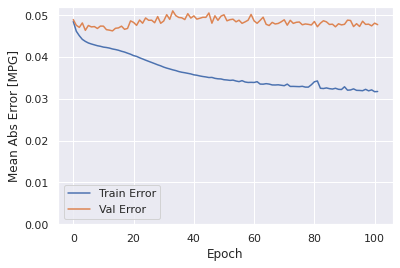

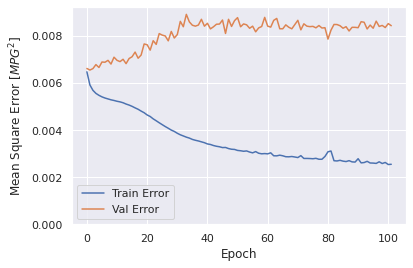

In [37]:
sns.set(rc = {'figure.figsize':(15,5), 'figure.dpi':80})
plot_history(history1)

### Evaluar predicciones

In [38]:
score_train1 = model1.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train1[0]}')
print(f'MAE:{score_train1[1]}')
print(f'MSE:{score_train1[2]}')
print(f'SMAPE:{score_train1[3]}')

1401/1401 [==============================] - 20s 14ms/step - loss: 0.0026 - mae: 0.0321 - mse: 0.0026 - smape: 0.7177
Loss:0.002597985789179802
MAE:0.03209807723760605
MSE:0.002597985789179802
SMAPE:0.7176526784896851


In [39]:
score_val1 = model1.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val1[0]}')
print(f'MAE:{score_val1[1]}')
print(f'MSE:{score_val1[2]}')
print(f'SMAPE:{score_val1[3]}')

291/291 [==============================] - 4s 14ms/step - loss: 0.0084 - mae: 0.0477 - mse: 0.0084 - smape: 0.8521
Loss:0.008442050777375698
MAE:0.04773017764091492
MSE:0.008442050777375698
SMAPE:0.8521431088447571


In [40]:
score_test1 = model1.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test1[0]}') 
print(f'MAE:{score_test1[1]}')
print(f'MSE:{score_test1[2]}')
print(f'SMAPE:{score_test1[3]}')

291/291 [==============================] - 4s 15ms/step - loss: 0.0075 - mae: 0.0493 - mse: 0.0075 - smape: 0.8316
Loss:0.007532471790909767
MAE:0.04929358512163162
MSE:0.007532471790909767
SMAPE:0.8316468000411987


### Comparativa de resultados

In [41]:
result = hist1.iloc[-1]
comparativa1 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test1[1], score_test1[2], score_test1[3], math.sqrt(score_test1[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa1.style.set_caption("Método de ventana de varios pasos - LSTM de una capa")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.031753,0.002551,0.719228,0.050512
VALIDACION,0.047730,0.008442,0.852720,0.091881
TEST,0.049294,0.007532,0.831647,0.086790


### Obtener predicciones

In [42]:
trainPredict1 = model1.predict(scaled_trainX)
testPredict1 = model1.predict(scaled_testX)

### Visualización de las predicciones

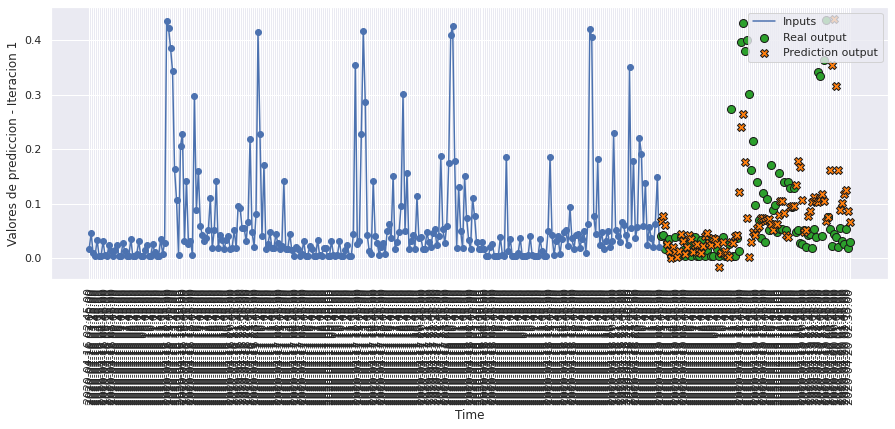

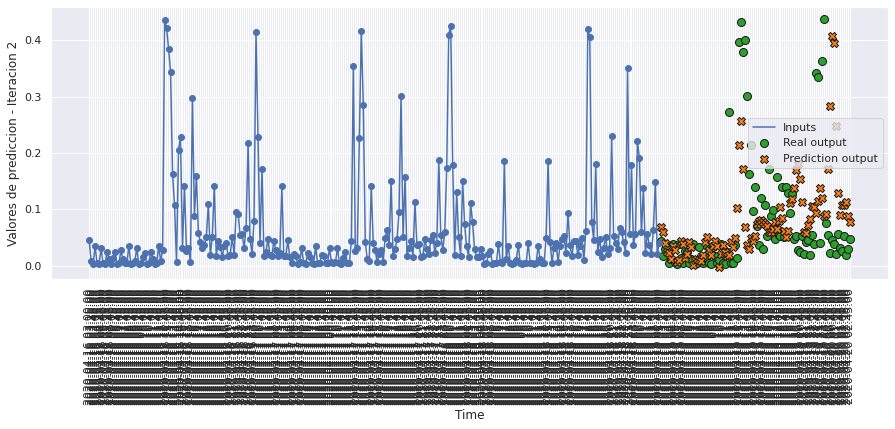

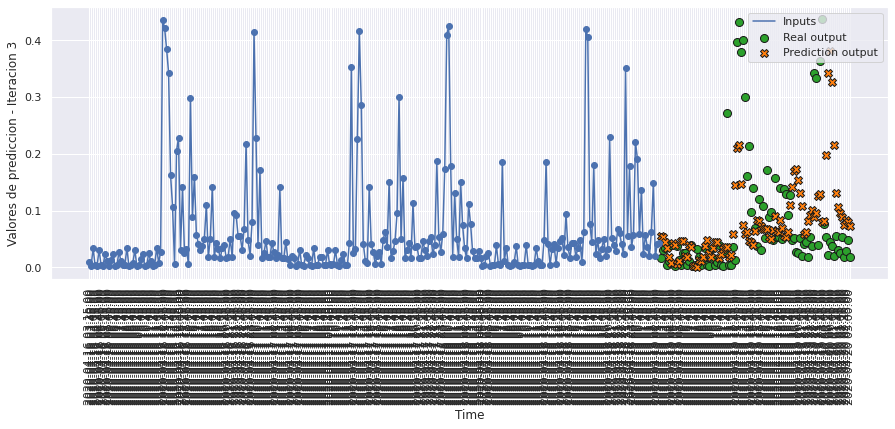

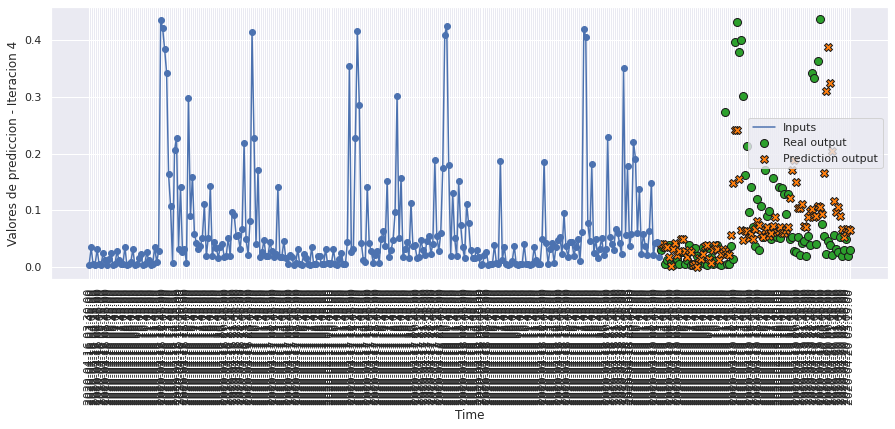

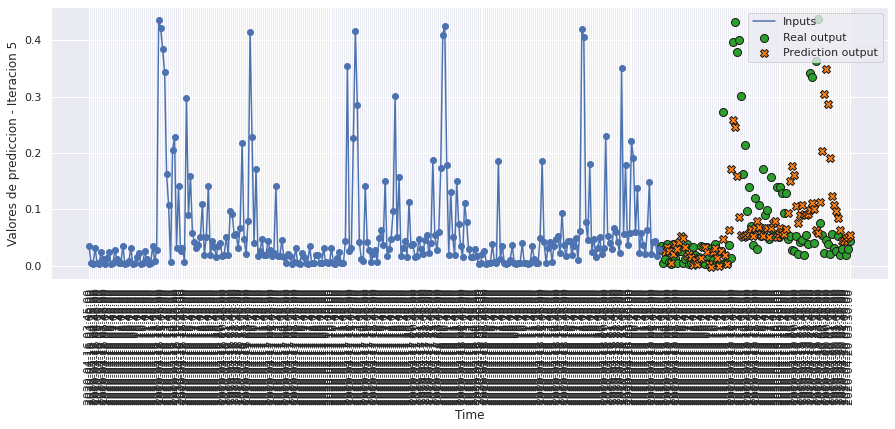

...

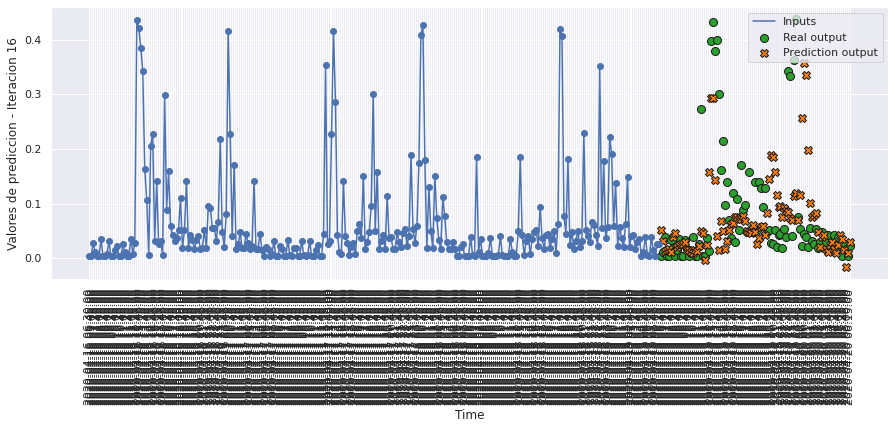

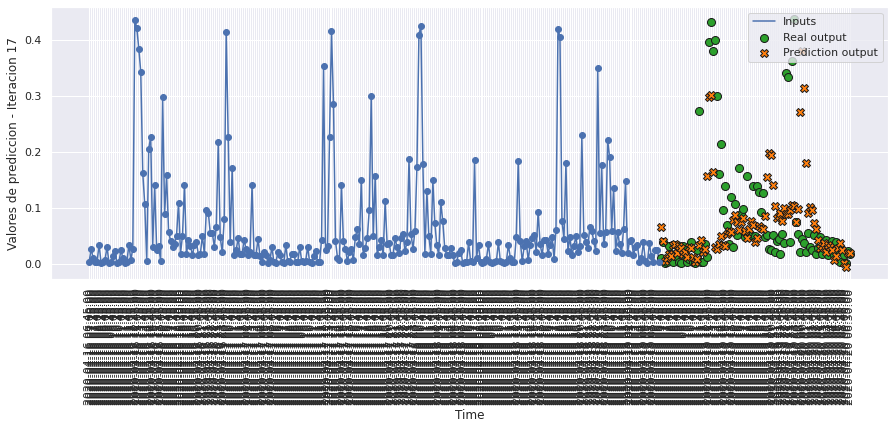

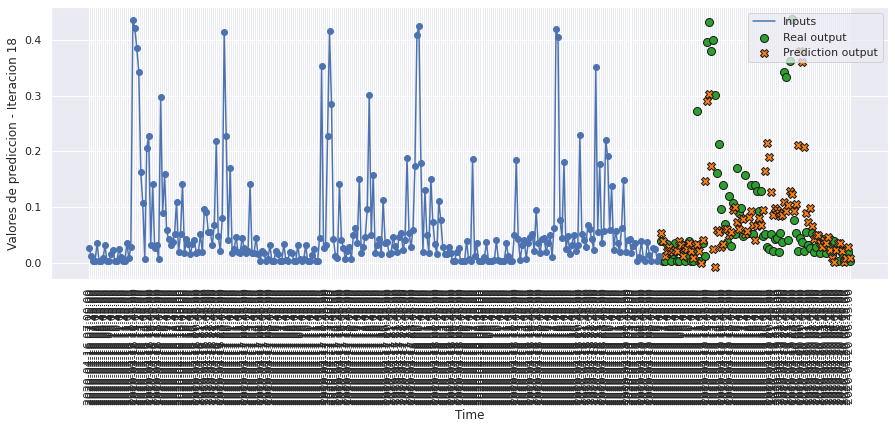

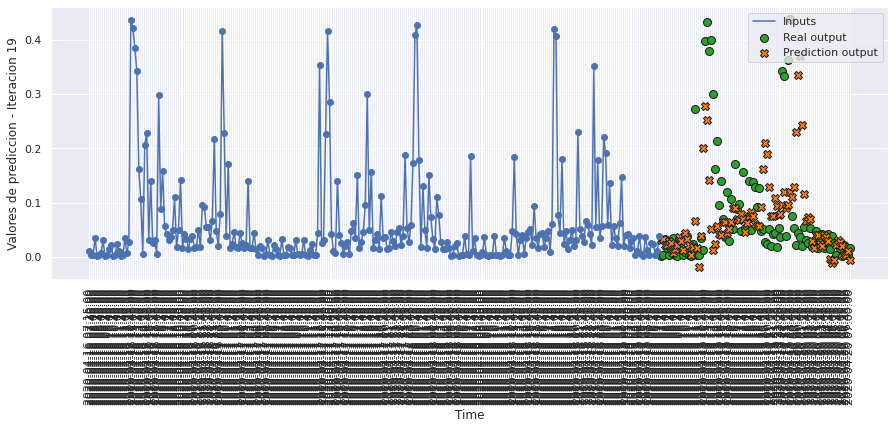

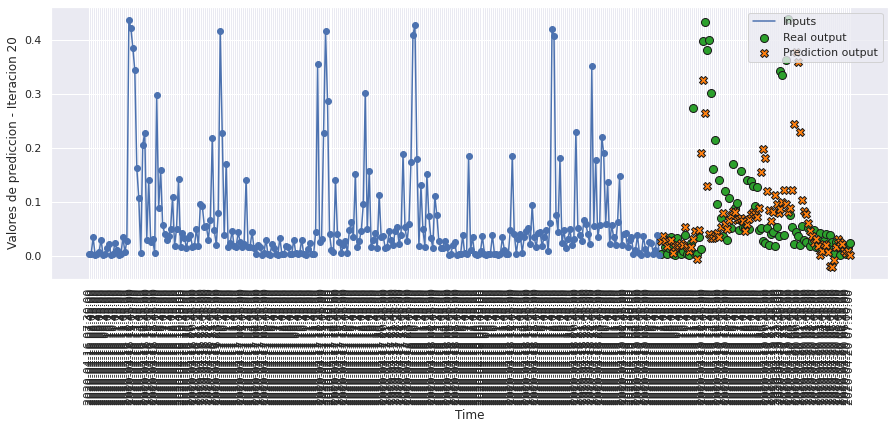

In [43]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict1, 20, 0)

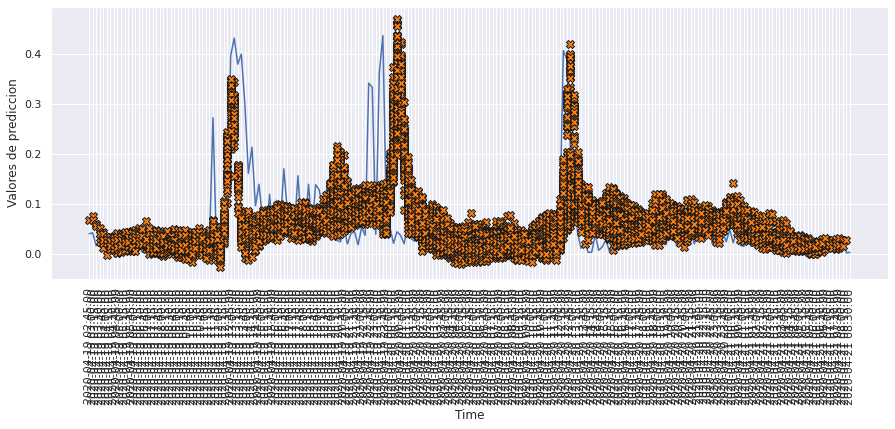

In [44]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict1, 120)

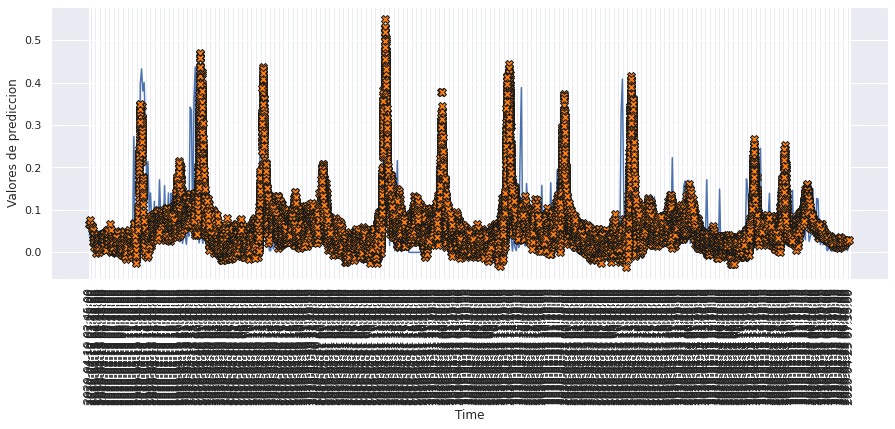

In [45]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict1, 500)

# MODELO 2: LSTM DE DOS CAPAS

### Construimos el modelo

In [46]:
def build_model2():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences = True),
        tf.keras.layers.LSTM(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [47]:
model2 = build_model2()
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 288, 128)          69632     
                                                                 
 lstm_2 (LSTM)               (None, 128)               131584    
                                                                 
 dense_1 (Dense)             (None, 96)                12384     
                                                                 
Total params: 213,600
Trainable params: 213,600
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [48]:
history2 = model2.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 23s 61ms/step - loss: 0.0062 - mae: 0.0474 - mse: 0.0062 - smape: 0.8523 - val_loss: 0.0066 - val_mae: 0.0478 - val_mse: 0.0066 - val_smape: 0.8867
Epoch 2/200
351/351 [==============================] - 21s 60ms/step - loss: 0.0057 - mae: 0.0452 - mse: 0.0057 - smape: 0.8098 - val_loss: 0.0066 - val_mae: 0.0478 - val_mse: 0.0066 - val_smape: 0.8686
Epoch 3/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0055 - mae: 0.0441 - mse: 0.0055 - smape: 0.7873 - val_loss: 0.0069 - val_mae: 0.0481 - val_mse: 0.0069 - val_smape: 0.8632
Epoch 4/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0054 - mae: 0.0433 - mse: 0.0054 - smape: 0.7788 - val_loss: 0.0070 - val_mae: 0.0484 - val_mse: 0.0070 - val_smape: 0.8772
Epoch 5/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0053 - mae: 0.0428 - mse: 0.0053 - smape: 0.7711 - val_loss: 0.0070 - val_mae: 0.0478 - val_mse: 0.0070 - val

351/351 [==============================] - 22s 63ms/step - loss: 0.0017 - mae: 0.0267 - mse: 0.0017 - smape: 0.6746 - val_loss: 0.0091 - val_mae: 0.0495 - val_mse: 0.0091 - val_smape: 0.8817
Epoch 82/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0017 - mae: 0.0266 - mse: 0.0017 - smape: 0.6742 - val_loss: 0.0092 - val_mae: 0.0493 - val_mse: 0.0092 - val_smape: 0.8713
Epoch 83/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0017 - mae: 0.0267 - mse: 0.0017 - smape: 0.6741 - val_loss: 0.0093 - val_mae: 0.0494 - val_mse: 0.0093 - val_smape: 0.8813
Epoch 84/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0016 - mae: 0.0265 - mse: 0.0016 - smape: 0.6732 - val_loss: 0.0091 - val_mae: 0.0491 - val_mse: 0.0091 - val_smape: 0.8753
Epoch 85/200
351/351 [==============================] - 22s 61ms/step - loss: 0.0016 - mae: 0.0264 - mse: 0.0016 - smape: 0.6730 - val_loss: 0.0093 - val_mae: 0.0495 - val_mse: 0.0093 - val_smape: 

In [49]:
hist2 = pd.DataFrame(history2.history)
hist2['epoch'] = history2.epoch
hist2

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006246,0.047355,0.006246,0.852320,0.006623,0.047789,0.006623,0.886698,0
1,0.005742,0.045248,0.005742,0.809837,0.006648,0.047828,0.006648,0.868616,1
2,0.005539,0.044062,0.005539,0.787295,0.006875,0.048071,0.006875,0.863198,2
3,0.005405,0.043306,0.005405,0.778831,0.006985,0.048388,0.006985,0.877158,3
4,0.005298,0.042752,0.005298,0.771122,0.007039,0.047762,0.007039,0.851883,4
...,...,...,...,...,...,...,...,...,...
96,0.001578,0.026143,0.001578,0.671653,0.009404,0.049987,0.009404,0.891508,96
97,0.001521,0.025778,0.001521,0.667984,0.009536,0.050315,0.009536,0.889903,97
98,0.001516,0.025728,0.001516,0.667118,0.009362,0.049895,0.009362,0.884952,98
99,0.001507,0.025673,0.001507,0.666897,0.009441,0.050166,0.009441,0.895171,99


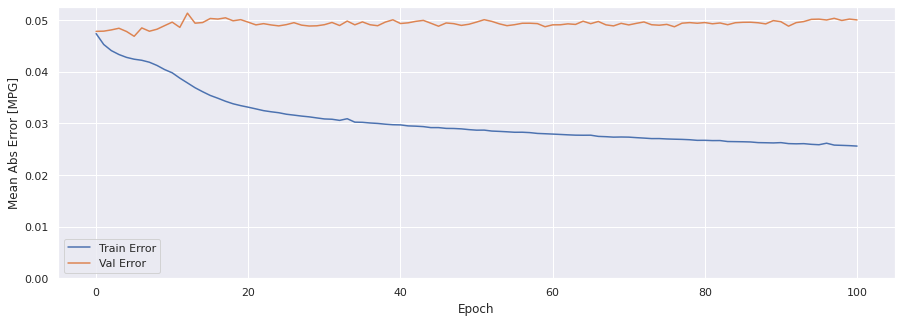

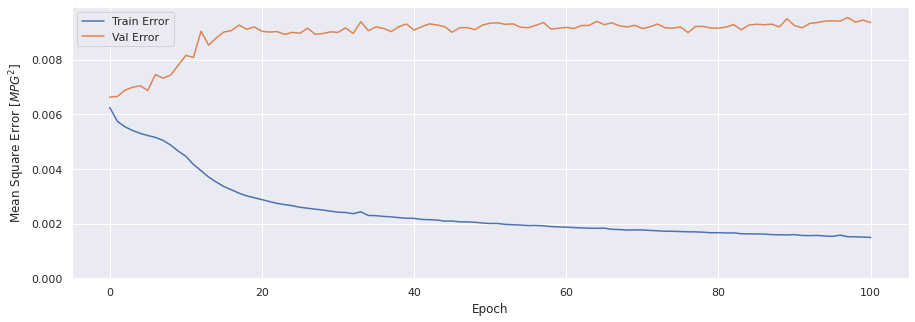

In [50]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history2)

### Evaluar predicciones

In [51]:
score_train2 = model2.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train2[0]}')
print(f'MAE:{score_train2[1]}')
print(f'MSE:{score_train2[2]}')
print(f'SMAPE:{score_train2[3]}')

1401/1401 [==============================] - 33s 23ms/step - loss: 0.0015 - mae: 0.0255 - mse: 0.0015 - smape: 0.6596
Loss:0.0014670295640826225
MAE:0.025493202731013298
MSE:0.0014670295640826225
SMAPE:0.6596252918243408


In [52]:
score_val2 = model2.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val2[0]}')
print(f'MAE:{score_val2[1]}')
print(f'MSE:{score_val2[2]}')
print(f'SMAPE:{score_val2[3]}')

291/291 [==============================] - 7s 25ms/step - loss: 0.0094 - mae: 0.0500 - mse: 0.0094 - smape: 0.8702
Loss:0.009350531734526157
MAE:0.050005875527858734
MSE:0.009350531734526157
SMAPE:0.870153546333313


In [53]:
score_test2 = model2.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test2[0]}')
print(f'MAE:{score_test2[1]}')
print(f'MSE:{score_test2[2]}')
print(f'SMAPE:{score_test2[3]}')

291/291 [==============================] - 7s 24ms/step - loss: 0.0083 - mae: 0.0521 - mse: 0.0083 - smape: 0.8874
Loss:0.008298661559820175
MAE:0.05212302505970001
MSE:0.008298661559820175
SMAPE:0.8873676061630249


### Comparativa de resultados

In [54]:
result = hist2.iloc[-1]
comparativa2 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test2[1], score_test2[2], score_test2[3], math.sqrt(score_test2[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa2.style.set_caption("Método de ventana de varios pasos - LSTM de dos capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.025588,0.001495,0.666238,0.038665
VALIDACION,0.050006,0.009351,0.870467,0.096698
TEST,0.052123,0.008299,0.887368,0.091097


### Obtener predicciones

In [55]:
trainPredict2 = model2.predict(scaled_trainX)
testPredict2 = model2.predict(scaled_testX)

### Visualización de las predicciones

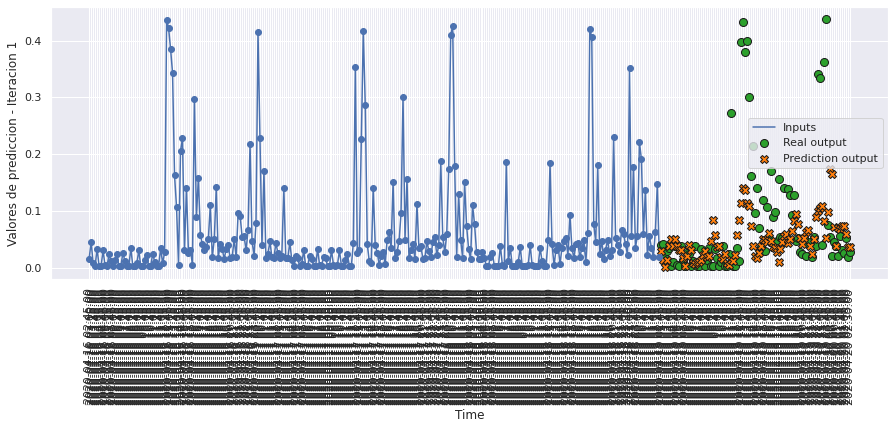

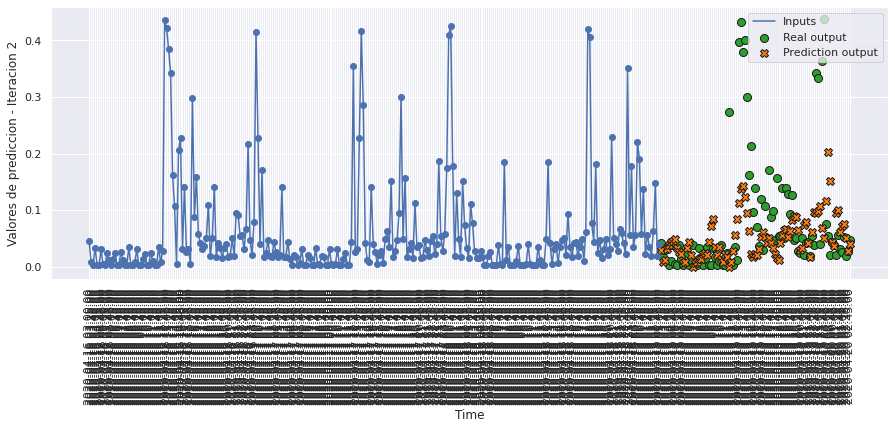

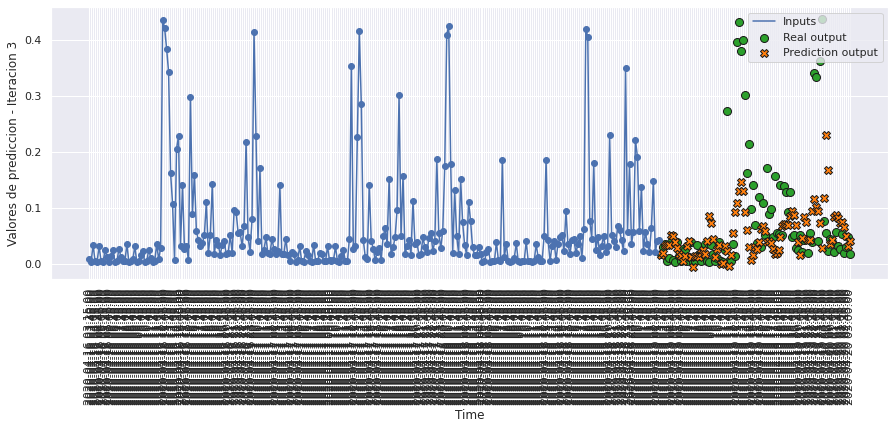

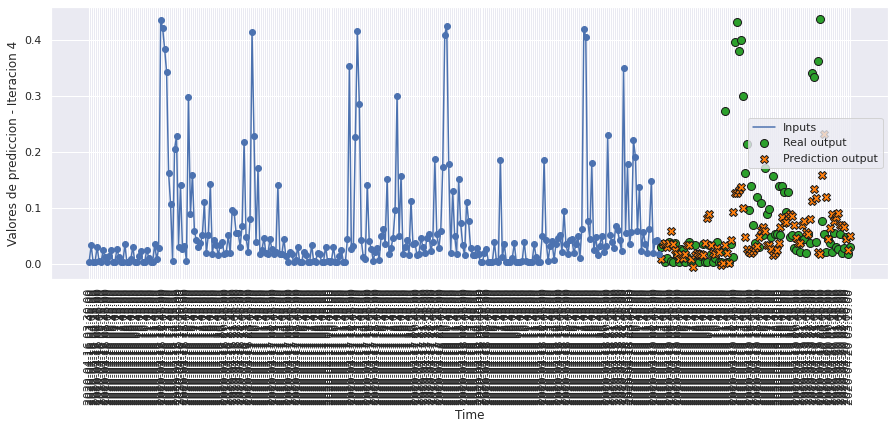

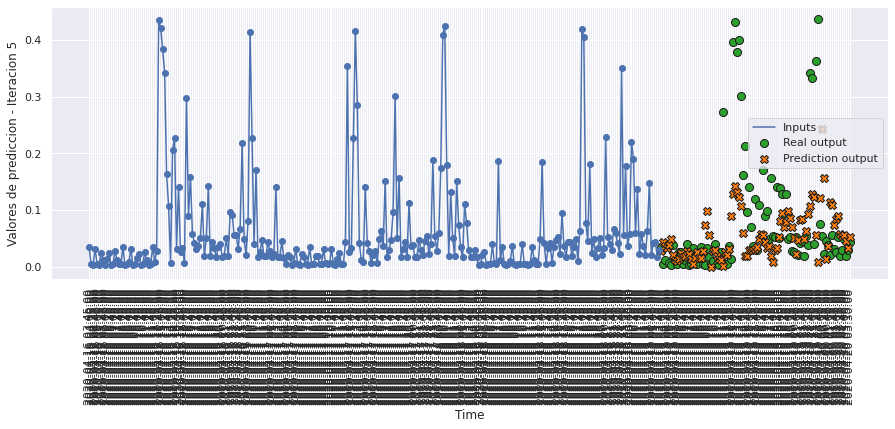

...

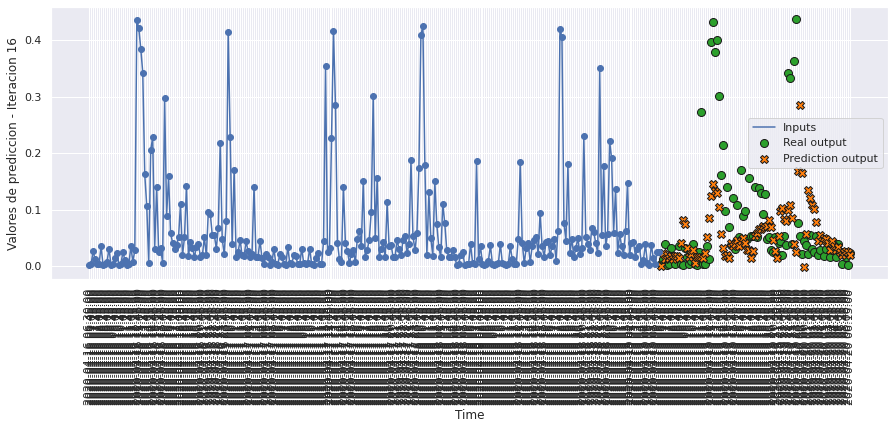

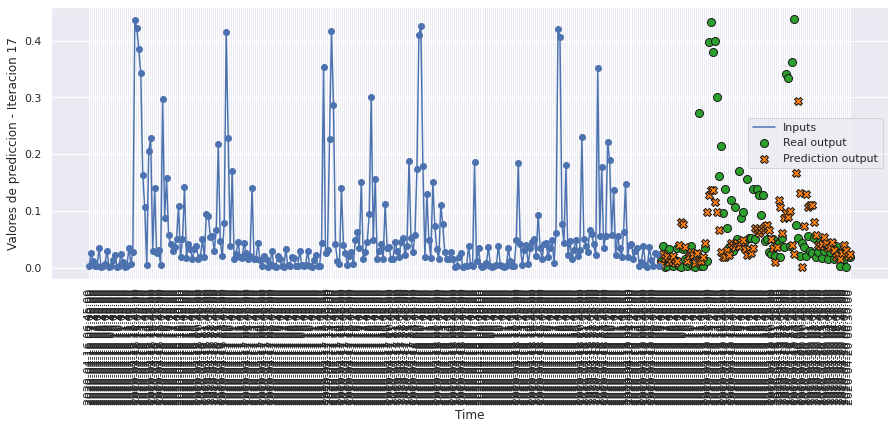

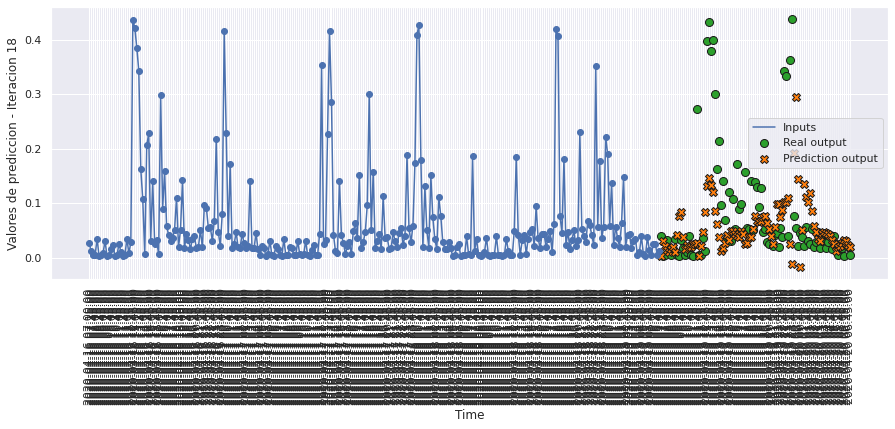

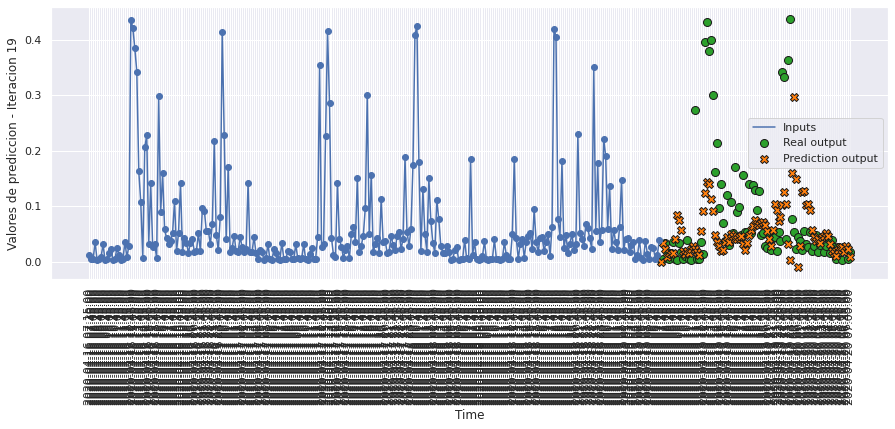

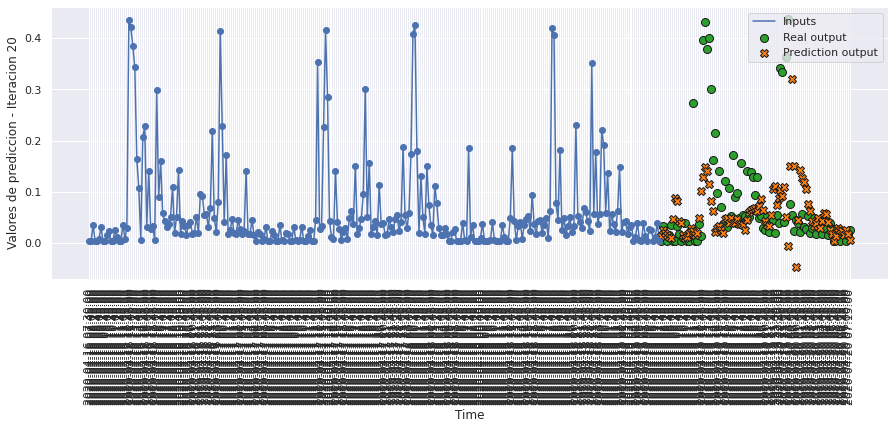

In [56]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict2, 20, 0)

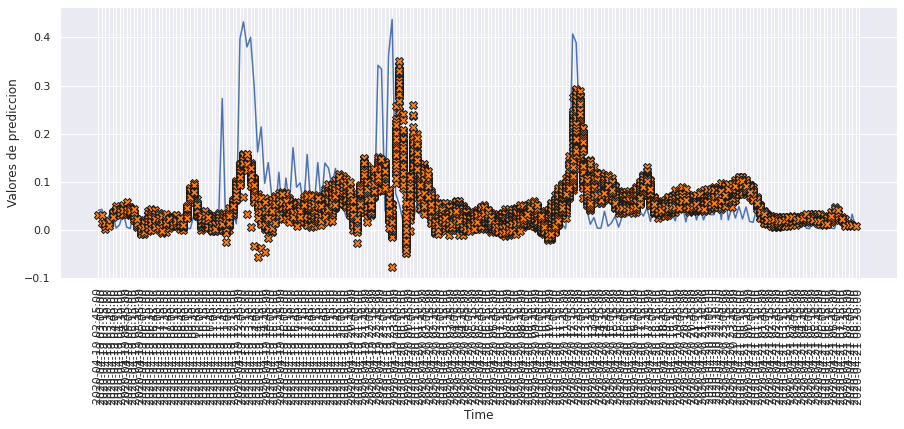

In [57]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict2, 120)

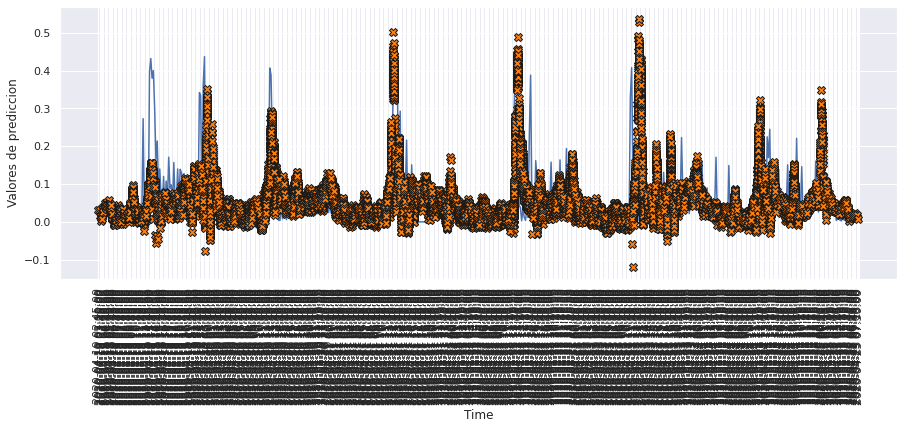

In [58]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict2, 500)

# MODELO 3: LSTM DE 3 CAPAS

### Construimos el modelo

In [59]:
def build_model3():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.LSTM(64, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [60]:
model3 = build_model3()
model3.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 288, 128)          69632     
                                                                 
 lstm_4 (LSTM)               (None, 288, 128)          131584    
                                                                 
 lstm_5 (LSTM)               (None, 64)                49408     
                                                                 
 dense_2 (Dense)             (None, 96)                6240      
                                                                 
Total params: 256,864
Trainable params: 256,864
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [61]:
history3 = model3.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 34s 90ms/step - loss: 0.0062 - mae: 0.0472 - mse: 0.0062 - smape: 0.8493 - val_loss: 0.0066 - val_mae: 0.0483 - val_mse: 0.0066 - val_smape: 0.8928
Epoch 2/200
351/351 [==============================] - 30s 85ms/step - loss: 0.0057 - mae: 0.0450 - mse: 0.0057 - smape: 0.8034 - val_loss: 0.0066 - val_mae: 0.0472 - val_mse: 0.0066 - val_smape: 0.8613
Epoch 3/200
351/351 [==============================] - 30s 84ms/step - loss: 0.0055 - mae: 0.0438 - mse: 0.0055 - smape: 0.7832 - val_loss: 0.0067 - val_mae: 0.0471 - val_mse: 0.0067 - val_smape: 0.8333
Epoch 4/200
351/351 [==============================] - 30s 85ms/step - loss: 0.0054 - mae: 0.0431 - mse: 0.0054 - smape: 0.7751 - val_loss: 0.0068 - val_mae: 0.0472 - val_mse: 0.0068 - val_smape: 0.8283
Epoch 5/200
351/351 [==============================] - 30s 85ms/step - loss: 0.0053 - mae: 0.0425 - mse: 0.0053 - smape: 0.7668 - val_loss: 0.0074 - val_mae: 0.0486 - val_mse: 0.0074 - val

351/351 [==============================] - 31s 88ms/step - loss: 0.0012 - mae: 0.0235 - mse: 0.0012 - smape: 0.6512 - val_loss: 0.0097 - val_mae: 0.0524 - val_mse: 0.0097 - val_smape: 0.9169
Epoch 82/200
351/351 [==============================] - 31s 87ms/step - loss: 0.0012 - mae: 0.0235 - mse: 0.0012 - smape: 0.6502 - val_loss: 0.0097 - val_mae: 0.0524 - val_mse: 0.0097 - val_smape: 0.9136
Epoch 83/200
351/351 [==============================] - 31s 89ms/step - loss: 0.0012 - mae: 0.0233 - mse: 0.0012 - smape: 0.6486 - val_loss: 0.0096 - val_mae: 0.0525 - val_mse: 0.0096 - val_smape: 0.9219
Epoch 84/200
351/351 [==============================] - 31s 88ms/step - loss: 0.0012 - mae: 0.0232 - mse: 0.0012 - smape: 0.6475 - val_loss: 0.0097 - val_mae: 0.0525 - val_mse: 0.0097 - val_smape: 0.9133
Epoch 85/200
351/351 [==============================] - 31s 88ms/step - loss: 0.0012 - mae: 0.0232 - mse: 0.0012 - smape: 0.6477 - val_loss: 0.0095 - val_mae: 0.0521 - val_mse: 0.0095 - val_smape: 

In [62]:
hist3 = pd.DataFrame(history3.history)
hist3['epoch'] = history3.epoch
hist3

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006212,0.047161,0.006212,0.849314,0.006639,0.048259,0.006639,0.892775,0
1,0.005691,0.044958,0.005691,0.803394,0.006640,0.047238,0.006640,0.861323,1
2,0.005496,0.043781,0.005496,0.783152,0.006731,0.047054,0.006731,0.833342,2
3,0.005379,0.043142,0.005379,0.775067,0.006846,0.047151,0.006846,0.828334,3
4,0.005256,0.042509,0.005256,0.766765,0.007352,0.048623,0.007352,0.855050,4
...,...,...,...,...,...,...,...,...,...
96,0.001122,0.022561,0.001122,0.639106,0.009645,0.052443,0.009645,0.920653,96
97,0.001108,0.022444,0.001108,0.637441,0.009613,0.052418,0.009613,0.918420,97
98,0.001104,0.022390,0.001104,0.636733,0.009540,0.052185,0.009540,0.927644,98
99,0.001106,0.022397,0.001106,0.636708,0.009497,0.051770,0.009497,0.915589,99


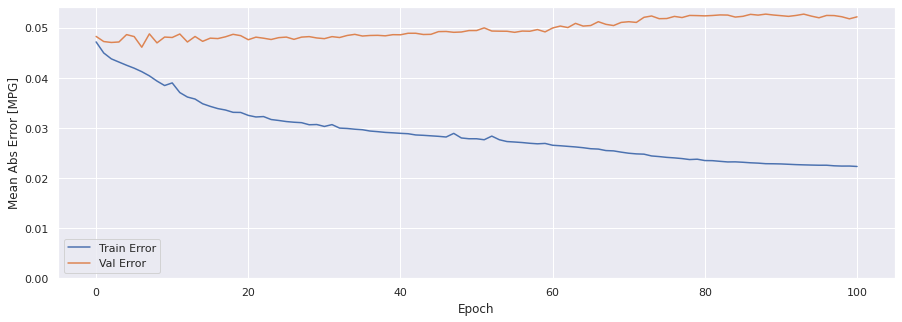

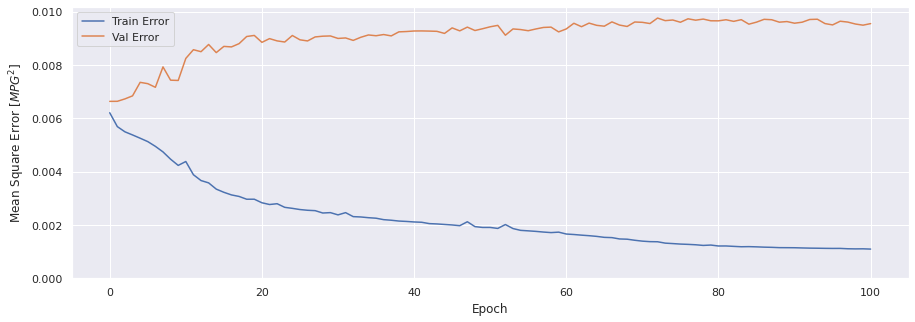

In [63]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history3)

### Evaluar predicciones

In [64]:
score_train3 = model3.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train3[0]}')
print(f'MAE:{score_train3[1]}')
print(f'MSE:{score_train3[2]}')
print(f'SMAPE:{score_train3[3]}')

1401/1401 [==============================] - 48s 33ms/step - loss: 0.0011 - mae: 0.0222 - mse: 0.0011 - smape: 0.6246
Loss:0.0010962564265355468
MAE:0.022245878353714943
MSE:0.0010962564265355468
SMAPE:0.6245874166488647


In [65]:
score_val3 = model3.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val3[0]}')
print(f'MAE:{score_val3[1]}')
print(f'MSE:{score_val3[2]}')
print(f'SMAPE:{score_val3[3]}')

291/291 [==============================] - 10s 34ms/step - loss: 0.0096 - mae: 0.0522 - mse: 0.0096 - smape: 0.9113
Loss:0.009555811062455177
MAE:0.05216299742460251
MSE:0.009555811062455177
SMAPE:0.9112669229507446


In [66]:
score_test3 = model3.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test3[0]}')
print(f'MAE:{score_test3[1]}')
print(f'MSE:{score_test3[2]}')
print(f'SMAPE:{score_test3[3]}')

291/291 [==============================] - 10s 34ms/step - loss: 0.0081 - mae: 0.0529 - mse: 0.0081 - smape: 0.9264
Loss:0.008085718378424644
MAE:0.052901286631822586
MSE:0.008085718378424644
SMAPE:0.9264171719551086


### Comparativa de resultados

In [67]:
result = hist3.iloc[-1]
comparativa3 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test3[1], score_test3[2], score_test3[3], math.sqrt(score_test3[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa3.style.set_caption("Método de ventana de varios pasos - LSTM de tres capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.022312,0.001096,0.635936,0.033105
VALIDACION,0.052163,0.009556,0.911494,0.097754
TEST,0.052901,0.008086,0.926417,0.089921


### Obtener predicciones

In [68]:
trainPredict3 = model3.predict(scaled_trainX)
testPredict3 = model3.predict(scaled_testX)

### Visualización de las predicciones

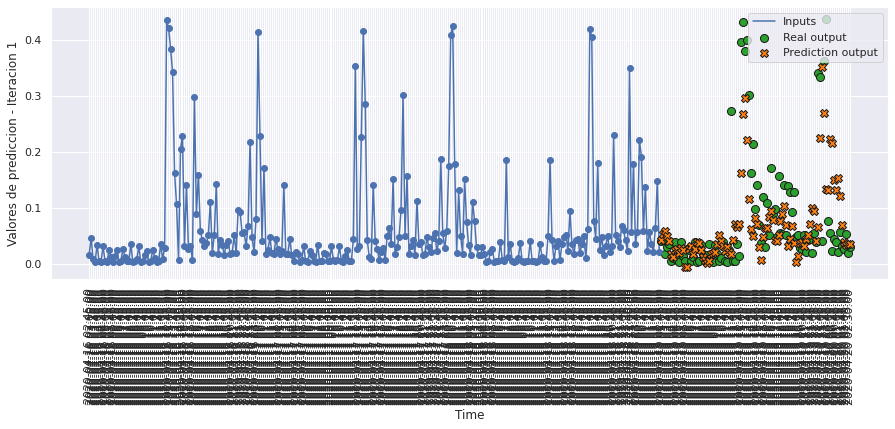

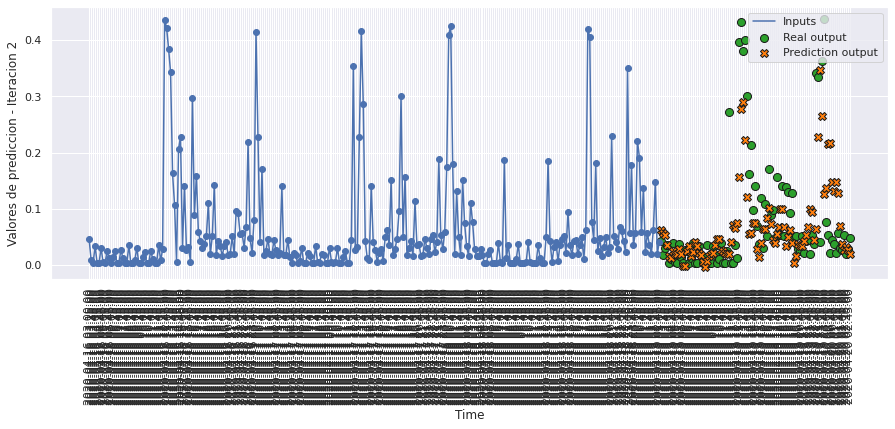

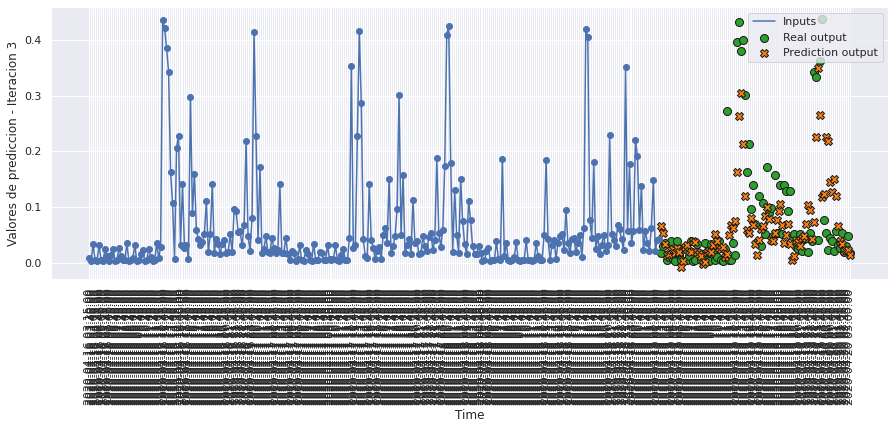

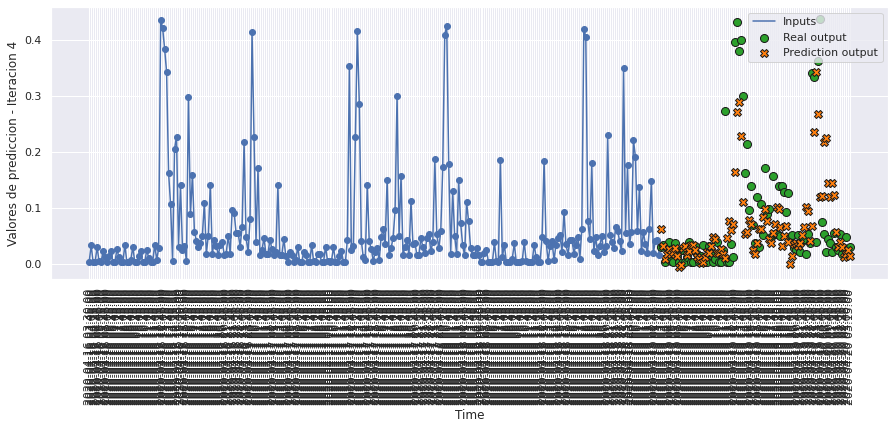

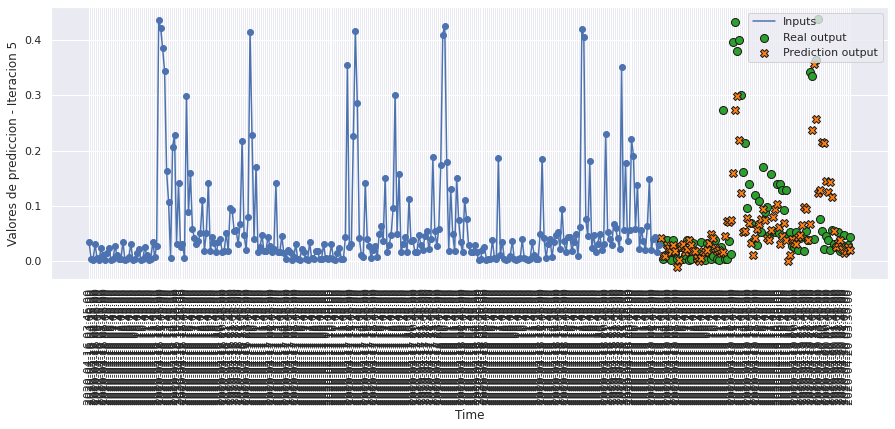

...

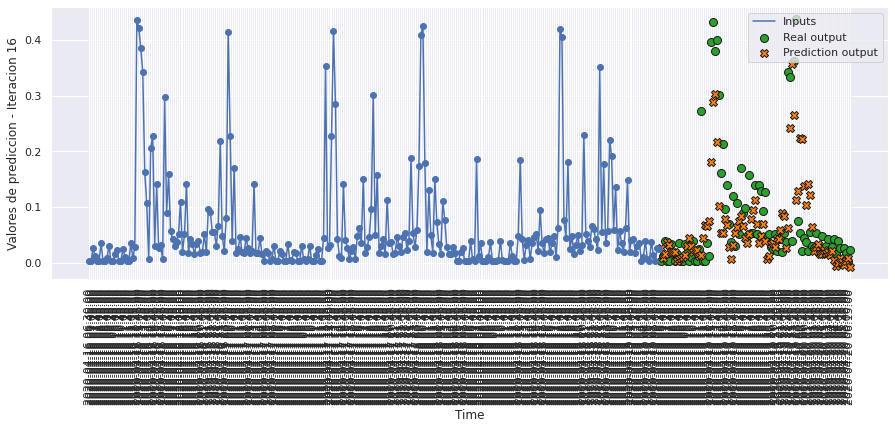

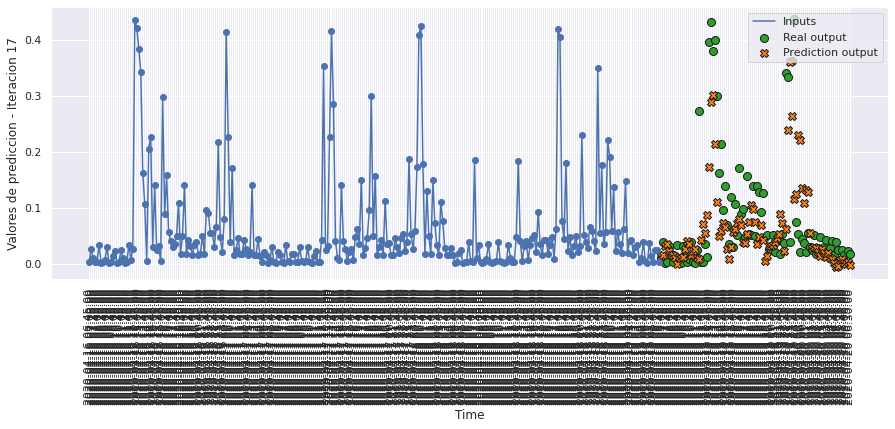

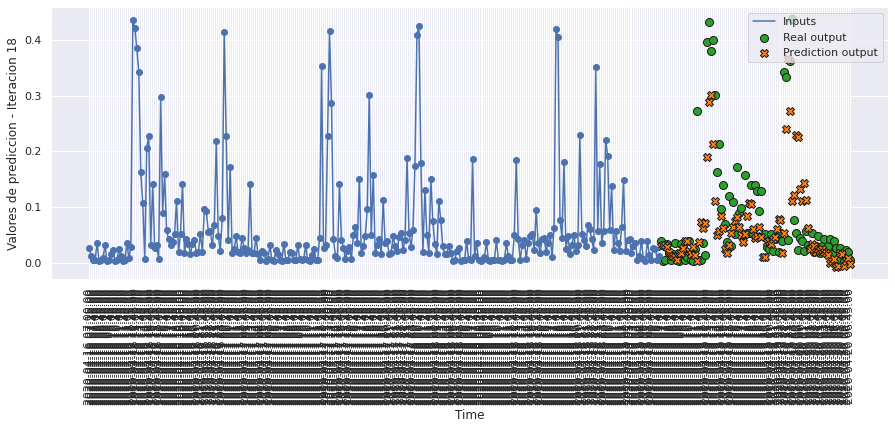

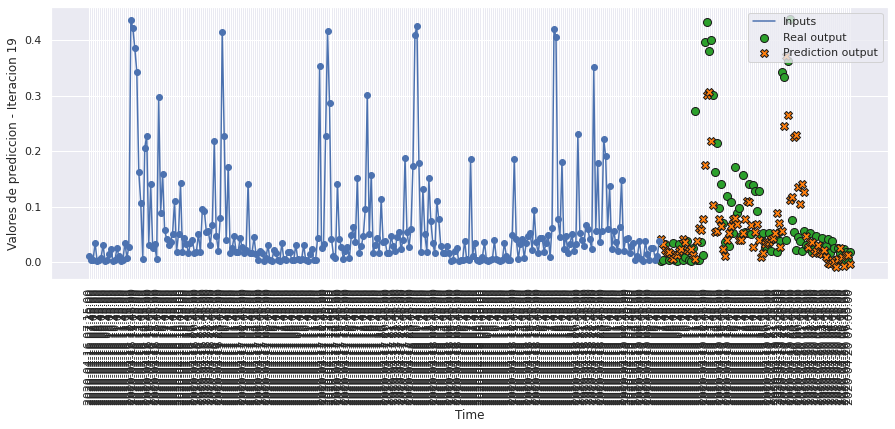

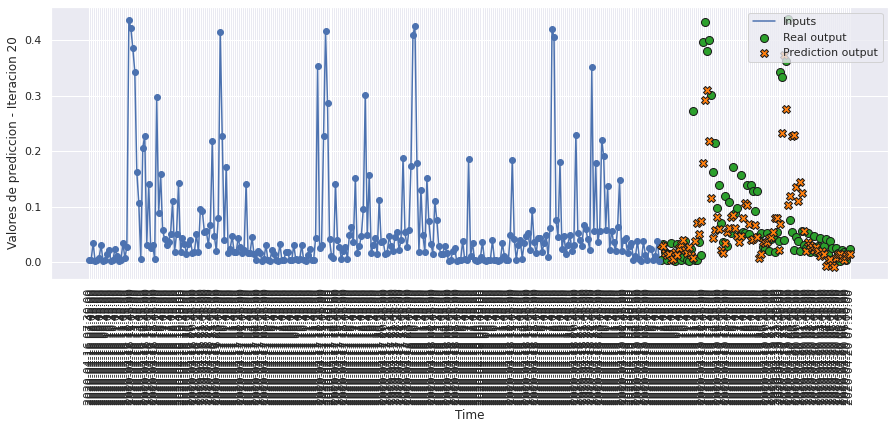

In [69]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict3, 20, 0)

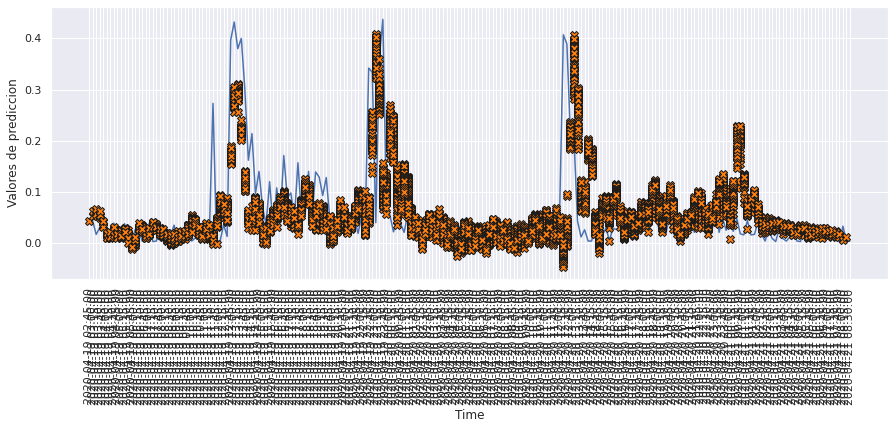

In [70]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict3, 120)

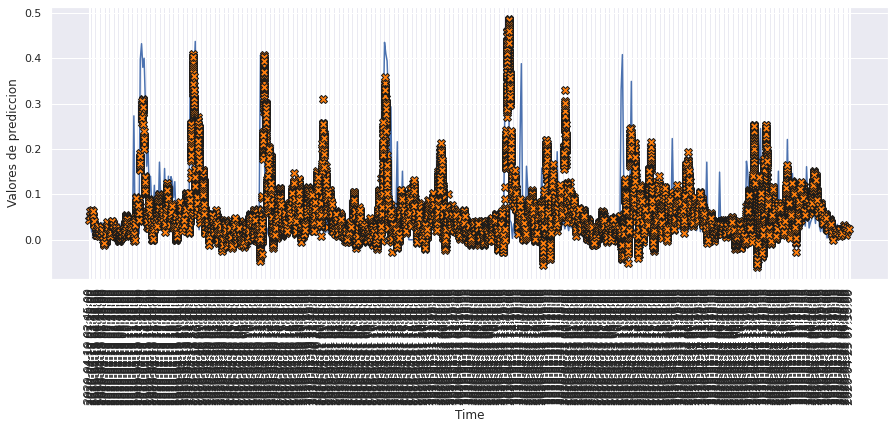

In [71]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict3, 500)

# MODELO 4: LSTM BIDIRECCIONAL

### Construimos el modelo

In [72]:
def build_model4():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, activation='tanh')),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [73]:
model4 = build_model4()
model4.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirectiona  (None, 256)              139264    
 l)                                                              
                                                                 
 dense_3 (Dense)             (None, 96)                24672     
                                                                 
Total params: 163,936
Trainable params: 163,936
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [74]:
history4 = model4.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 24s 64ms/step - loss: 0.0064 - mae: 0.0485 - mse: 0.0064 - smape: 0.8746 - val_loss: 0.0066 - val_mae: 0.0490 - val_mse: 0.0066 - val_smape: 0.9310
Epoch 2/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0059 - mae: 0.0461 - mse: 0.0059 - smape: 0.8269 - val_loss: 0.0066 - val_mae: 0.0483 - val_mse: 0.0066 - val_smape: 0.8943
Epoch 3/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0057 - mae: 0.0451 - mse: 0.0057 - smape: 0.8080 - val_loss: 0.0068 - val_mae: 0.0484 - val_mse: 0.0068 - val_smape: 0.8923
Epoch 4/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0055 - mae: 0.0442 - mse: 0.0055 - smape: 0.7930 - val_loss: 0.0067 - val_mae: 0.0470 - val_mse: 0.0067 - val_smape: 0.8503
Epoch 5/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0055 - mae: 0.0437 - mse: 0.0055 - smape: 0.7860 - val_loss: 0.0068 - val_mae: 0.0476 - val_mse: 0.0068 - val

351/351 [==============================] - 22s 62ms/step - loss: 0.0024 - mae: 0.0313 - mse: 0.0024 - smape: 0.7227 - val_loss: 0.0088 - val_mae: 0.0495 - val_mse: 0.0088 - val_smape: 0.8773
Epoch 82/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0024 - mae: 0.0313 - mse: 0.0024 - smape: 0.7219 - val_loss: 0.0086 - val_mae: 0.0486 - val_mse: 0.0086 - val_smape: 0.8683
Epoch 83/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0024 - mae: 0.0312 - mse: 0.0024 - smape: 0.7210 - val_loss: 0.0089 - val_mae: 0.0499 - val_mse: 0.0089 - val_smape: 0.8764
Epoch 84/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0024 - mae: 0.0313 - mse: 0.0024 - smape: 0.7217 - val_loss: 0.0088 - val_mae: 0.0494 - val_mse: 0.0088 - val_smape: 0.8777
Epoch 85/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0024 - mae: 0.0311 - mse: 0.0024 - smape: 0.7205 - val_loss: 0.0090 - val_mae: 0.0497 - val_mse: 0.0090 - val_smape: 

In [75]:
hist4 = pd.DataFrame(history4.history)
hist4['epoch'] = history4.epoch
hist4

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006429,0.048529,0.006429,0.874573,0.006646,0.048980,0.006646,0.930977,0
1,0.005906,0.046142,0.005906,0.826857,0.006631,0.048345,0.006631,0.894308,1
2,0.005686,0.045064,0.005686,0.808042,0.006774,0.048367,0.006774,0.892262,2
3,0.005550,0.044152,0.005550,0.792954,0.006705,0.046952,0.006705,0.850250,3
4,0.005486,0.043729,0.005486,0.786023,0.006788,0.047561,0.006788,0.842943,4
...,...,...,...,...,...,...,...,...,...
97,0.002256,0.030422,0.002256,0.714574,0.008882,0.049744,0.008882,0.883500,97
98,0.002251,0.030386,0.002251,0.713997,0.008903,0.049575,0.008903,0.873044,98
99,0.002273,0.030506,0.002273,0.715392,0.009107,0.050530,0.009107,0.890274,99
100,0.002235,0.030304,0.002235,0.713435,0.009137,0.050474,0.009137,0.886967,100


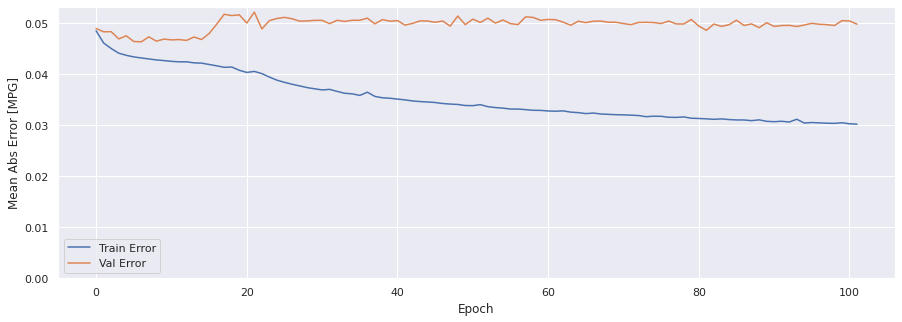

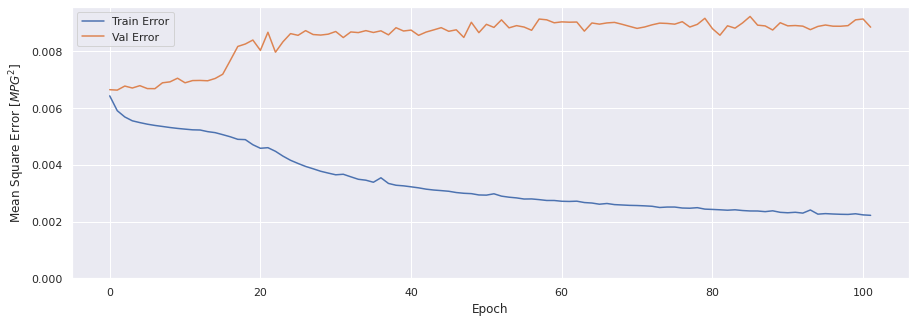

In [76]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history4)

### Evaluar predicciones

In [77]:
score_train4 = model4.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train4[0]}')
print(f'MAE:{score_train4[1]}')
print(f'MSE:{score_train4[2]}')
print(f'SMAPE:{score_train4[3]}')

1401/1401 [==============================] - 35s 25ms/step - loss: 0.0022 - mae: 0.0302 - mse: 0.0022 - smape: 0.7104
Loss:0.002219602931290865
MAE:0.030160466209053993
MSE:0.002219602931290865
SMAPE:0.7103968262672424


In [78]:
score_val4 = model4.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val4[0]}')
print(f'MAE:{score_val4[1]}')
print(f'MSE:{score_val4[2]}')
print(f'SMAPE:{score_val4[3]}')

291/291 [==============================] - 7s 25ms/step - loss: 0.0088 - mae: 0.0498 - mse: 0.0088 - smape: 0.8785
Loss:0.00884928647428751
MAE:0.049835868179798126
MSE:0.00884928647428751
SMAPE:0.8785391449928284


In [79]:
score_test4 = model4.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test4[0]}')
print(f'MAE:{score_test4[1]}')
print(f'MSE:{score_test4[2]}')
print(f'SMAPE:{score_test4[3]}')

291/291 [==============================] - 7s 25ms/step - loss: 0.0076 - mae: 0.0497 - mse: 0.0076 - smape: 0.8466
Loss:0.0075713396072387695
MAE:0.049657586961984634
MSE:0.0075713396072387695
SMAPE:0.8466474413871765


### Comparativa de resultados

In [80]:
result = hist4.iloc[-1]
comparativa4 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test4[1], score_test4[2], score_test4[3], math.sqrt(score_test4[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa4.style.set_caption("Método de ventana de varios pasos - Bidireccional LSTM")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.030220,0.002219,0.713059,0.047103
VALIDACION,0.049836,0.008849,0.878882,0.094071
TEST,0.049658,0.007571,0.846647,0.087013


### Obtener predicciones

In [81]:
trainPredict4 = model4.predict(scaled_trainX)
testPredict4 = model4.predict(scaled_testX)

### Visualización de las predicciones

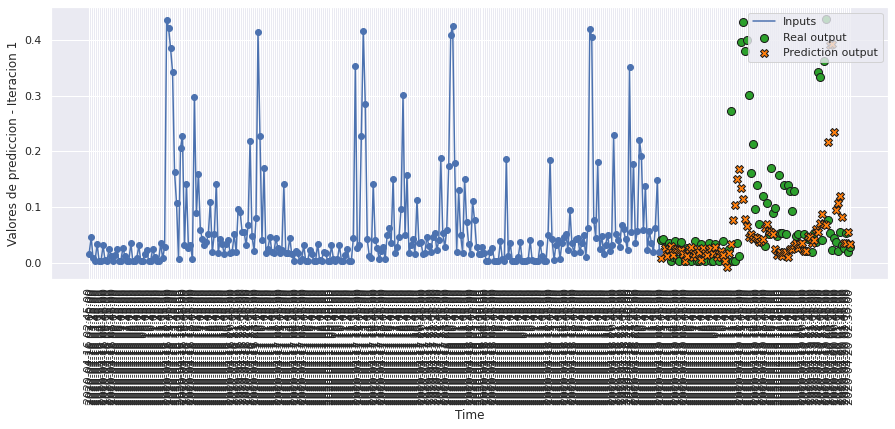

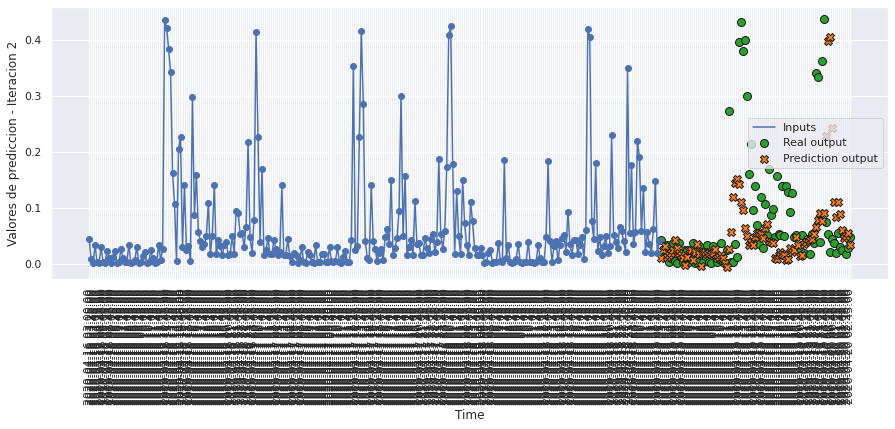

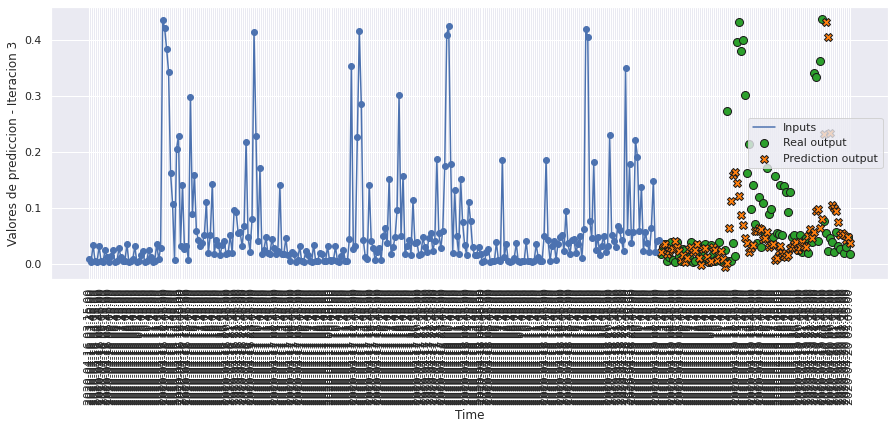

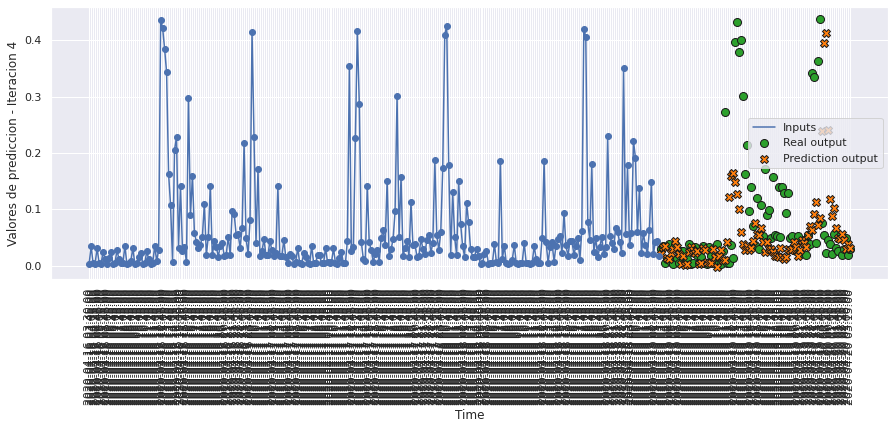

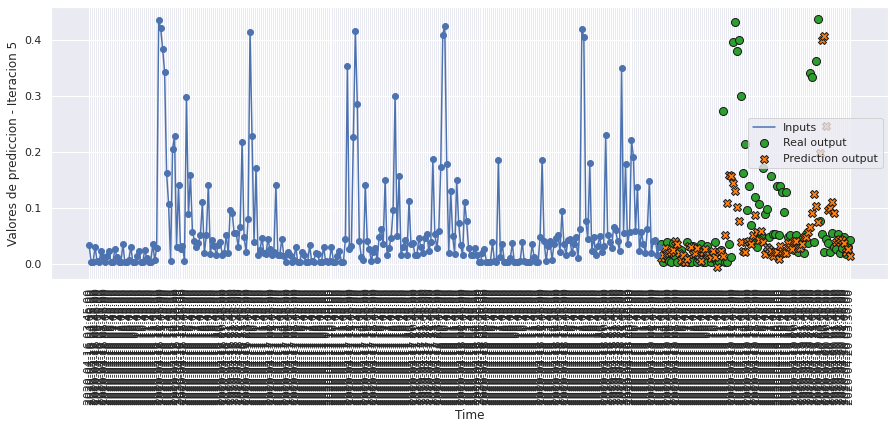

...

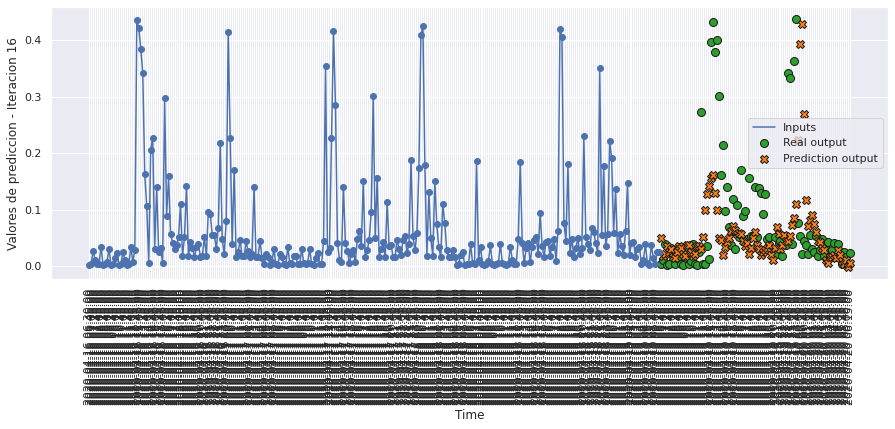

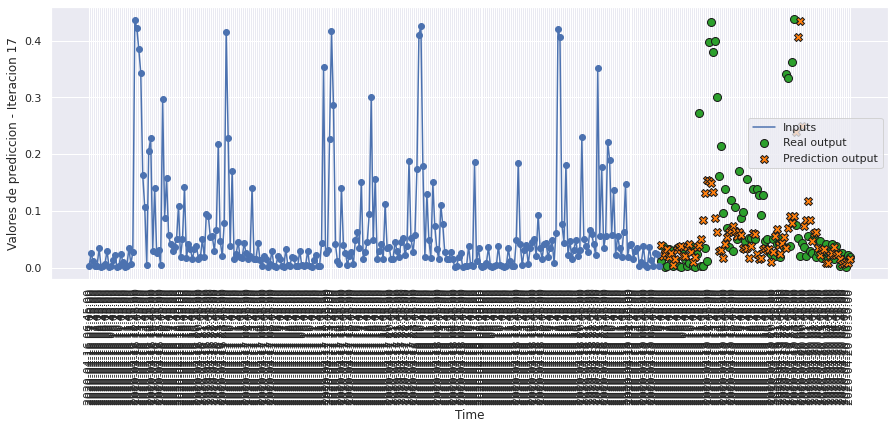

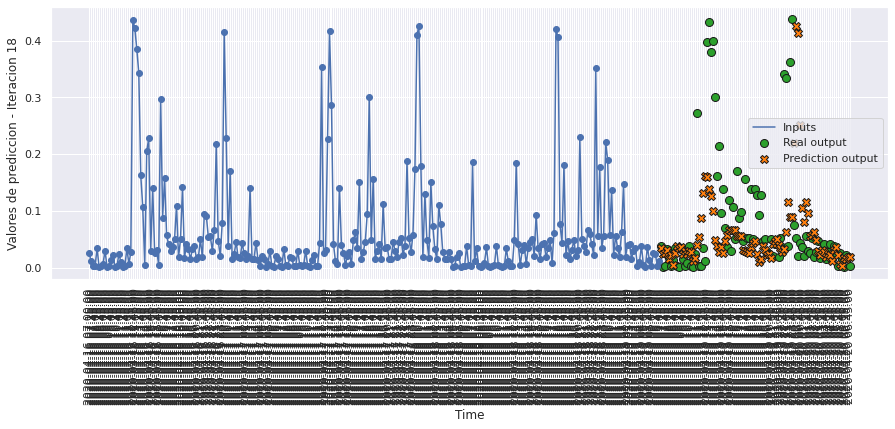

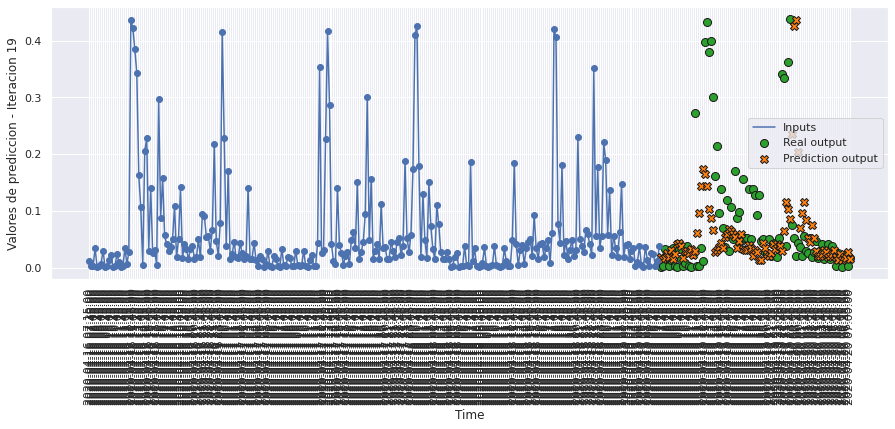

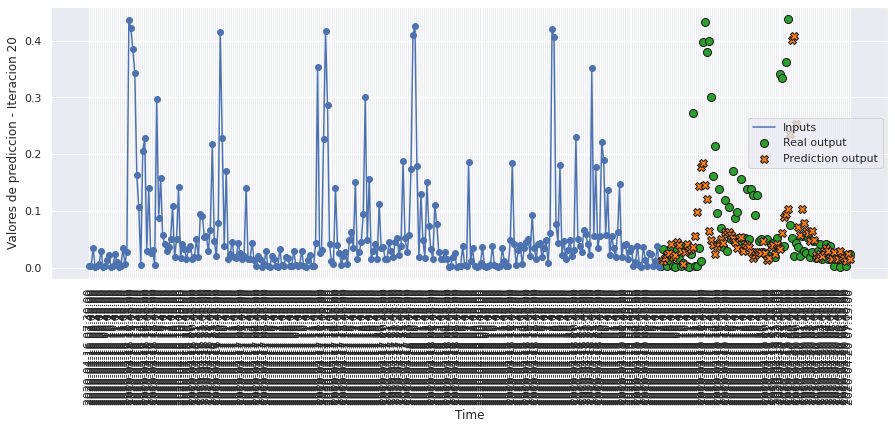

In [82]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict4, 20, 0)

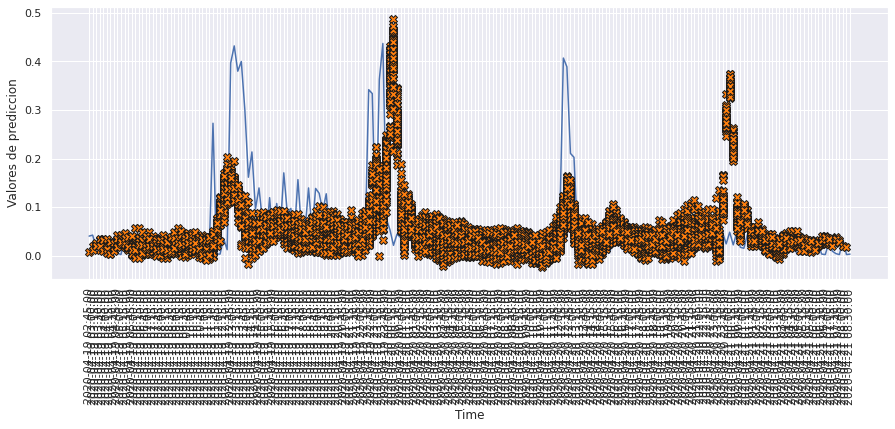

In [83]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict4, 120)

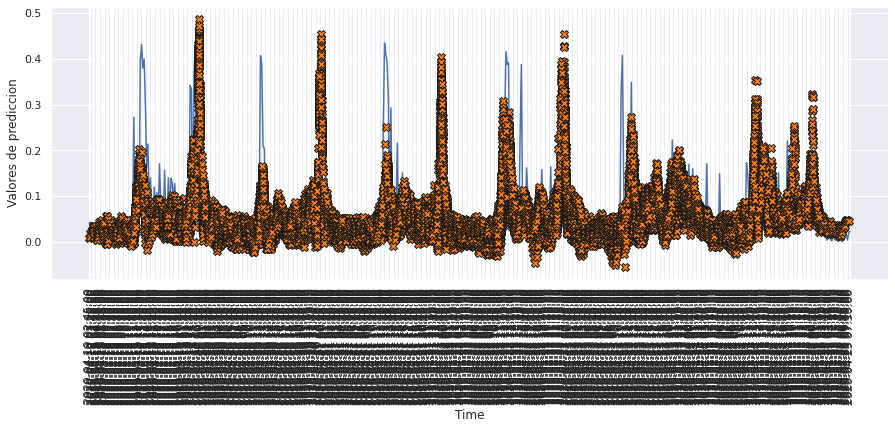

In [84]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict4, 500)

# MODELO 5: CONVOLUCIONAL 1D

### Construimos el modelo

In [85]:
def build_model5():
    model = tf.keras.Sequential([
        tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(filters=64, kernel_size=1, activation='relu'), 
                                        input_shape=(None, n_entrada, n_features)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPooling1D(pool_size=2)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Flatten()),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [86]:
model5 = build_model5()
model5.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, None, 288, 64)    512       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, None, 144, 64)    0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, None, 9216)       0         
 tributed)                                                       
                                                                 
 dense_4 (Dense)             (None, None, 96)          884832    
                                                                 
Total params: 885,344
Trainable params: 885,344
Non-trainable params: 0
________________________________________________

### Entrenamiento del modelo

In [87]:
history5 = model5.fit(scaled_trainX_4D, data_trainY_3D, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_4D, data_valY_3D), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 4s 9ms/step - loss: 0.0130 - mae: 0.0699 - mse: 0.0130 - smape: 1.0762 - val_loss: 0.0084 - val_mae: 0.0604 - val_mse: 0.0084 - val_smape: 1.0926
Epoch 2/200
351/351 [==============================] - 3s 10ms/step - loss: 0.0069 - mae: 0.0550 - mse: 0.0069 - smape: 1.0069 - val_loss: 0.0078 - val_mae: 0.0574 - val_mse: 0.0078 - val_smape: 1.0567
Epoch 3/200
351/351 [==============================] - 3s 8ms/step - loss: 0.0063 - mae: 0.0516 - mse: 0.0063 - smape: 0.9648 - val_loss: 0.0073 - val_mae: 0.0549 - val_mse: 0.0073 - val_smape: 1.0335
Epoch 4/200
351/351 [==============================] - 3s 8ms/step - loss: 0.0059 - mae: 0.0483 - mse: 0.0059 - smape: 0.9102 - val_loss: 0.0069 - val_mae: 0.0507 - val_mse: 0.0069 - val_smape: 0.9644
Epoch 5/200
351/351 [==============================] - 3s 8ms/step - loss: 0.0056 - mae: 0.0459 - mse: 0.0056 - smape: 0.8591 - val_loss: 0.0066 - val_mae: 0.0493 - val_mse: 0.0066 - val_smape: 0

Epoch 82/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0038 - mae: 0.0416 - mse: 0.0038 - smape: 0.8913 - val_loss: 0.0086 - val_mae: 0.0591 - val_mse: 0.0086 - val_smape: 1.1321
Epoch 83/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0038 - mae: 0.0416 - mse: 0.0038 - smape: 0.8919 - val_loss: 0.0087 - val_mae: 0.0595 - val_mse: 0.0087 - val_smape: 1.1274
Epoch 84/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0038 - mae: 0.0416 - mse: 0.0038 - smape: 0.8919 - val_loss: 0.0087 - val_mae: 0.0596 - val_mse: 0.0087 - val_smape: 1.1329
Epoch 85/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0038 - mae: 0.0416 - mse: 0.0038 - smape: 0.8922 - val_loss: 0.0086 - val_mae: 0.0597 - val_mse: 0.0086 - val_smape: 1.1321
Epoch 86/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0038 - mae: 0.0416 - mse: 0.0038 - smape: 0.8921 - val_loss: 0.0087 - val_mae: 0.0598 - val_mse: 0.0087 - val_smap

In [88]:
hist5 = pd.DataFrame(history5.history)
hist5['epoch'] = history5.epoch
hist5

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.013035,0.069928,0.013035,1.076205,0.008387,0.060439,0.008387,1.092593,0
1,0.006888,0.054966,0.006888,1.006868,0.007765,0.057398,0.007765,1.056701,1
2,0.006335,0.051620,0.006335,0.964797,0.007268,0.054852,0.007268,1.033545,2
3,0.005891,0.048335,0.005891,0.910191,0.006851,0.050664,0.006851,0.964443,3
4,0.005616,0.045930,0.005616,0.859058,0.006648,0.049295,0.006648,0.916074,4
...,...,...,...,...,...,...,...,...,...
103,0.003789,0.041561,0.003789,0.894900,0.008742,0.059656,0.008742,1.132959,103
104,0.003786,0.041527,0.003786,0.894711,0.008693,0.059797,0.008693,1.122920,104
105,0.003785,0.041539,0.003785,0.894958,0.008870,0.060964,0.008870,1.142920,105
106,0.003781,0.041514,0.003781,0.894619,0.008836,0.060533,0.008836,1.144725,106


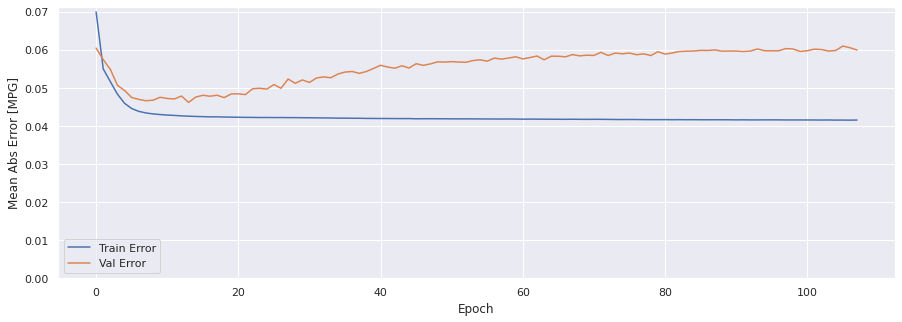

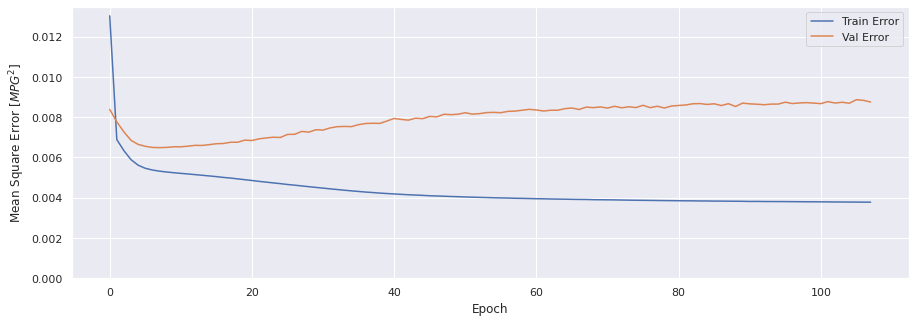

In [89]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history5)

### Evaluar predicciones

In [90]:
score_train5 = model5.evaluate(scaled_trainX_4D, data_trainY_3D, verbose=1)
print(f'Loss:{score_train5[0]}')
print(f'MAE:{score_train5[1]}')
print(f'MSE:{score_train5[2]}')
print(f'SMAPE:{score_train5[3]}')

1401/1401 [==============================] - 7s 5ms/step - loss: 0.0037 - mae: 0.0404 - mse: 0.0037 - smape: 0.8865
Loss:0.003672104561701417
MAE:0.04040723666548729
MSE:0.003672104561701417
SMAPE:0.886493444442749


In [91]:
score_val5 = model5.evaluate(scaled_valX_4D, data_valY_3D, verbose=1)
print(f'Loss:{score_val5[0]}')
print(f'MAE:{score_val5[1]}')
print(f'MSE:{score_val5[2]}')
print(f'SMAPE:{score_val5[3]}')

291/291 [==============================] - 1s 5ms/step - loss: 0.0088 - mae: 0.0599 - mse: 0.0088 - smape: 1.1446
Loss:0.008753972128033638
MAE:0.059935715049505234
MSE:0.008753972128033638
SMAPE:1.1445603370666504


In [92]:
score_test5 = model5.evaluate(scaled_testX_4D, data_testY_3D, verbose=1)
print(f'Loss:{score_test5[0]}')
print(f'MAE:{score_test5[1]}')
print(f'MSE:{score_test5[2]}')
print(f'SMAPE:{score_test5[3]}')

291/291 [==============================] - 1s 5ms/step - loss: 0.0074 - mae: 0.0562 - mse: 0.0074 - smape: 1.0710
Loss:0.00742680998519063
MAE:0.056191474199295044
MSE:0.00742680998519063
SMAPE:1.0709871053695679


### Comparativa de resultados

In [93]:
result = hist5.iloc[-1]
comparativa5 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test5[1], score_test5[2], score_test5[3], math.sqrt(score_test5[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa5.style.set_caption("Método de ventana de varios pasos - Convolucional 1D")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.041545,0.003781,0.895469,0.061493
VALIDACION,0.059936,0.008754,1.144906,0.093563
TEST,0.056191,0.007427,1.070987,0.086179


### Obtener predicciones

In [94]:
trainPredict5 = model5.predict(scaled_trainX_4D)
testPredict5 = model5.predict(scaled_testX_4D)

### Visualización de las predicciones

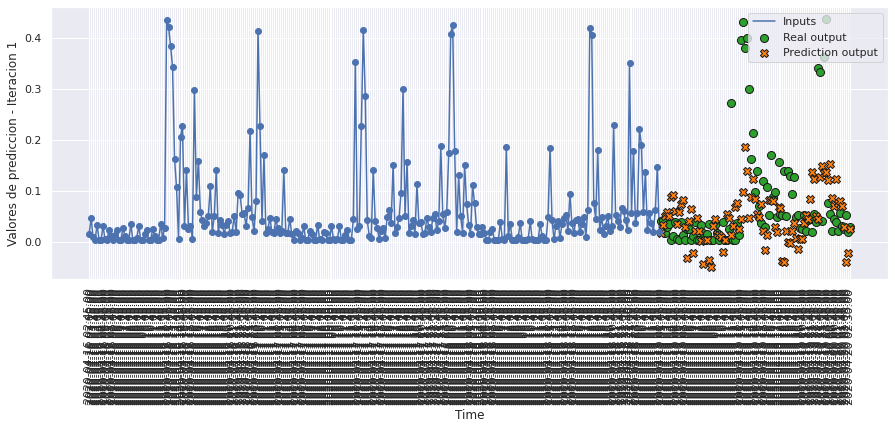

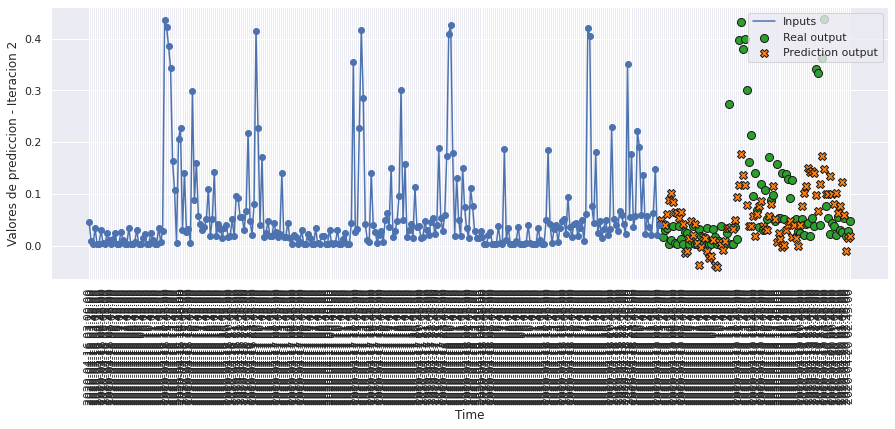

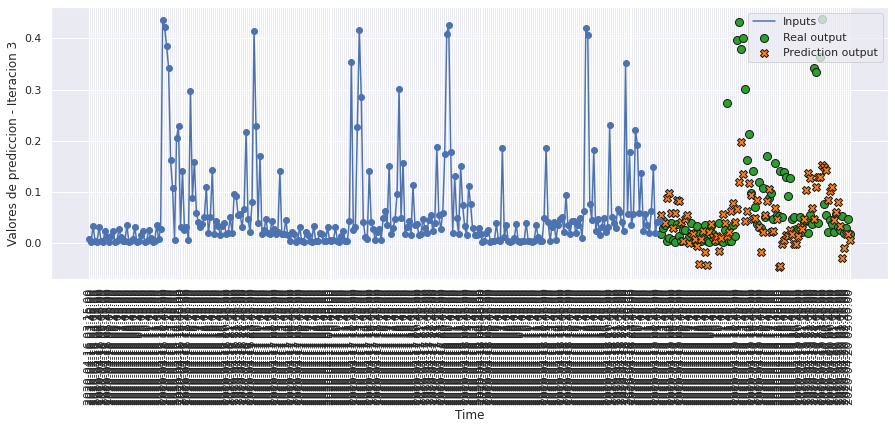

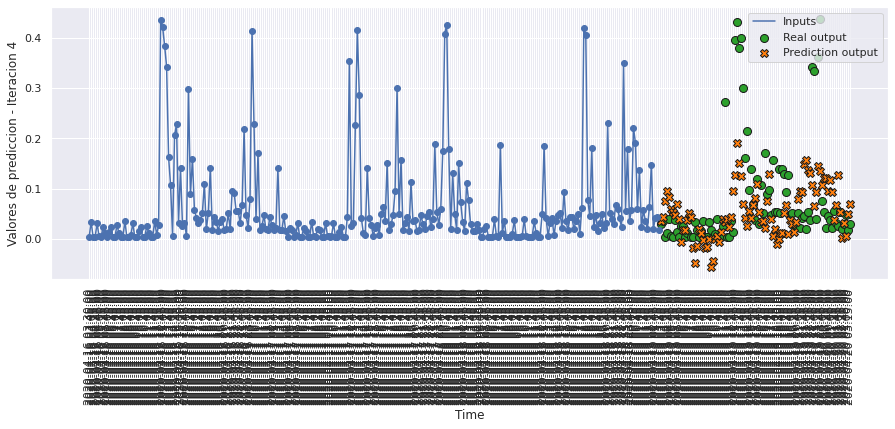

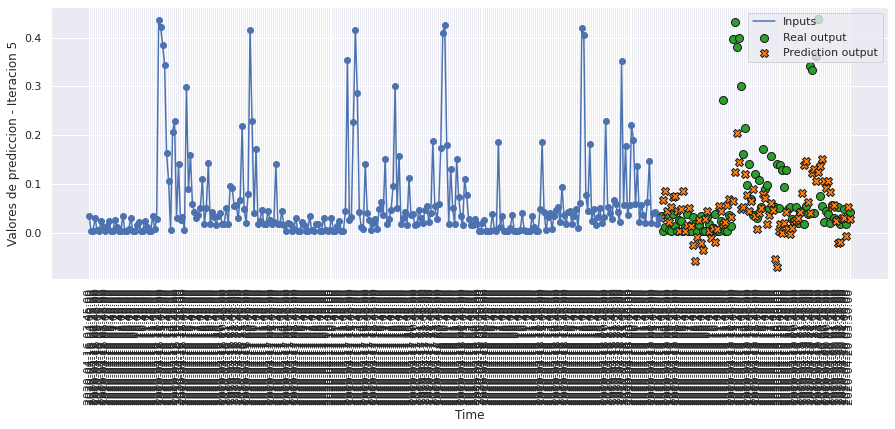

...

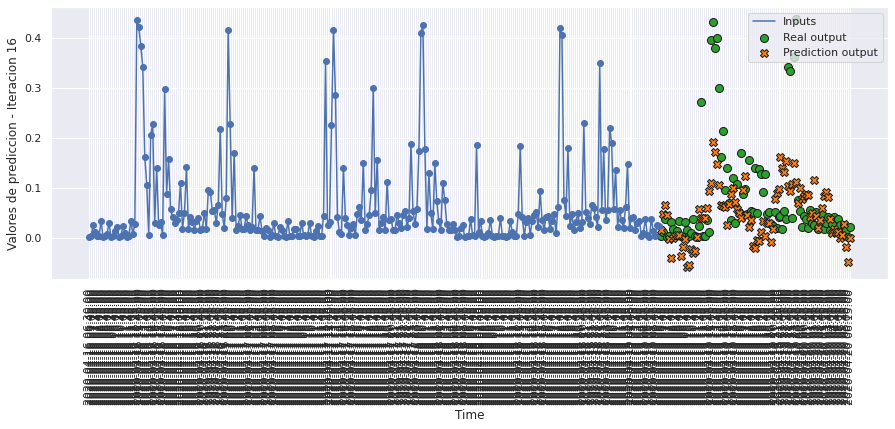

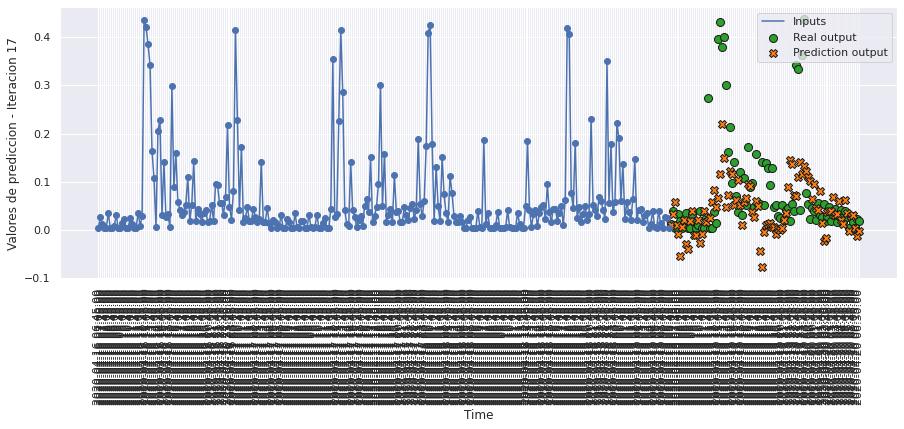

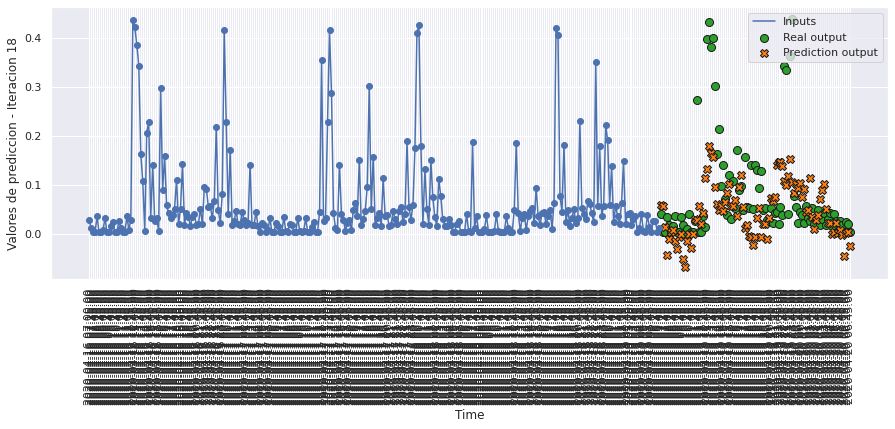

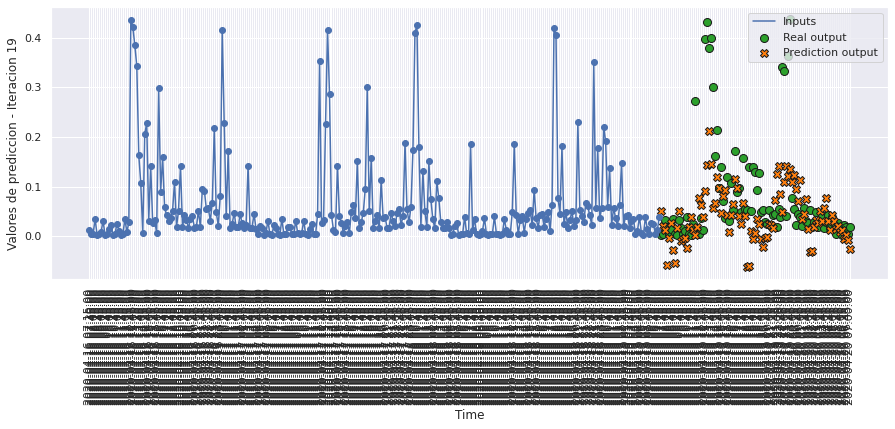

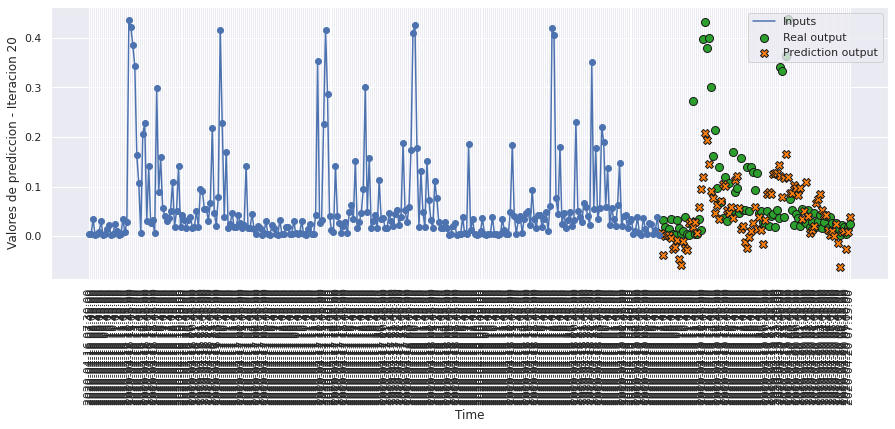

In [95]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, 
                        testPredict5.reshape(testPredict5.shape[0],n_predicciones), 20, 0)

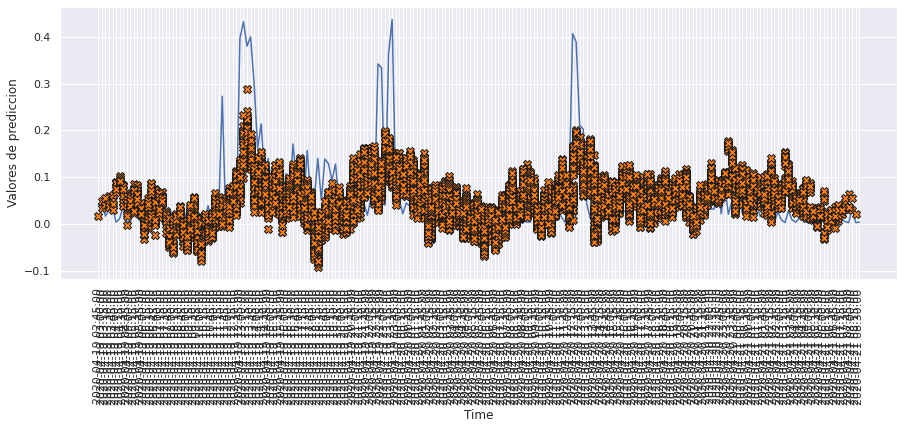

In [96]:
plot_window_predictions_values(int(test_df.iloc[0].name), 
                               testPredict5.reshape(testPredict5.shape[0],n_predicciones), 120)

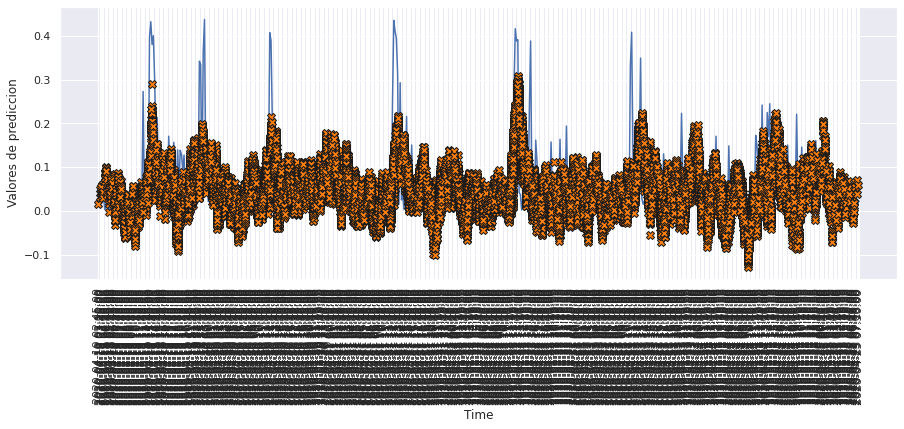

In [97]:
plot_window_predictions_values(int(test_df.iloc[0].name), 
                               testPredict5.reshape(testPredict5.shape[0],n_predicciones), 500)

# MODELO 6: CONVOLUCIONAL 1D CON LSTM 

### Construimos el modelo

In [98]:
def build_model6():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(None, n_entrada, n_features)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(filters=64, kernel_size=1, activation='relu')), 
        tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPooling1D(pool_size=2)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Flatten()),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [99]:
model6 = build_model6()
model6.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_3 (TimeDis  (None, None, 288, 64)    512       
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, None, 144, 64)    0         
 tributed)                                                       
                                                                 
 time_distributed_5 (TimeDis  (None, None, 9216)       0         
 tributed)                                                       
                                                                 
 lstm_7 (LSTM)               (None, None, 128)         4784640   
                                                                 
 dense_5 (Dense)             (None, None, 96)          12384     
                                                      

### Entrenamiento del modelo

In [100]:
history6 = model6.fit(scaled_trainX_4D, data_trainY_3D, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_4D, data_valY_3D), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 5s 12ms/step - loss: 0.0065 - mae: 0.0477 - mse: 0.0065 - smape: 0.8586 - val_loss: 0.0066 - val_mae: 0.0477 - val_mse: 0.0066 - val_smape: 0.8926
Epoch 2/200
351/351 [==============================] - 4s 10ms/step - loss: 0.0057 - mae: 0.0452 - mse: 0.0057 - smape: 0.8073 - val_loss: 0.0067 - val_mae: 0.0486 - val_mse: 0.0067 - val_smape: 0.8822
Epoch 3/200
351/351 [==============================] - 4s 10ms/step - loss: 0.0055 - mae: 0.0441 - mse: 0.0055 - smape: 0.7891 - val_loss: 0.0065 - val_mae: 0.0465 - val_mse: 0.0065 - val_smape: 0.8561
Epoch 4/200
351/351 [==============================] - 4s 10ms/step - loss: 0.0054 - mae: 0.0432 - mse: 0.0054 - smape: 0.7776 - val_loss: 0.0065 - val_mae: 0.0459 - val_mse: 0.0065 - val_smape: 0.8412
Epoch 5/200
351/351 [==============================] - 4s 10ms/step - loss: 0.0053 - mae: 0.0427 - mse: 0.0053 - smape: 0.7726 - val_loss: 0.0066 - val_mae: 0.0470 - val_mse: 0.0066 - val_smap

351/351 [==============================] - 3s 9ms/step - loss: 0.0021 - mae: 0.0303 - mse: 0.0021 - smape: 0.7379 - val_loss: 0.0109 - val_mae: 0.0649 - val_mse: 0.0109 - val_smape: 1.1068
Epoch 82/200
351/351 [==============================] - 3s 9ms/step - loss: 0.0021 - mae: 0.0302 - mse: 0.0021 - smape: 0.7372 - val_loss: 0.0108 - val_mae: 0.0645 - val_mse: 0.0108 - val_smape: 1.1064
Epoch 83/200
351/351 [==============================] - 3s 9ms/step - loss: 0.0021 - mae: 0.0302 - mse: 0.0021 - smape: 0.7362 - val_loss: 0.0109 - val_mae: 0.0652 - val_mse: 0.0109 - val_smape: 1.1066
Epoch 84/200
351/351 [==============================] - 3s 9ms/step - loss: 0.0021 - mae: 0.0301 - mse: 0.0021 - smape: 0.7358 - val_loss: 0.0109 - val_mae: 0.0651 - val_mse: 0.0109 - val_smape: 1.1054
Epoch 85/200
351/351 [==============================] - 3s 9ms/step - loss: 0.0021 - mae: 0.0300 - mse: 0.0021 - smape: 0.7346 - val_loss: 0.0107 - val_mae: 0.0643 - val_mse: 0.0107 - val_smape: 1.1003
Epo

In [101]:
hist6 = pd.DataFrame(history6.history)
hist6['epoch'] = history6.epoch
hist6

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006469,0.047688,0.006469,0.858620,0.006640,0.047651,0.006640,0.892577,0
1,0.005736,0.045205,0.005736,0.807255,0.006655,0.048640,0.006655,0.882241,1
2,0.005520,0.044068,0.005520,0.789062,0.006522,0.046466,0.006522,0.856092,2
3,0.005363,0.043214,0.005363,0.777578,0.006524,0.045932,0.006524,0.841214,3
4,0.005252,0.042703,0.005252,0.772568,0.006626,0.046989,0.006626,0.852642,4
...,...,...,...,...,...,...,...,...,...
98,0.001938,0.029234,0.001938,0.725289,0.011122,0.065788,0.011122,1.111257,98
99,0.001929,0.029175,0.001929,0.724453,0.011040,0.065349,0.011040,1.106958,99
100,0.001922,0.029128,0.001922,0.723962,0.011093,0.065582,0.011093,1.108930,100
101,0.001915,0.029084,0.001915,0.723607,0.011087,0.065488,0.011087,1.108149,101


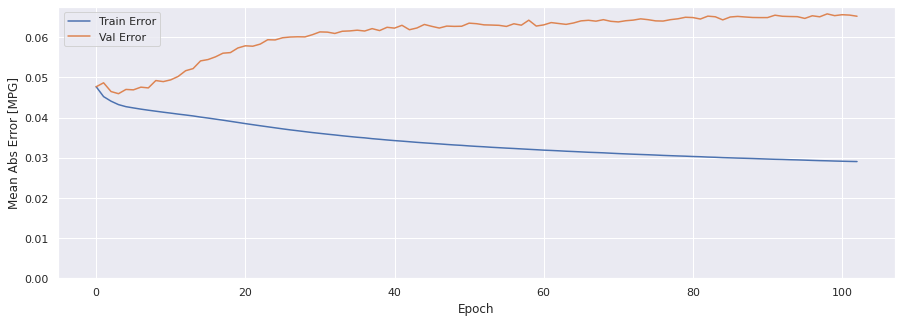

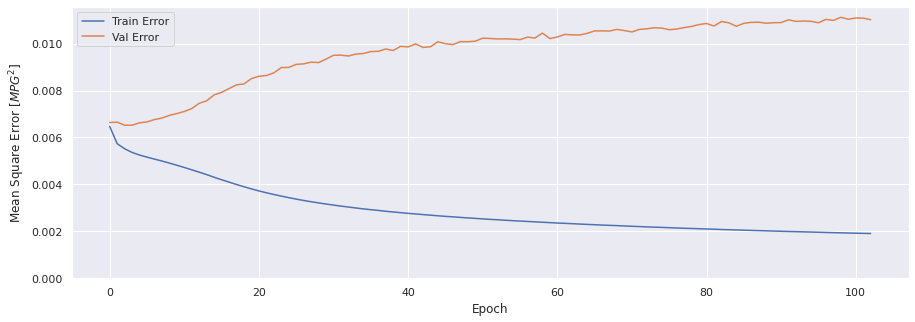

In [102]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history6)

### Evaluar predicciones

In [103]:
score_train6 = model6.evaluate(scaled_trainX_4D, data_trainY_3D, verbose=1)
print(f'Loss:{score_train6[0]}')
print(f'MAE:{score_train6[1]}')
print(f'MSE:{score_train6[2]}')
print(f'SMAPE:{score_train6[3]}')

1401/1401 [==============================] - 8s 6ms/step - loss: 0.0019 - mae: 0.0288 - mse: 0.0019 - smape: 0.7199
Loss:0.0018844181904569268
MAE:0.028809618204832077
MSE:0.0018844181904569268
SMAPE:0.7198543548583984


In [104]:
score_val6 = model6.evaluate(scaled_valX_4D, data_valY_3D, verbose=1)
print(f'Loss:{score_val6[0]}')
print(f'MAE:{score_val6[1]}')
print(f'MSE:{score_val6[2]}')
print(f'SMAPE:{score_val6[3]}')

291/291 [==============================] - 2s 5ms/step - loss: 0.0110 - mae: 0.0652 - mse: 0.0110 - smape: 1.1060
Loss:0.011021844111382961
MAE:0.06520406901836395
MSE:0.011021844111382961
SMAPE:1.1059807538986206


In [105]:
score_test6 = model6.evaluate(scaled_testX_4D, data_testY_3D, verbose=1)
print(f'Loss:{score_test6[0]}')
print(f'MAE:{score_test6[1]}')
print(f'MSE:{score_test6[2]}')
print(f'SMAPE:{score_test6[3]}')

291/291 [==============================] - 2s 5ms/step - loss: 0.0091 - mae: 0.0619 - mse: 0.0091 - smape: 1.0485
Loss:0.009105107747018337
MAE:0.06194498389959335
MSE:0.009105107747018337
SMAPE:1.0485228300094604


### Comparativa de resultados

In [106]:
result = hist6.iloc[-1]
comparativa6 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test6[1], score_test6[2], score_test6[3], math.sqrt(score_test6[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa6.style.set_caption("Método de ventana de varios pasos - Convolucional 1D con LSTM")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.029047,0.001910,0.723008,0.043698
VALIDACION,0.065204,0.011022,1.106115,0.104985
TEST,0.061945,0.009105,1.048523,0.095421


### Obtener predicciones

In [107]:
trainPredict6 = model6.predict(scaled_trainX_4D)
testPredict6 = model6.predict(scaled_testX_4D)

### Visualización de las predicciones

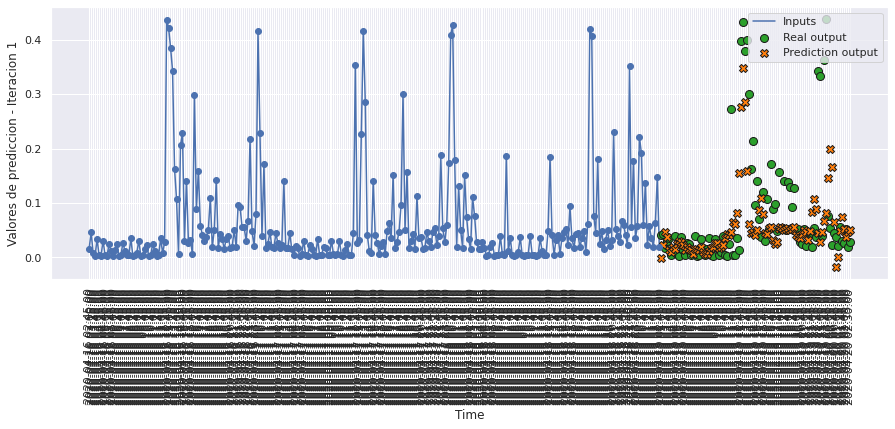

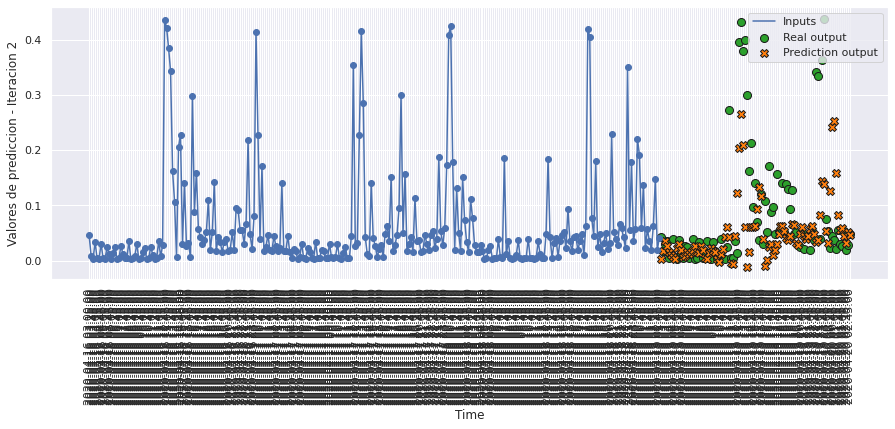

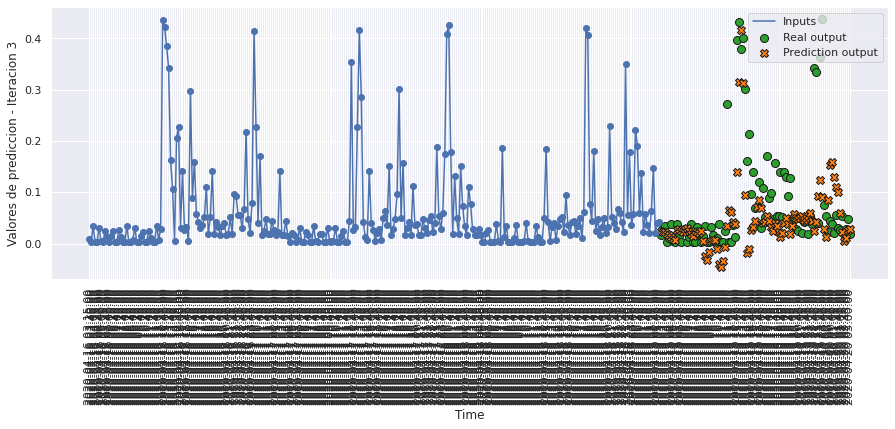

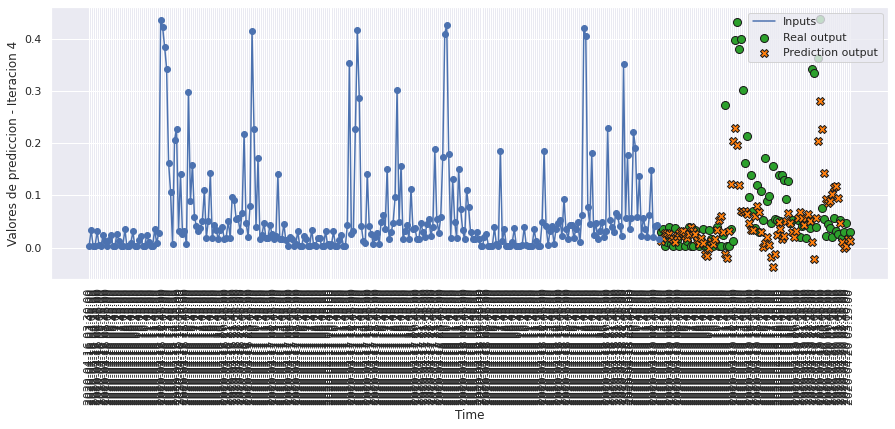

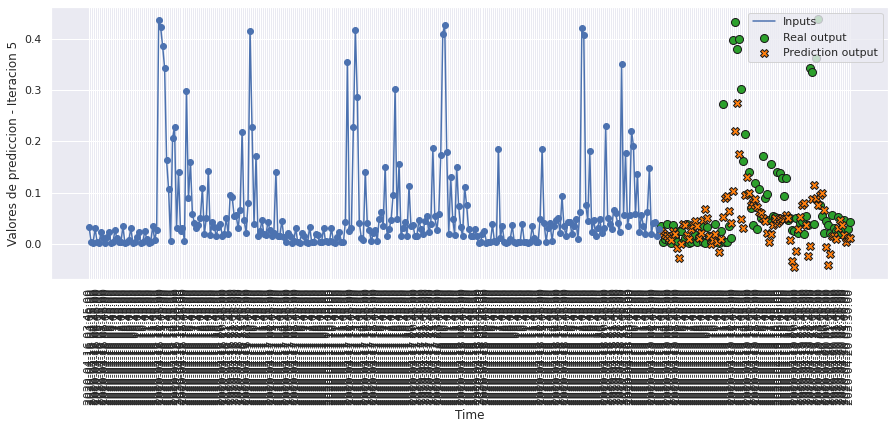

...

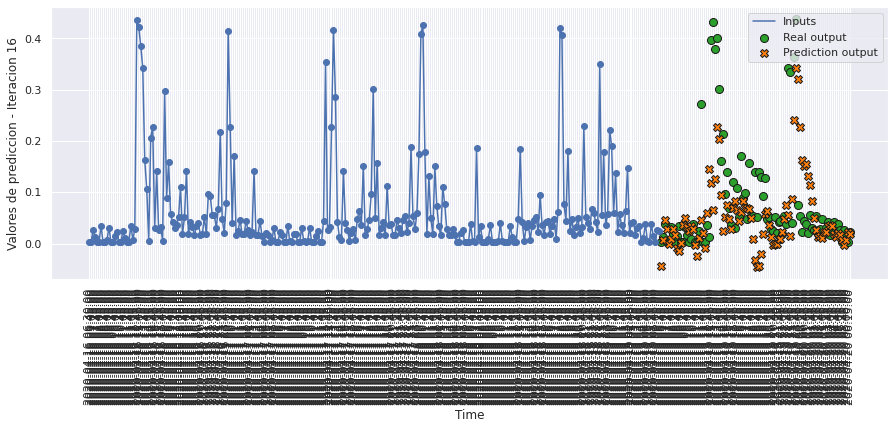

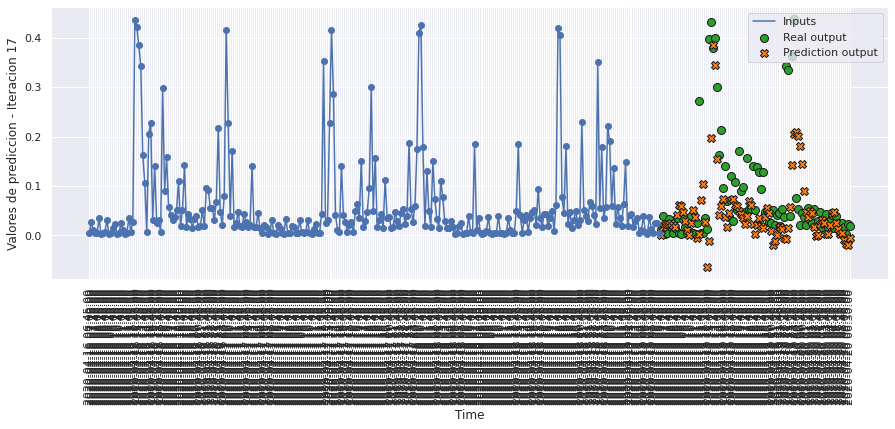

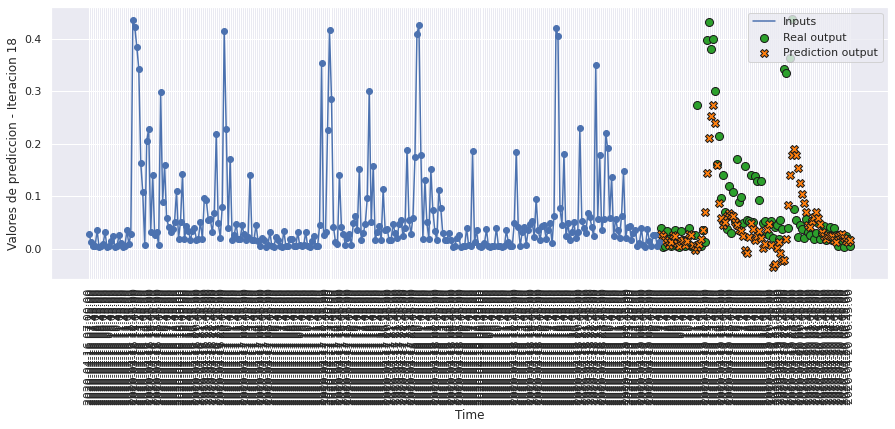

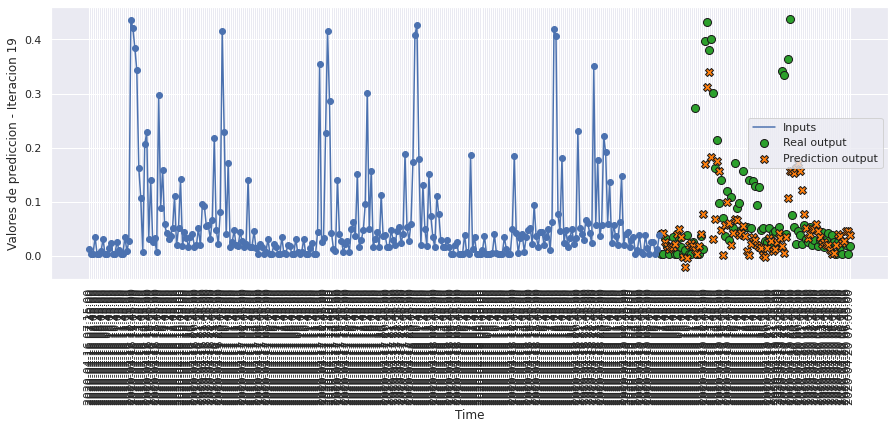

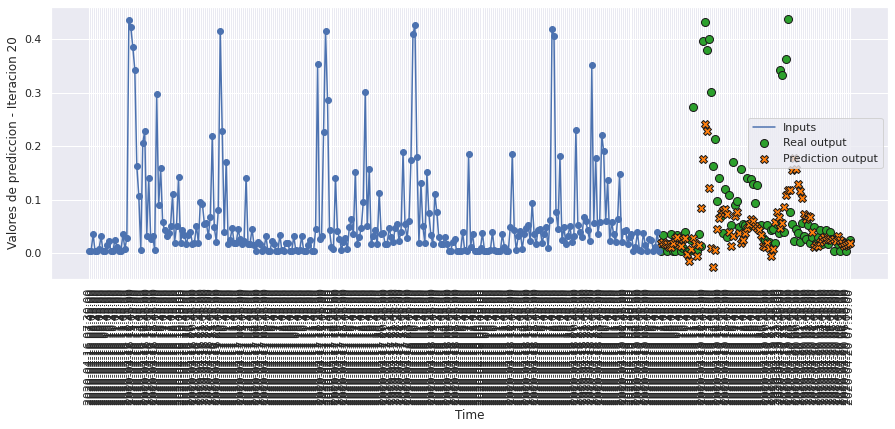

In [108]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, 
                        testPredict6.reshape(testPredict6.shape[0],n_predicciones), 20, 0)

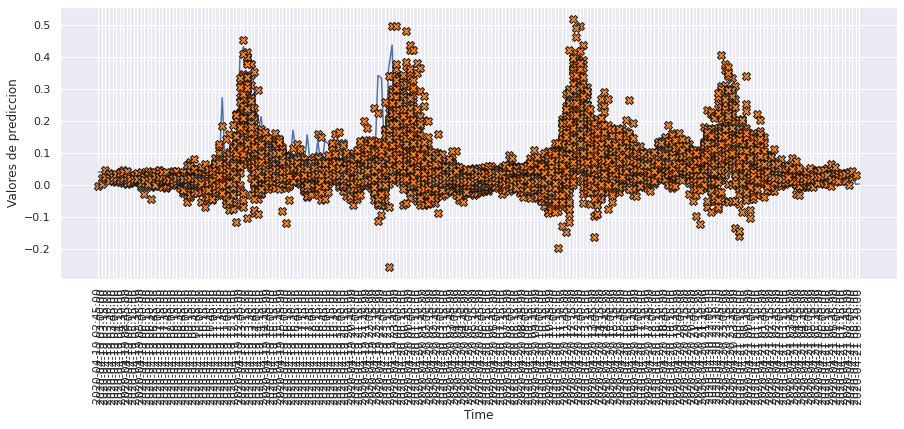

In [109]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict6.reshape(testPredict6.shape[0],n_predicciones), 120)

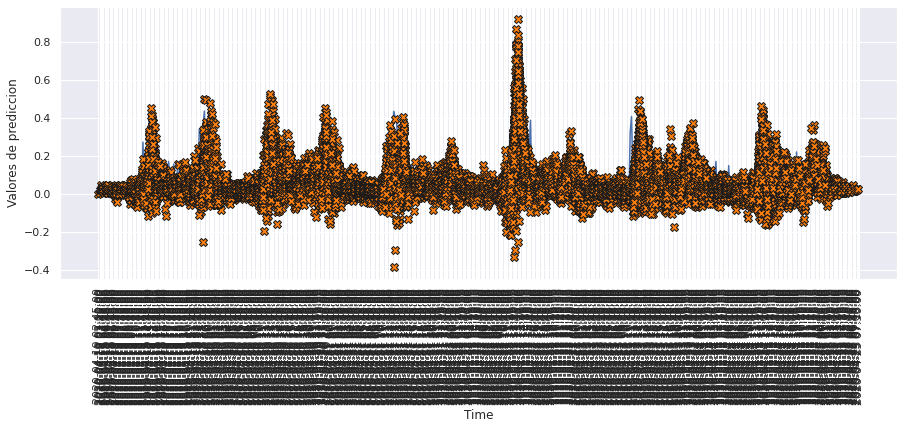

In [110]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict6.reshape(testPredict6.shape[0],n_predicciones), 500)

# MODELO 7: CONVLSTM1D

### Construimos el modelo

In [111]:
def build_model7():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(None, n_entrada, n_features)),
        tf.keras.layers.ConvLSTM1D(filters=64, kernel_size=1, activation='tanh'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones),
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [112]:
model7 = build_model7()
model7.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_lstm1d (ConvLSTM1D)    (None, 288, 64)           18432     
                                                                 
 flatten_2 (Flatten)         (None, 18432)             0         
                                                                 
 dense_6 (Dense)             (None, 96)                1769568   
                                                                 
Total params: 1,788,000
Trainable params: 1,788,000
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [113]:
history7 = model7.fit(scaled_trainX_4D, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_4D, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 10s 23ms/step - loss: 0.0066 - mae: 0.0511 - mse: 0.0066 - smape: 0.9273 - val_loss: 0.0065 - val_mae: 0.0468 - val_mse: 0.0065 - val_smape: 0.8539
Epoch 2/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0055 - mae: 0.0441 - mse: 0.0055 - smape: 0.8004 - val_loss: 0.0064 - val_mae: 0.0454 - val_mse: 0.0064 - val_smape: 0.8102
Epoch 3/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0054 - mae: 0.0434 - mse: 0.0054 - smape: 0.7802 - val_loss: 0.0064 - val_mae: 0.0444 - val_mse: 0.0064 - val_smape: 0.8240
Epoch 4/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0054 - mae: 0.0432 - mse: 0.0054 - smape: 0.7781 - val_loss: 0.0064 - val_mae: 0.0449 - val_mse: 0.0064 - val_smape: 0.8364
Epoch 5/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0054 - mae: 0.0431 - mse: 0.0054 - smape: 0.7783 - val_loss: 0.0064 - val_mae: 0.0458 - val_mse: 0.0064 - val_sma

351/351 [==============================] - 8s 22ms/step - loss: 0.0031 - mae: 0.0387 - mse: 0.0031 - smape: 0.8926 - val_loss: 0.0107 - val_mae: 0.0716 - val_mse: 0.0107 - val_smape: 1.2231
Epoch 82/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0031 - mae: 0.0387 - mse: 0.0031 - smape: 0.8927 - val_loss: 0.0108 - val_mae: 0.0719 - val_mse: 0.0108 - val_smape: 1.2158
Epoch 83/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0031 - mae: 0.0386 - mse: 0.0031 - smape: 0.8925 - val_loss: 0.0107 - val_mae: 0.0717 - val_mse: 0.0107 - val_smape: 1.2258
Epoch 84/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0030 - mae: 0.0386 - mse: 0.0030 - smape: 0.8930 - val_loss: 0.0107 - val_mae: 0.0718 - val_mse: 0.0107 - val_smape: 1.2235
Epoch 85/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0030 - mae: 0.0385 - mse: 0.0030 - smape: 0.8929 - val_loss: 0.0109 - val_mae: 0.0726 - val_mse: 0.0109 - val_smape: 1.222

In [114]:
hist7 = pd.DataFrame(history7.history)
hist7['epoch'] = history7.epoch
hist7

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006639,0.051126,0.006639,0.927334,0.006487,0.046801,0.006487,0.853892,0
1,0.005547,0.044148,0.005547,0.800381,0.006373,0.045351,0.006373,0.810158,1
2,0.005437,0.043374,0.005437,0.780239,0.006351,0.044378,0.006351,0.823997,2
3,0.005392,0.043201,0.005392,0.778133,0.006382,0.044899,0.006382,0.836418,3
4,0.005355,0.043089,0.005355,0.778314,0.006437,0.045831,0.006437,0.829767,4
...,...,...,...,...,...,...,...,...,...
98,0.002877,0.037970,0.002877,0.894489,0.011574,0.075784,0.011574,1.243996,98
99,0.002868,0.037951,0.002868,0.894996,0.011593,0.075792,0.011593,1.251376,99
100,0.002860,0.037912,0.002860,0.894520,0.011657,0.076096,0.011657,1.251999,100
101,0.002853,0.037889,0.002853,0.895154,0.011743,0.076306,0.011743,1.263224,101


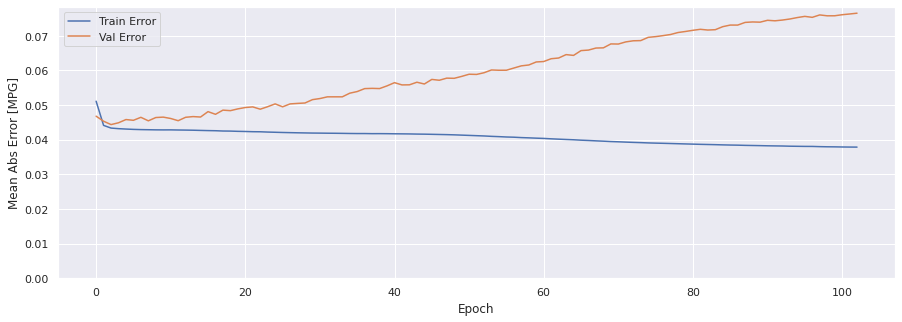

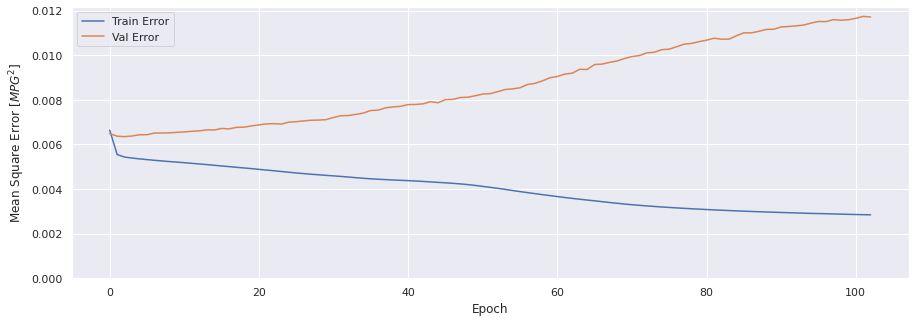

In [115]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history7)

### Evaluar predicciones

In [116]:
score_train7 = model7.evaluate(scaled_trainX_4D, data_trainY, verbose=1)
print(f'Loss:{score_train7[0]}')
print(f'MAE:{score_train7[1]}')
print(f'MSE:{score_train7[2]}')
print(f'SMAPE:{score_train7[3]}')

1401/1401 [==============================] - 10s 7ms/step - loss: 0.0027 - mae: 0.0365 - mse: 0.0027 - smape: 0.8828
Loss:0.0026597674004733562
MAE:0.03654887154698372
MSE:0.0026597674004733562
SMAPE:0.8828039765357971


In [117]:
score_val7 = model7.evaluate(scaled_valX_4D, data_valY, verbose=1)
print(f'Loss:{score_val7[0]}')
print(f'MAE:{score_val7[1]}')
print(f'MSE:{score_val7[2]}')
print(f'SMAPE:{score_val7[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0117 - mae: 0.0765 - mse: 0.0117 - smape: 1.2545
Loss:0.01171797700226307
MAE:0.0765376165509224
MSE:0.01171797700226307
SMAPE:1.254549264907837


In [118]:
score_test7 = model7.evaluate(scaled_testX_4D, data_testY, verbose=1)
print(f'Loss:{score_test7[0]}')
print(f'MAE:{score_test7[1]}')
print(f'MSE:{score_test7[2]}')
print(f'SMAPE:{score_test7[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0098 - mae: 0.0701 - mse: 0.0098 - smape: 1.1730
Loss:0.009766306728124619
MAE:0.07005378603935242
MSE:0.009766306728124619
SMAPE:1.1730374097824097


### Comparativa de resultados

In [119]:
result = hist7.iloc[-1]
comparativa7 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test7[1], score_test7[2], score_test7[3], math.sqrt(score_test7[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa7.style.set_caption("Método de ventana de varios pasos - CONVLSTM 1D")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.037875,0.002848,0.895227,0.053367
VALIDACION,0.076538,0.011718,1.255170,0.108250
TEST,0.070054,0.009766,1.173037,0.098825


### Obtener predicciones

In [120]:
trainPredict7 = model7.predict(scaled_trainX_4D)
testPredict7 = model7.predict(scaled_testX_4D)

### Visualización de las predicciones

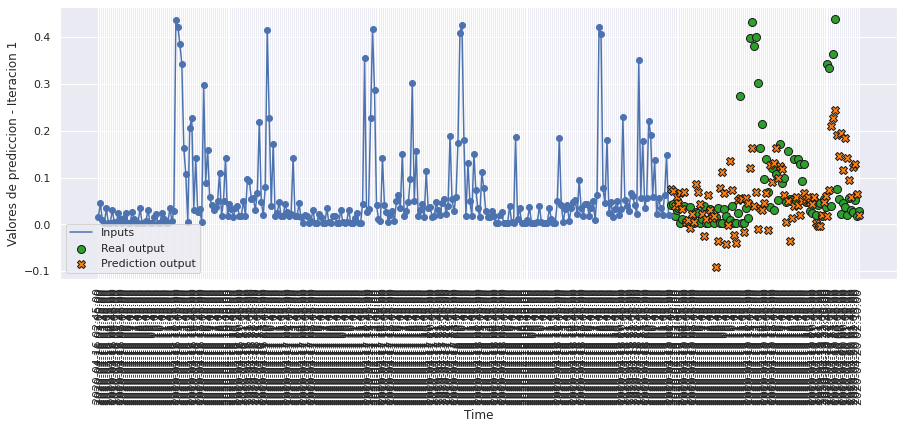

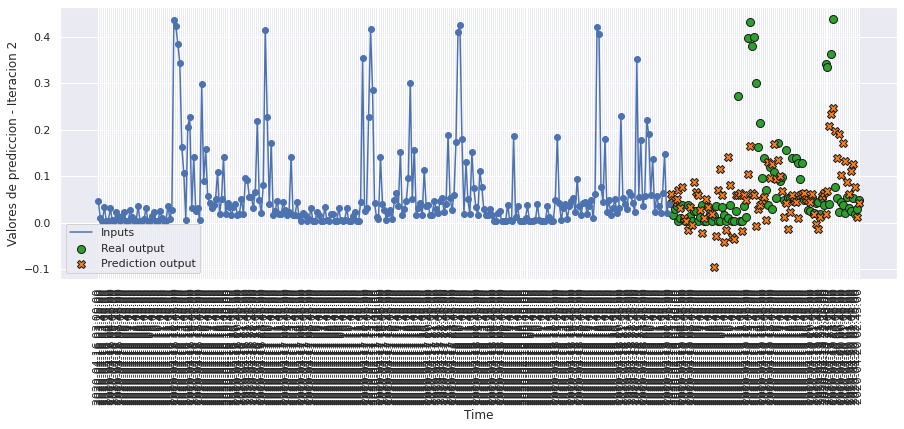

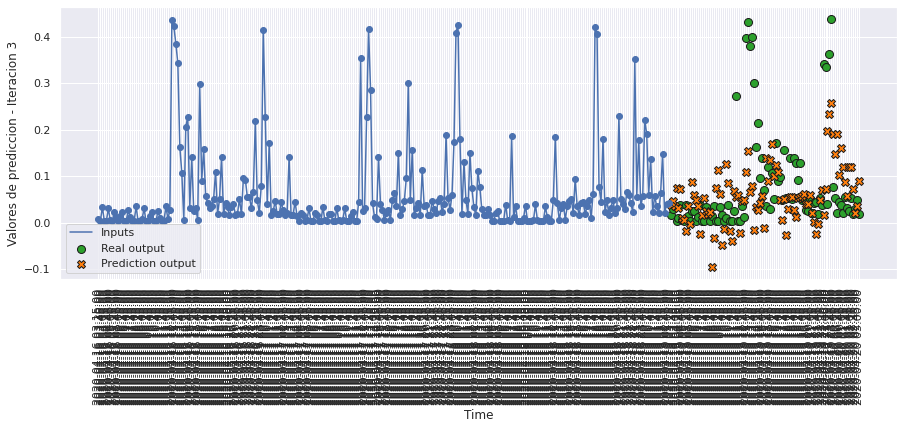

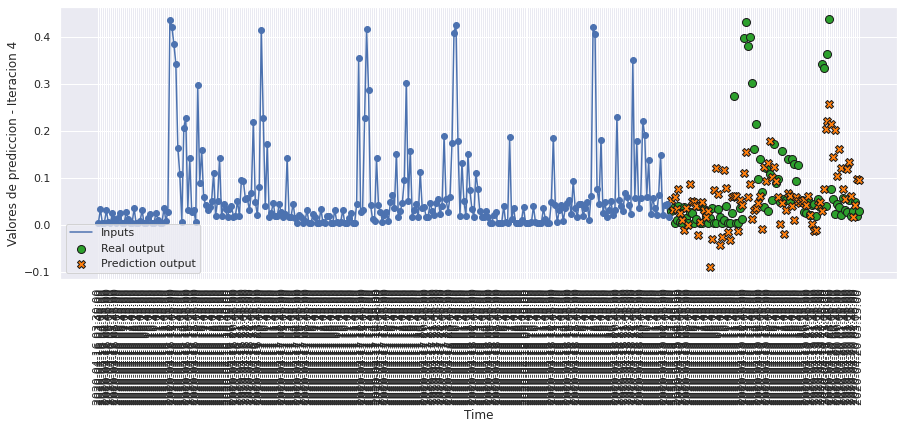

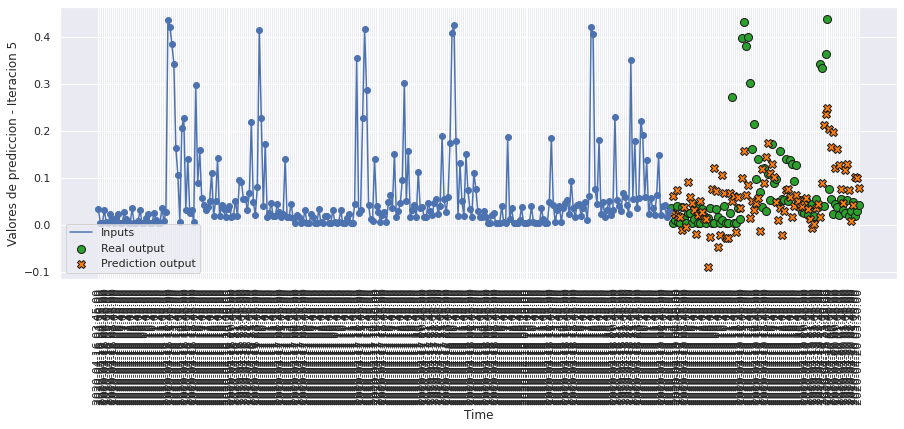

...

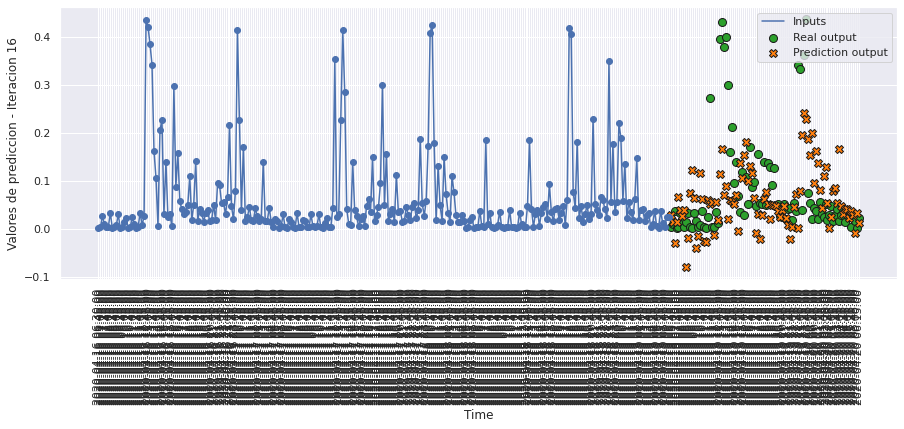

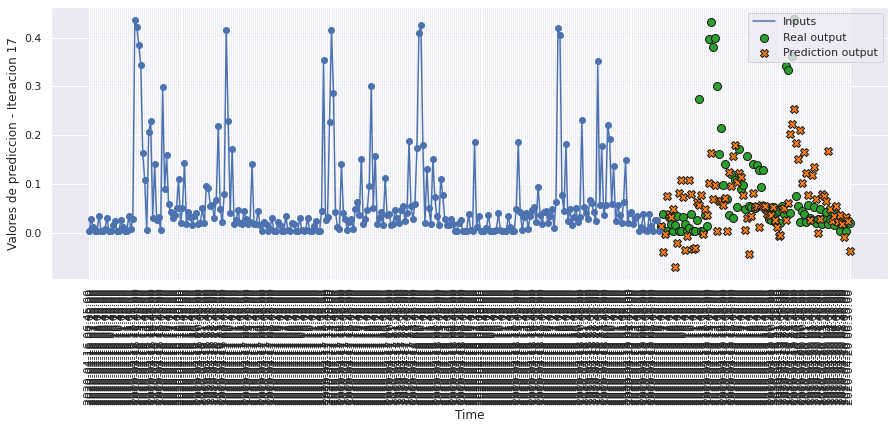

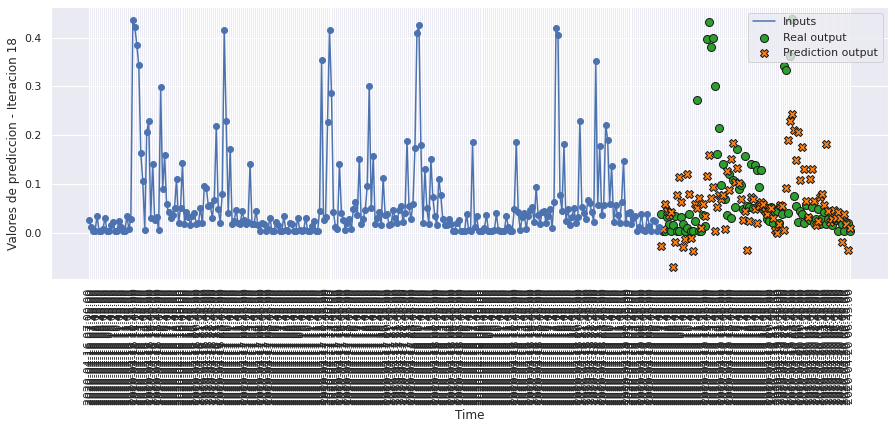

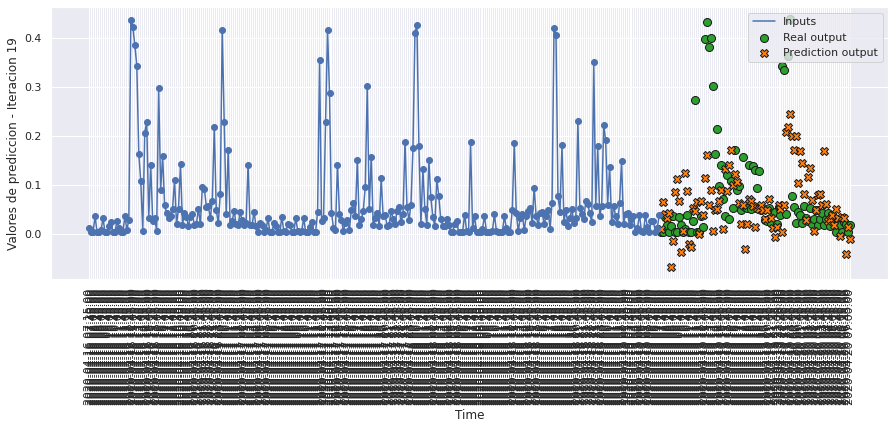

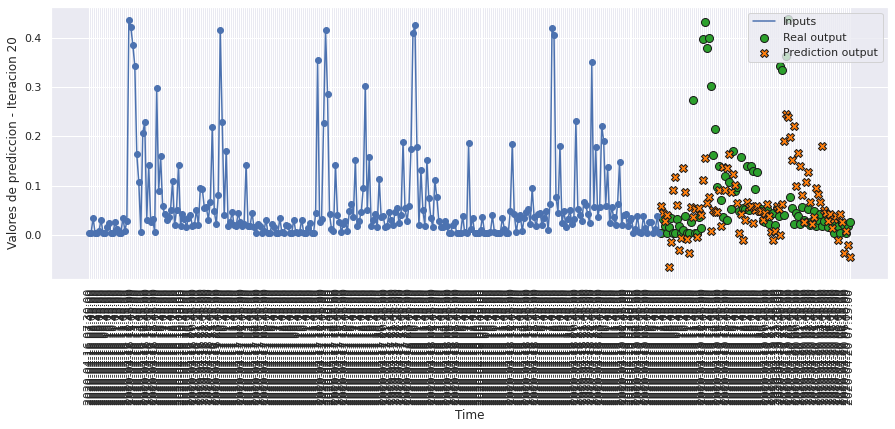

In [121]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict7, 20, 0)

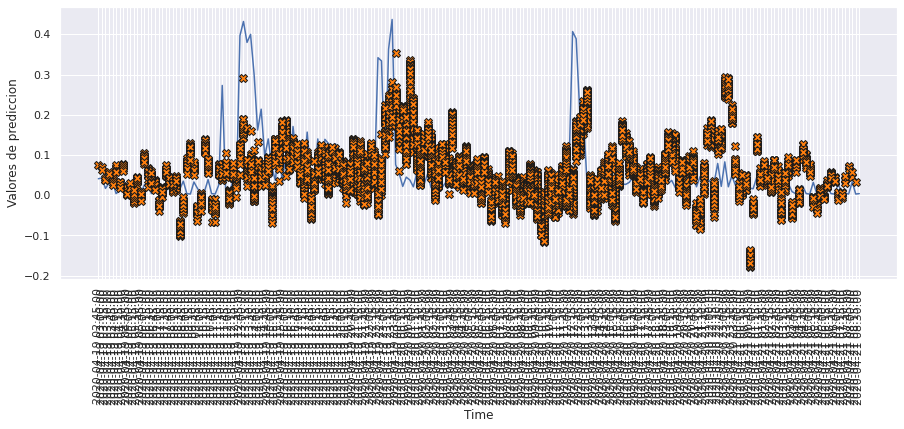

In [122]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict7, 120)

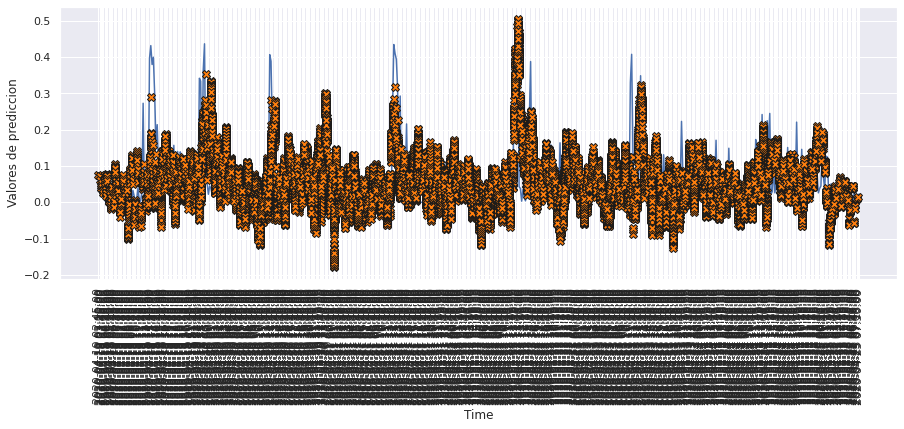

In [123]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict7, 500)

# MODELO 8: CONVLSTM2D

### Construimos el modelo

In [124]:
def build_model8():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(1, 1, n_entrada, n_features)),
        tf.keras.layers.ConvLSTM2D(filters=64, kernel_size=(1,1), activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones),
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [125]:
model8 = build_model8()
model8.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_lstm2d (ConvLSTM2D)    (None, 1, 288, 64)        18432     
                                                                 
 flatten_3 (Flatten)         (None, 18432)             0         
                                                                 
 dense_7 (Dense)             (None, 96)                1769568   
                                                                 
Total params: 1,788,000
Trainable params: 1,788,000
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [126]:
history8 = model8.fit(scaled_trainX_5D, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_5D, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 9s 22ms/step - loss: 0.0063 - mae: 0.0492 - mse: 0.0063 - smape: 0.8920 - val_loss: 0.0065 - val_mae: 0.0473 - val_mse: 0.0065 - val_smape: 0.8989
Epoch 2/200
351/351 [==============================] - 7s 20ms/step - loss: 0.0054 - mae: 0.0437 - mse: 0.0054 - smape: 0.7883 - val_loss: 0.0064 - val_mae: 0.0459 - val_mse: 0.0064 - val_smape: 0.8487
Epoch 3/200
351/351 [==============================] - 7s 20ms/step - loss: 0.0053 - mae: 0.0430 - mse: 0.0053 - smape: 0.7751 - val_loss: 0.0065 - val_mae: 0.0463 - val_mse: 0.0065 - val_smape: 0.8409
Epoch 4/200
351/351 [==============================] - 7s 20ms/step - loss: 0.0053 - mae: 0.0427 - mse: 0.0053 - smape: 0.7722 - val_loss: 0.0065 - val_mae: 0.0466 - val_mse: 0.0065 - val_smape: 0.8618
Epoch 5/200
351/351 [==============================] - 7s 20ms/step - loss: 0.0052 - mae: 0.0425 - mse: 0.0052 - smape: 0.7709 - val_loss: 0.0065 - val_mae: 0.0465 - val_mse: 0.0065 - val_smap

351/351 [==============================] - 7s 21ms/step - loss: 0.0029 - mae: 0.0381 - mse: 0.0029 - smape: 0.8925 - val_loss: 0.0109 - val_mae: 0.0722 - val_mse: 0.0109 - val_smape: 1.2379
Epoch 82/200
351/351 [==============================] - 7s 20ms/step - loss: 0.0029 - mae: 0.0381 - mse: 0.0029 - smape: 0.8929 - val_loss: 0.0109 - val_mae: 0.0725 - val_mse: 0.0109 - val_smape: 1.2335
Epoch 83/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0029 - mae: 0.0380 - mse: 0.0029 - smape: 0.8924 - val_loss: 0.0109 - val_mae: 0.0725 - val_mse: 0.0109 - val_smape: 1.2300
Epoch 84/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0029 - mae: 0.0380 - mse: 0.0029 - smape: 0.8923 - val_loss: 0.0110 - val_mae: 0.0728 - val_mse: 0.0110 - val_smape: 1.2266
Epoch 85/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0029 - mae: 0.0380 - mse: 0.0029 - smape: 0.8922 - val_loss: 0.0109 - val_mae: 0.0725 - val_mse: 0.0109 - val_smape: 1.236

In [127]:
hist8 = pd.DataFrame(history8.history)
hist8['epoch'] = history8.epoch
hist8

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006336,0.049225,0.006336,0.891989,0.006535,0.047344,0.006535,0.898948,0
1,0.005440,0.043653,0.005440,0.788331,0.006424,0.045921,0.006424,0.848652,1
2,0.005328,0.042999,0.005328,0.775137,0.006470,0.046256,0.006470,0.840861,2
3,0.005257,0.042715,0.005257,0.772218,0.006501,0.046650,0.006501,0.861847,3
4,0.005188,0.042458,0.005188,0.770948,0.006534,0.046485,0.006534,0.850470,4
...,...,...,...,...,...,...,...,...,...
97,0.002808,0.037658,0.002808,0.892171,0.011351,0.074311,0.011351,1.252303,97
98,0.002802,0.037645,0.002802,0.892470,0.011297,0.074099,0.011297,1.246096,98
99,0.002797,0.037609,0.002797,0.892465,0.011390,0.074682,0.011390,1.244894,99
100,0.002794,0.037609,0.002794,0.892506,0.011378,0.074694,0.011378,1.242563,100


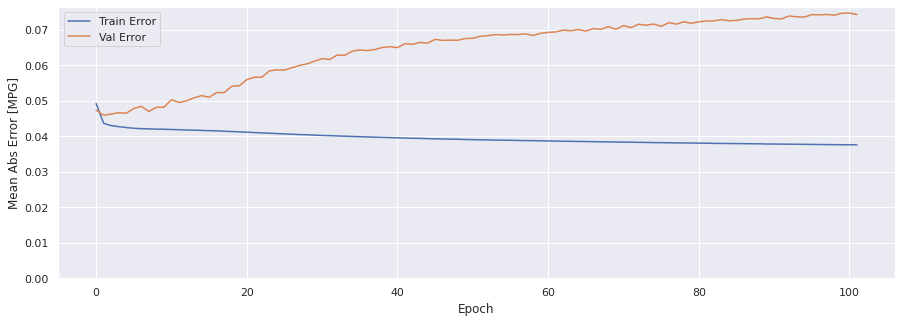

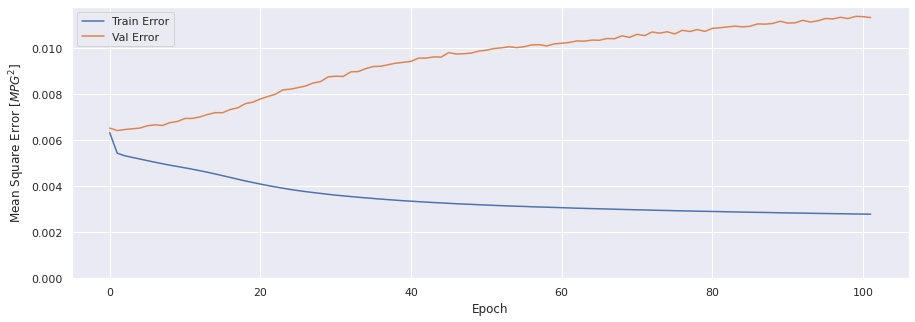

In [128]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history8)

### Evaluar predicciones

In [129]:
score_train8 = model8.evaluate(scaled_trainX_5D, data_trainY, verbose=1)
print(f'Loss:{score_train8[0]}')
print(f'MAE:{score_train8[1]}')
print(f'MSE:{score_train8[2]}')
print(f'SMAPE:{score_train8[3]}')

1401/1401 [==============================] - 9s 7ms/step - loss: 0.0026 - mae: 0.0363 - mse: 0.0026 - smape: 0.8770
Loss:0.0026346801314502954
MAE:0.0363098569214344
MSE:0.0026346801314502954
SMAPE:0.8770074844360352


In [130]:
score_val8 = model8.evaluate(scaled_valX_5D, data_valY, verbose=1)
print(f'Loss:{score_val8[0]}')
print(f'MAE:{score_val8[1]}')
print(f'MSE:{score_val8[2]}')
print(f'SMAPE:{score_val8[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0113 - mae: 0.0743 - mse: 0.0113 - smape: 1.2487
Loss:0.011337365955114365
MAE:0.07428918033838272
MSE:0.011337365955114365
SMAPE:1.2486858367919922


In [131]:
score_test8 = model8.evaluate(scaled_testX_5D, data_testY, verbose=1)
print(f'Loss:{score_test8[0]}')
print(f'MAE:{score_test8[1]}')
print(f'MSE:{score_test8[2]}')
print(f'SMAPE:{score_test8[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0088 - mae: 0.0636 - mse: 0.0088 - smape: 1.1688
Loss:0.008772709406912327
MAE:0.06360029429197311
MSE:0.008772709406912327
SMAPE:1.1688035726547241


### Comparativa de resultados

In [132]:
result = hist8.iloc[-1]
comparativa8 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test8[1], score_test8[2], score_test8[3], math.sqrt(score_test8[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa8.style.set_caption("Método de ventana de varios pasos - CONVLSTM 2D")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.037582,0.002788,0.892597,0.052799
VALIDACION,0.074289,0.011337,1.249280,0.106477
TEST,0.063600,0.008773,1.168804,0.093663


### Obtener predicciones

In [133]:
trainPredict8 = model8.predict(scaled_trainX_5D)
testPredict8 = model8.predict(scaled_testX_5D)

### Visualización de las predicciones

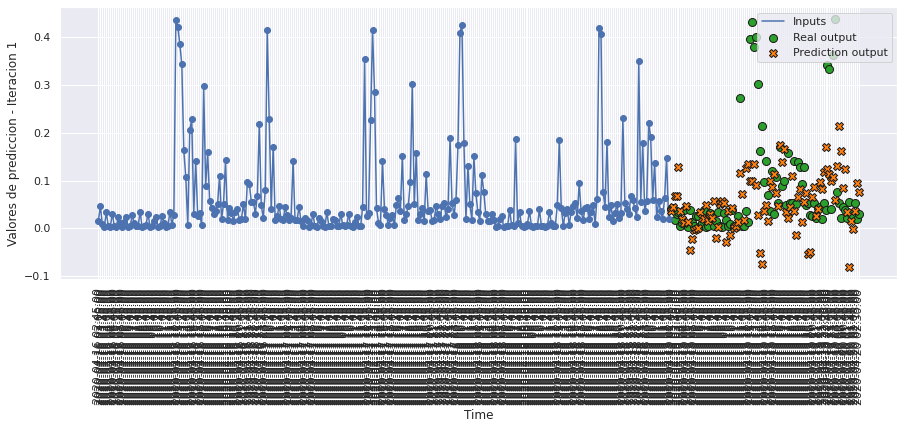

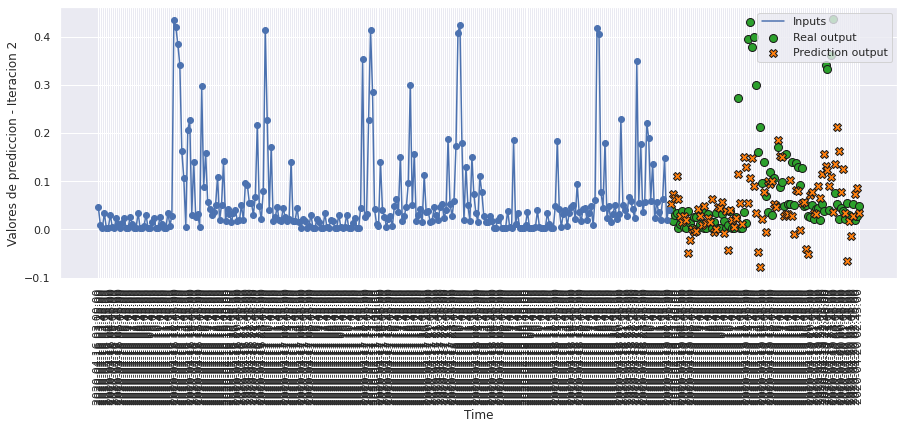

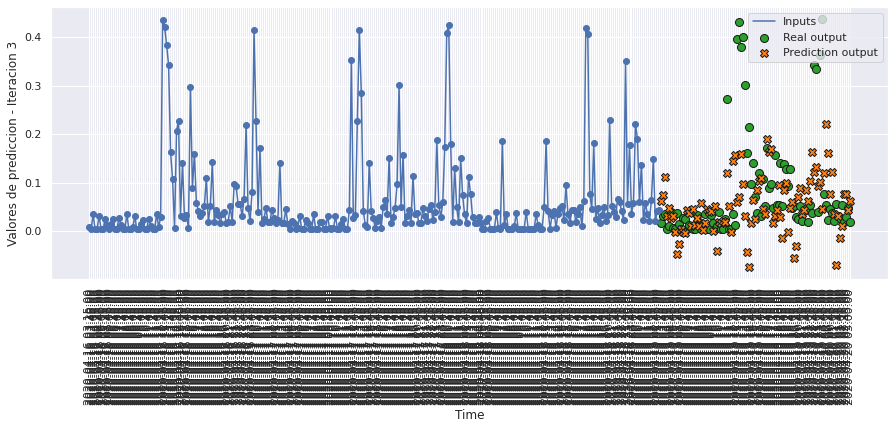

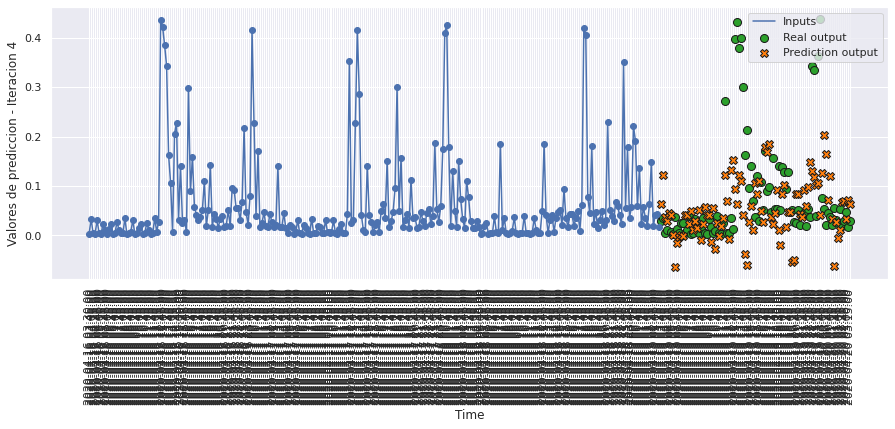

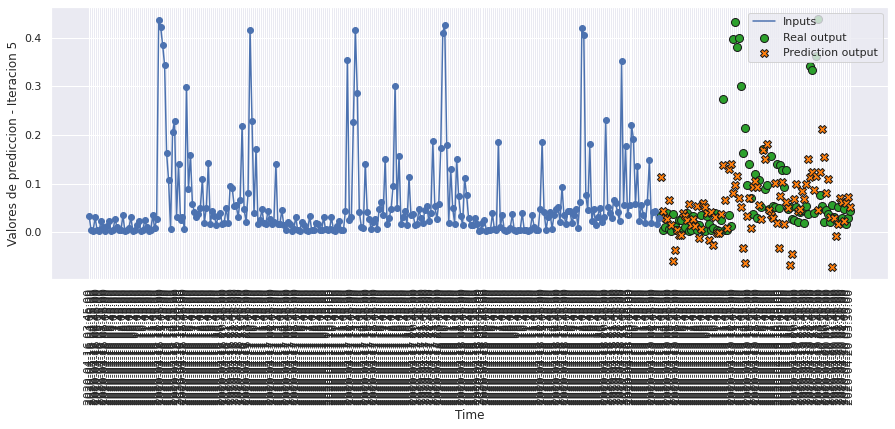

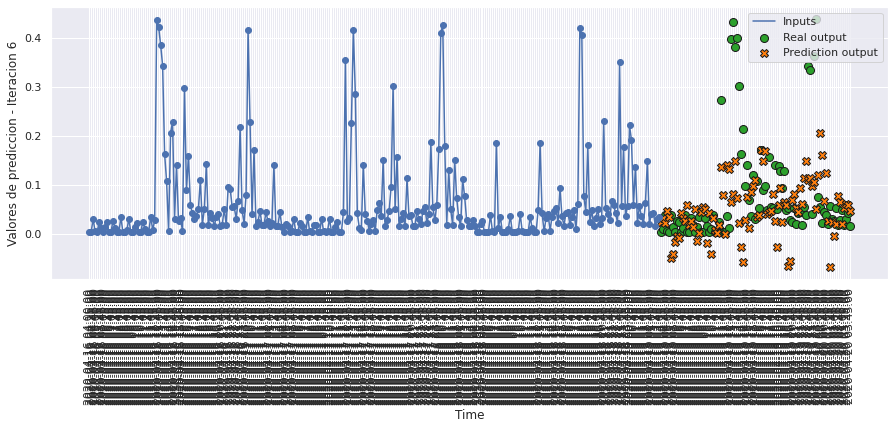

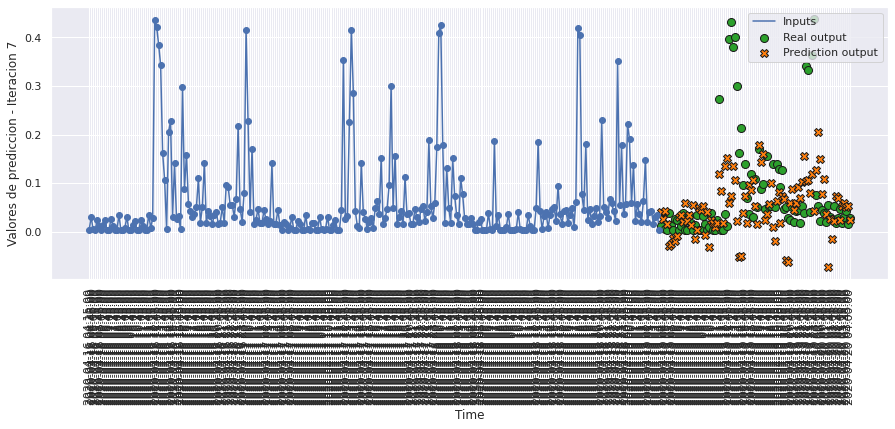

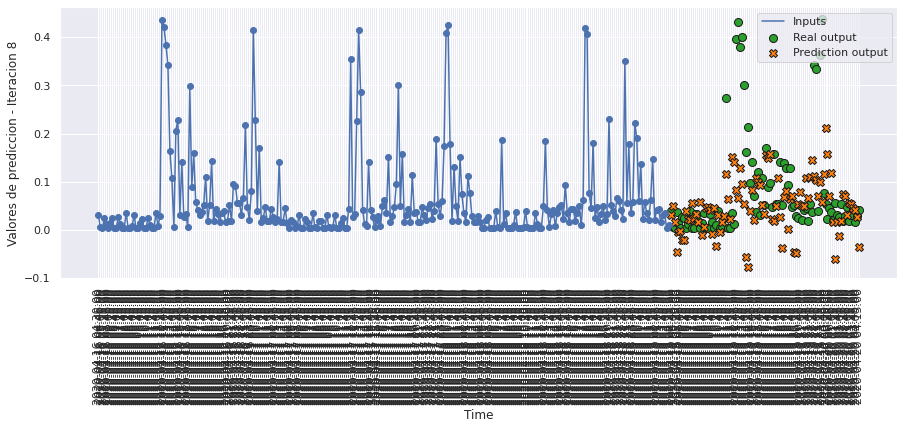

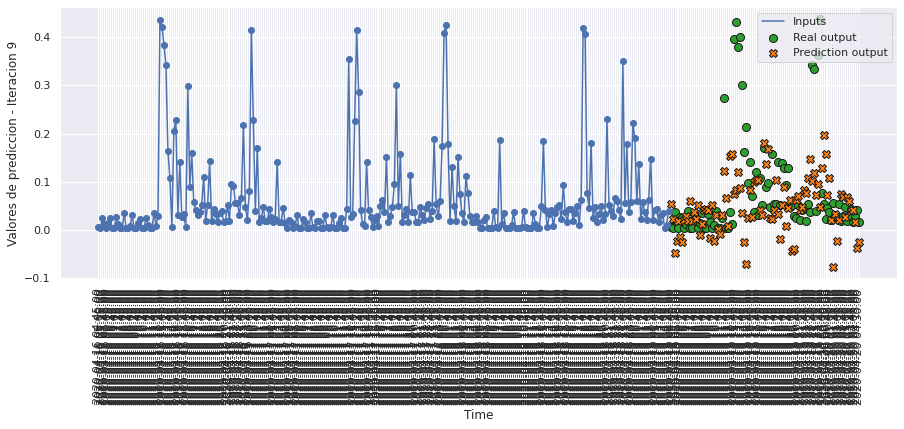

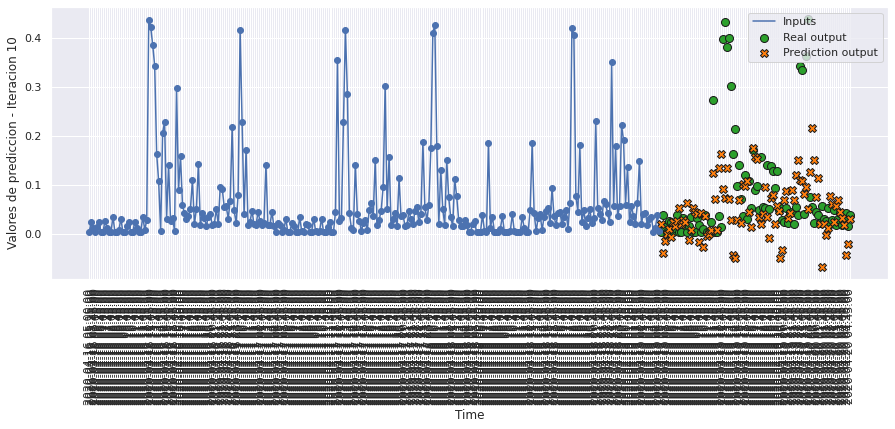

In [134]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict8, 10, 0)

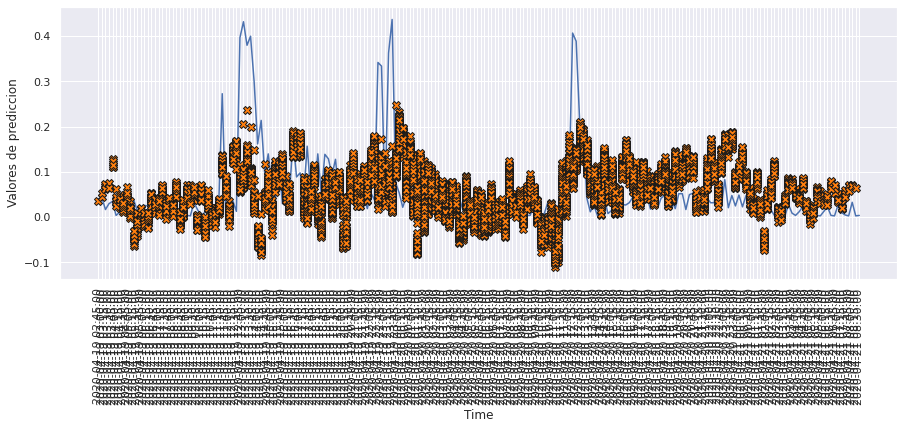

In [135]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict8, 120)

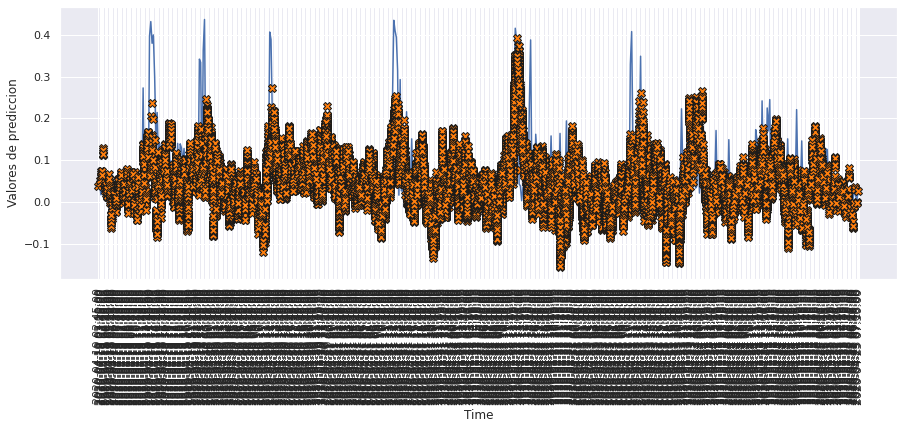

In [136]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict8, 500)

# MODELO 9: LSTM ENCODE DECODE

### Construimos el modelo

In [137]:
def build_model9():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh'),
        tf.keras.layers.RepeatVector(n_predicciones),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Dense(100)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Dense(1))
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [138]:
model9 = build_model9()
model9.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 128)               69632     
                                                                 
 repeat_vector (RepeatVector  (None, 96, 128)          0         
 )                                                               
                                                                 
 lstm_9 (LSTM)               (None, 96, 128)           131584    
                                                                 
 time_distributed_6 (TimeDis  (None, 96, 100)          12900     
 tributed)                                                       
                                                                 
 time_distributed_7 (TimeDis  (None, 96, 1)            101       
 tributed)                                                       
                                                      

### Entrenamiento del modelo

In [139]:
history9 = model9.fit(scaled_trainX, data_trainY_3D_2, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY_3D_2), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 19s 49ms/step - loss: 0.0067 - mae: 0.0492 - mse: 0.0067 - smape: 0.8610 - val_loss: 0.0067 - val_mae: 0.0481 - val_mse: 0.0067 - val_smape: 0.8659
Epoch 2/200
351/351 [==============================] - 16s 47ms/step - loss: 0.0059 - mae: 0.0456 - mse: 0.0059 - smape: 0.8111 - val_loss: 0.0070 - val_mae: 0.0475 - val_mse: 0.0070 - val_smape: 0.8268
Epoch 3/200
351/351 [==============================] - 16s 47ms/step - loss: 0.0056 - mae: 0.0440 - mse: 0.0056 - smape: 0.7892 - val_loss: 0.0067 - val_mae: 0.0444 - val_mse: 0.0067 - val_smape: 0.7955
Epoch 4/200
351/351 [==============================] - 17s 47ms/step - loss: 0.0054 - mae: 0.0431 - mse: 0.0054 - smape: 0.7728 - val_loss: 0.0071 - val_mae: 0.0470 - val_mse: 0.0071 - val_smape: 0.8477
Epoch 5/200
351/351 [==============================] - 16s 47ms/step - loss: 0.0053 - mae: 0.0427 - mse: 0.0053 - smape: 0.7688 - val_loss: 0.0070 - val_mae: 0.0461 - val_mse: 0.0070 - val

351/351 [==============================] - 17s 49ms/step - loss: 0.0016 - mae: 0.0248 - mse: 0.0016 - smape: 0.6213 - val_loss: 0.0105 - val_mae: 0.0509 - val_mse: 0.0105 - val_smape: 0.8131
Epoch 82/200
351/351 [==============================] - 17s 49ms/step - loss: 0.0016 - mae: 0.0248 - mse: 0.0016 - smape: 0.6214 - val_loss: 0.0104 - val_mae: 0.0513 - val_mse: 0.0104 - val_smape: 0.8142
Epoch 83/200
351/351 [==============================] - 17s 49ms/step - loss: 0.0018 - mae: 0.0258 - mse: 0.0018 - smape: 0.6277 - val_loss: 0.0105 - val_mae: 0.0513 - val_mse: 0.0105 - val_smape: 0.8041
Epoch 84/200
351/351 [==============================] - 17s 49ms/step - loss: 0.0016 - mae: 0.0248 - mse: 0.0016 - smape: 0.6213 - val_loss: 0.0103 - val_mae: 0.0507 - val_mse: 0.0103 - val_smape: 0.8038
Epoch 85/200
351/351 [==============================] - 17s 49ms/step - loss: 0.0015 - mae: 0.0242 - mse: 0.0015 - smape: 0.6179 - val_loss: 0.0105 - val_mae: 0.0510 - val_mse: 0.0105 - val_smape: 

In [140]:
hist9 = pd.DataFrame(history9.history)
hist9['epoch'] = history9.epoch
hist9

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006664,0.049226,0.006664,0.860962,0.006691,0.048122,0.006691,0.865877,0
1,0.005879,0.045582,0.005879,0.811115,0.006960,0.047475,0.006960,0.826824,1
2,0.005566,0.044045,0.005566,0.789231,0.006720,0.044432,0.006720,0.795541,2
3,0.005390,0.043051,0.005390,0.772791,0.007139,0.047015,0.007139,0.847713,3
4,0.005316,0.042708,0.005316,0.768797,0.007009,0.046127,0.007009,0.828812,4
...,...,...,...,...,...,...,...,...,...
96,0.001403,0.023382,0.001403,0.609493,0.010820,0.051987,0.010820,0.814149,96
97,0.001390,0.023287,0.001390,0.608702,0.010508,0.051492,0.010508,0.816839,97
98,0.001308,0.022755,0.001308,0.606130,0.010697,0.051613,0.010697,0.808738,98
99,0.001340,0.022971,0.001340,0.606881,0.010624,0.051642,0.010624,0.811819,99


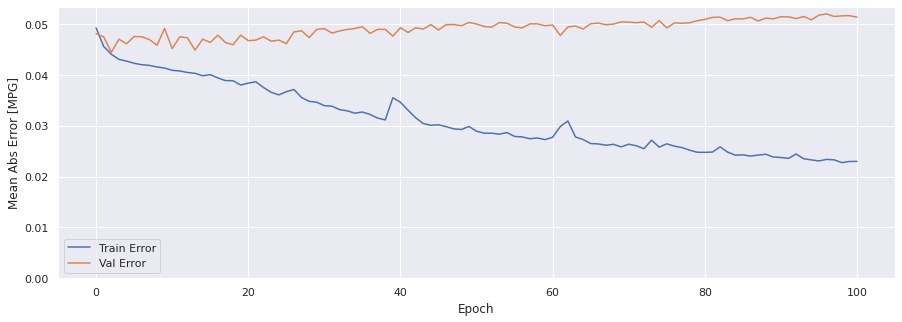

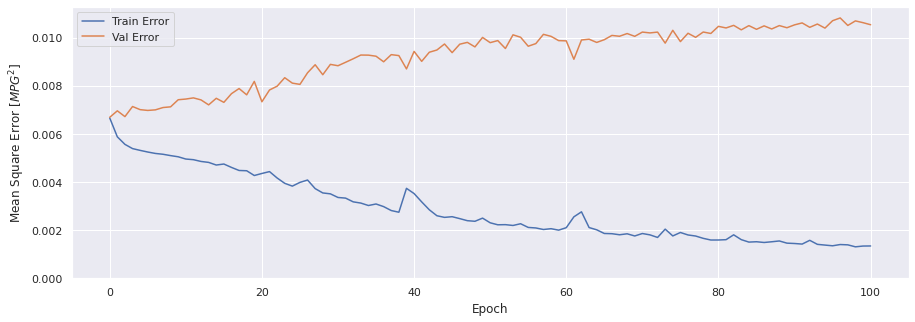

In [141]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history9)

### Evaluar predicciones

In [142]:
score_train9 = model9.evaluate(scaled_trainX, data_trainY_3D_2, verbose=1)
print(f'Loss:{score_train9[0]}')
print(f'MAE:{score_train9[1]}')
print(f'MSE:{score_train9[2]}')
print(f'SMAPE:{score_train9[3]}')

1401/1401 [==============================] - 28s 19ms/step - loss: 0.0014 - mae: 0.0233 - mse: 0.0014 - smape: 0.6090
Loss:0.0013888351386412978
MAE:0.02329018898308277
MSE:0.0013888353714719415
SMAPE:0.6089965105056763


In [143]:
score_val9 = model9.evaluate(scaled_valX, data_valY_3D_2, verbose=1)
print(f'Loss:{score_val9[0]}')
print(f'MAE:{score_val9[1]}')
print(f'MSE:{score_val9[2]}')
print(f'SMAPE:{score_val9[3]}')

291/291 [==============================] - 6s 19ms/step - loss: 0.0105 - mae: 0.0514 - mse: 0.0105 - smape: 0.8161
Loss:0.010537459515035152
MAE:0.051357701420784
MSE:0.010537453927099705
SMAPE:0.8161126971244812


In [144]:
score_test9 = model9.evaluate(scaled_testX, data_testY_3D_2, verbose=1)
print(f'Loss:{score_test9[0]}')
print(f'MAE:{score_test9[1]}')
print(f'MSE:{score_test9[2]}')
print(f'SMAPE:{score_test9[3]}')

291/291 [==============================] - 6s 19ms/step - loss: 0.0090 - mae: 0.0514 - mse: 0.0090 - smape: 0.7970
Loss:0.009046432562172413
MAE:0.051400333642959595
MSE:0.009046435356140137
SMAPE:0.7970155477523804


### Comparativa de resultados

In [145]:
result = hist9.iloc[-1]
comparativa9 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test9[1], score_test9[2], score_test9[3], math.sqrt(score_test9[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa9.style.set_caption("Método de ventana de varios pasos - LSTM ENCODE DECODE")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.022988,0.001344,0.606838,0.036658
VALIDACION,0.051358,0.010537,0.816507,0.102652
TEST,0.051400,0.009046,0.797016,0.095113


### Obtener predicciones

In [146]:
trainPredict9 = model9.predict(scaled_trainX)
testPredict9 = model9.predict(scaled_testX)

### Visualización de las predicciones

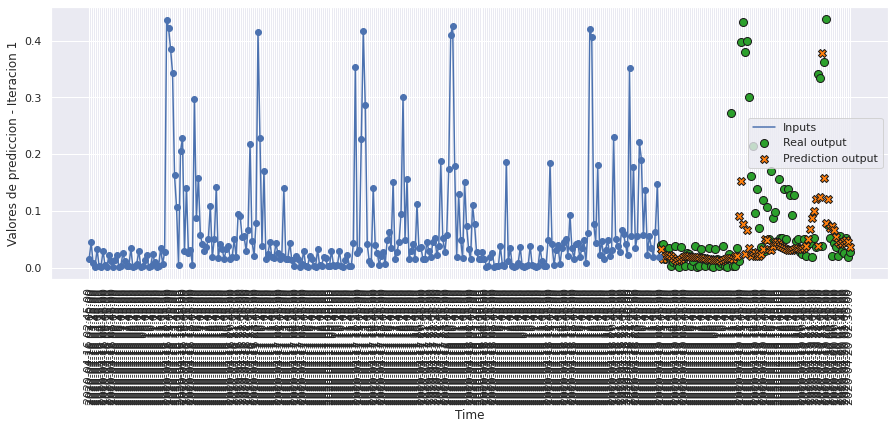

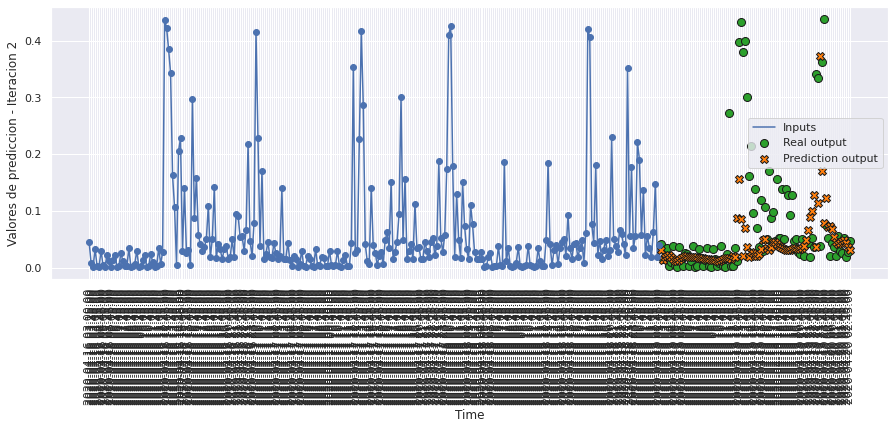

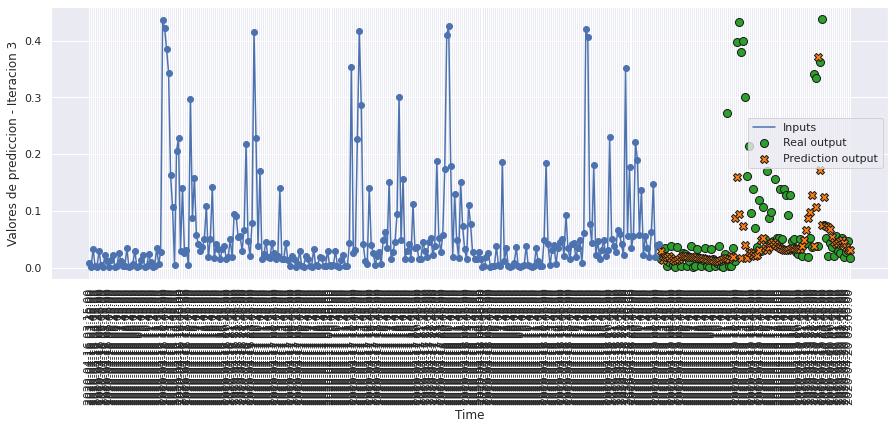

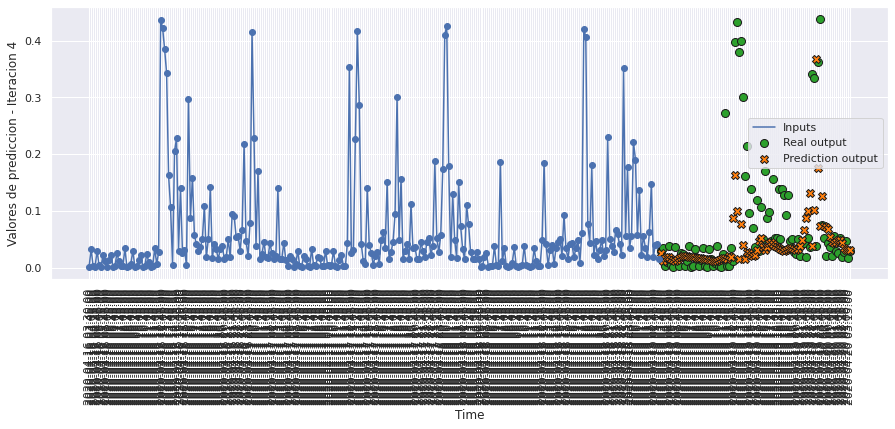

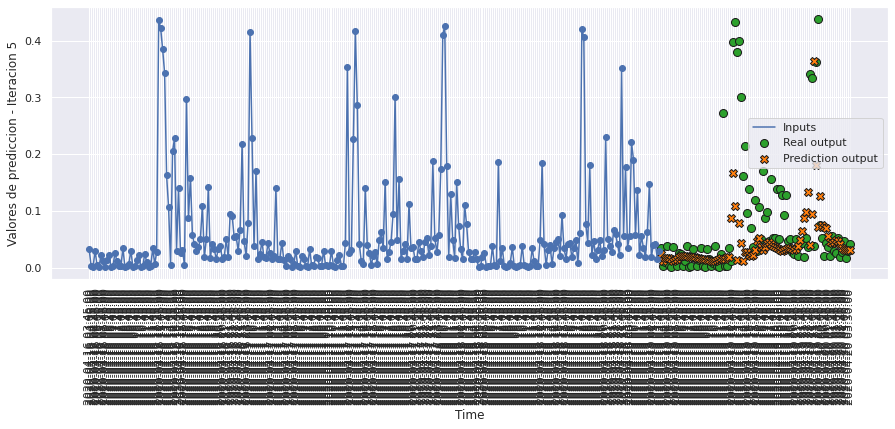

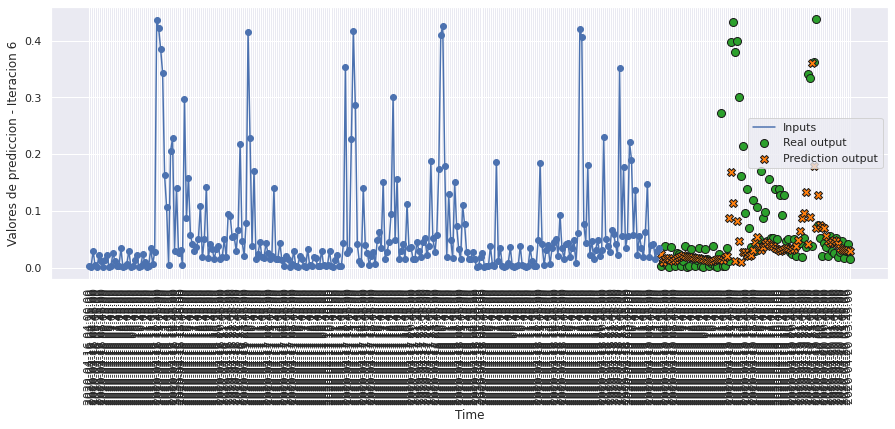

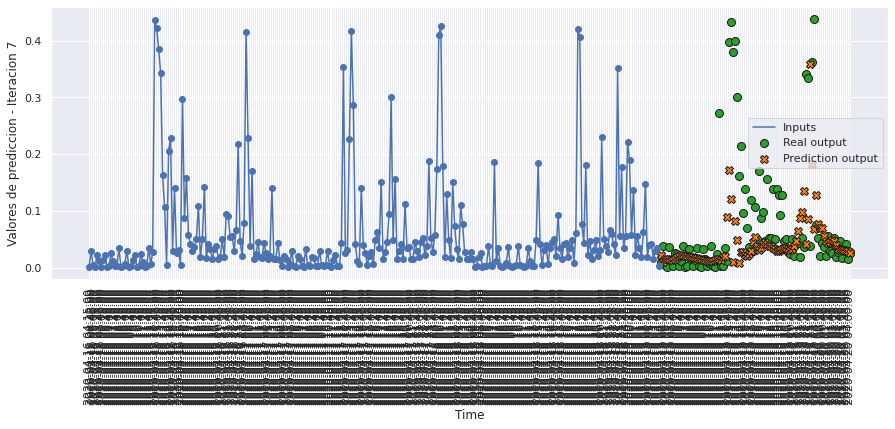

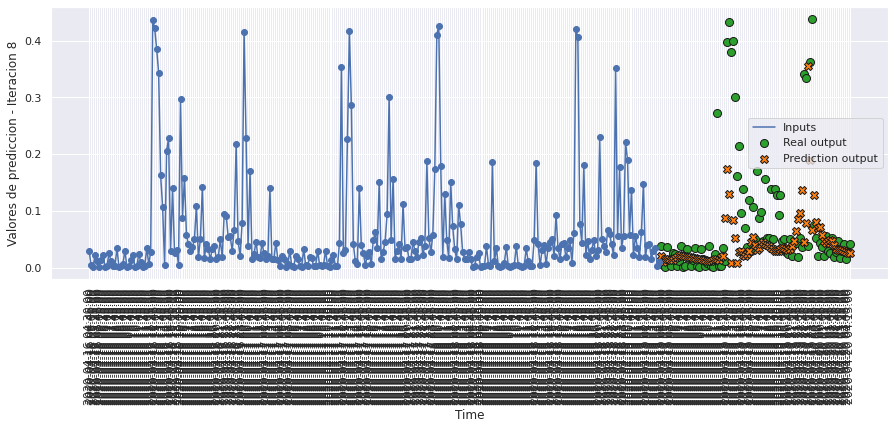

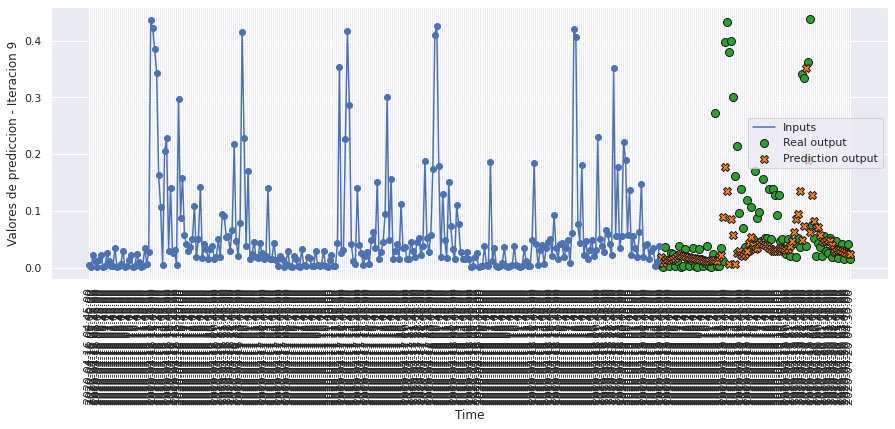

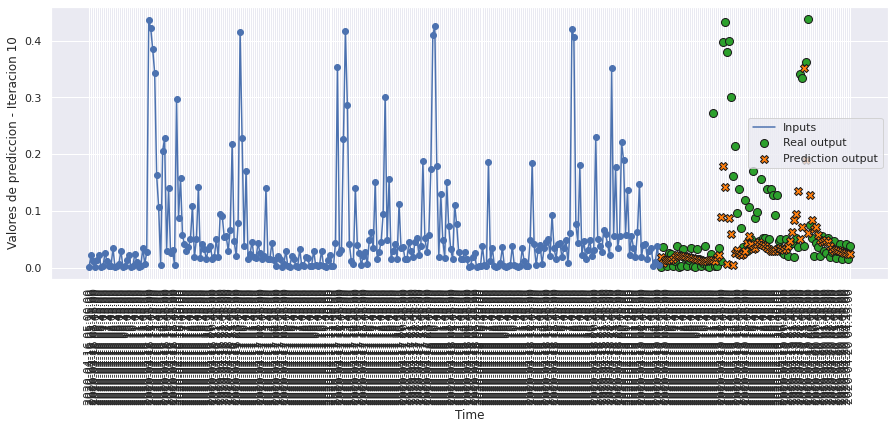

In [147]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, 
                        testPredict9.reshape(testPredict9.shape[0],n_predicciones), 10, 0)

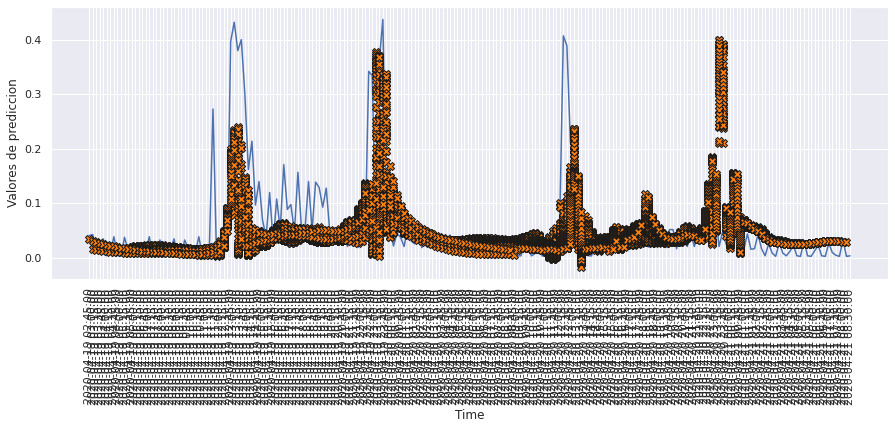

In [148]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions_values(int(test_df.iloc[0].name), 
                        testPredict9.reshape(testPredict9.shape[0],n_predicciones), 120)

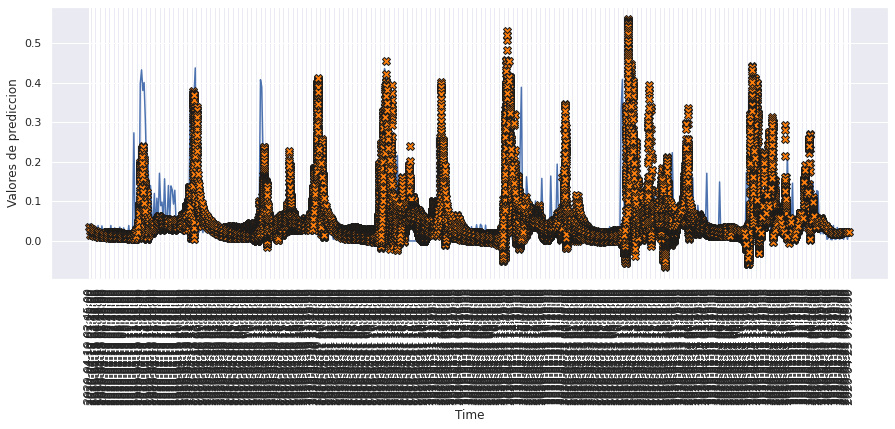

In [149]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions_values(int(test_df.iloc[0].name), 
                        testPredict9.reshape(testPredict9.shape[0],n_predicciones), 500)

# MODELO 10: GRU UNA CAPA

### Construimos el modelo

In [150]:
def build_model10():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.GRU(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [151]:
model10 = build_model10()
model10.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 128)               52608     
                                                                 
 dense_10 (Dense)            (None, 96)                12384     
                                                                 
Total params: 64,992
Trainable params: 64,992
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [152]:
history10 = model10.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 13s 35ms/step - loss: 0.0067 - mae: 0.0489 - mse: 0.0067 - smape: 0.8585 - val_loss: 0.0066 - val_mae: 0.0476 - val_mse: 0.0066 - val_smape: 0.9009
Epoch 2/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0061 - mae: 0.0473 - mse: 0.0061 - smape: 0.8614 - val_loss: 0.0066 - val_mae: 0.0480 - val_mse: 0.0066 - val_smape: 0.9180
Epoch 3/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0060 - mae: 0.0467 - mse: 0.0060 - smape: 0.8396 - val_loss: 0.0066 - val_mae: 0.0477 - val_mse: 0.0066 - val_smape: 0.8855
Epoch 4/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0059 - mae: 0.0458 - mse: 0.0059 - smape: 0.8182 - val_loss: 0.0066 - val_mae: 0.0493 - val_mse: 0.0066 - val_smape: 0.9369
Epoch 5/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0057 - mae: 0.0451 - mse: 0.0057 - smape: 0.8094 - val_loss: 0.0067 - val_mae: 0.0483 - val_mse: 0.0067 - val

351/351 [==============================] - 12s 34ms/step - loss: 0.0031 - mae: 0.0346 - mse: 0.0031 - smape: 0.7498 - val_loss: 0.0086 - val_mae: 0.0491 - val_mse: 0.0086 - val_smape: 0.8779
Epoch 82/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0031 - mae: 0.0347 - mse: 0.0031 - smape: 0.7500 - val_loss: 0.0089 - val_mae: 0.0495 - val_mse: 0.0089 - val_smape: 0.8804
Epoch 83/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0031 - mae: 0.0345 - mse: 0.0031 - smape: 0.7485 - val_loss: 0.0086 - val_mae: 0.0484 - val_mse: 0.0086 - val_smape: 0.8745
Epoch 84/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0030 - mae: 0.0344 - mse: 0.0030 - smape: 0.7476 - val_loss: 0.0082 - val_mae: 0.0473 - val_mse: 0.0082 - val_smape: 0.8643
Epoch 85/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0030 - mae: 0.0343 - mse: 0.0030 - smape: 0.7478 - val_loss: 0.0088 - val_mae: 0.0494 - val_mse: 0.0088 - val_smape: 

In [153]:
hist10 = pd.DataFrame(history10.history)
hist10['epoch'] = history10.epoch
hist10

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006722,0.048890,0.006722,0.858549,0.006572,0.047580,0.006572,0.900944,0
1,0.006071,0.047315,0.006071,0.861373,0.006567,0.048042,0.006567,0.917962,1
2,0.005985,0.046678,0.005985,0.839586,0.006565,0.047707,0.006565,0.885470,2
3,0.005853,0.045828,0.005853,0.818174,0.006646,0.049344,0.006646,0.936920,3
4,0.005688,0.045090,0.005688,0.809366,0.006707,0.048336,0.006707,0.875339,4
...,...,...,...,...,...,...,...,...,...
98,0.002916,0.033819,0.002916,0.744380,0.008638,0.048718,0.008638,0.877189,98
99,0.002886,0.033663,0.002886,0.743214,0.008588,0.048504,0.008588,0.875194,99
100,0.002873,0.033604,0.002873,0.742955,0.008823,0.049253,0.008823,0.888707,100
101,0.002904,0.033747,0.002904,0.744067,0.008648,0.048626,0.008648,0.871792,101


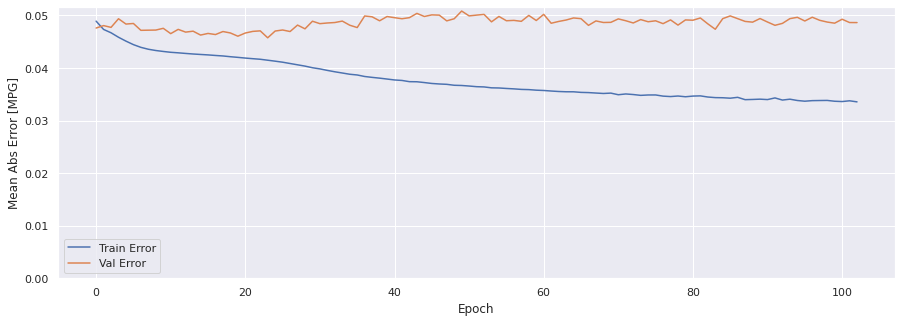

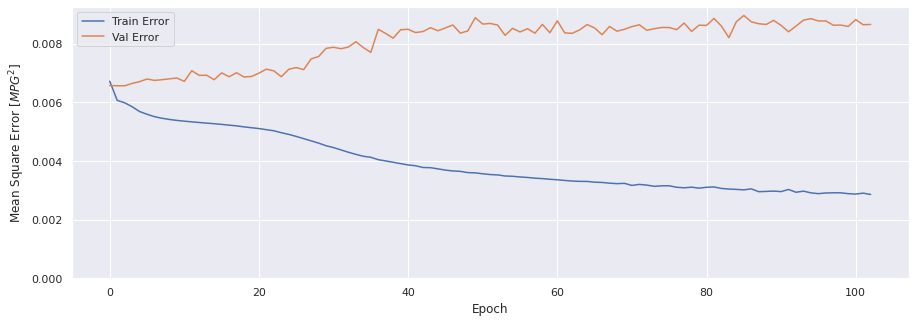

In [154]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history10)

### Evaluar predicciones

In [155]:
score_train10 = model10.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train10[0]}')
print(f'MAE:{score_train10[1]}')
print(f'MSE:{score_train10[2]}')
print(f'SMAPE:{score_train10[3]}')

1401/1401 [==============================] - 17s 12ms/step - loss: 0.0030 - mae: 0.0340 - mse: 0.0030 - smape: 0.7502
Loss:0.0029765937943011522
MAE:0.033970266580581665
MSE:0.0029765937943011522
SMAPE:0.7502397894859314


In [156]:
score_val10 = model10.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val10[0]}')
print(f'MAE:{score_val10[1]}')
print(f'MSE:{score_val10[2]}')
print(f'SMAPE:{score_val10[3]}')

291/291 [==============================] - 4s 12ms/step - loss: 0.0087 - mae: 0.0486 - mse: 0.0087 - smape: 0.8869
Loss:0.008658050559461117
MAE:0.0486169196665287
MSE:0.008658050559461117
SMAPE:0.8868951201438904


In [157]:
score_test10 = model10.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test10[0]}')
print(f'MAE:{score_test10[1]}')
print(f'MSE:{score_test10[2]}')
print(f'SMAPE:{score_test10[3]}')

291/291 [==============================] - 3s 12ms/step - loss: 0.0077 - mae: 0.0499 - mse: 0.0077 - smape: 0.8528
Loss:0.007712143007665873
MAE:0.04993448778986931
MSE:0.007712143007665873
SMAPE:0.8527575731277466


### Comparativa de resultados

In [158]:
result = hist10.iloc[-1]
comparativa10 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test10[1], score_test10[2], score_test10[3], math.sqrt(score_test10[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa10.style.set_caption("Método de ventana de varios pasos - GRU una capa")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.033544,0.002859,0.742796,0.053473
VALIDACION,0.048617,0.008658,0.887479,0.093049
TEST,0.049934,0.007712,0.852758,0.087819


### Obtener predicciones

In [159]:
trainPredict10 = model10.predict(scaled_trainX)
testPredict10 = model10.predict(scaled_testX)

### Visualización de las predicciones

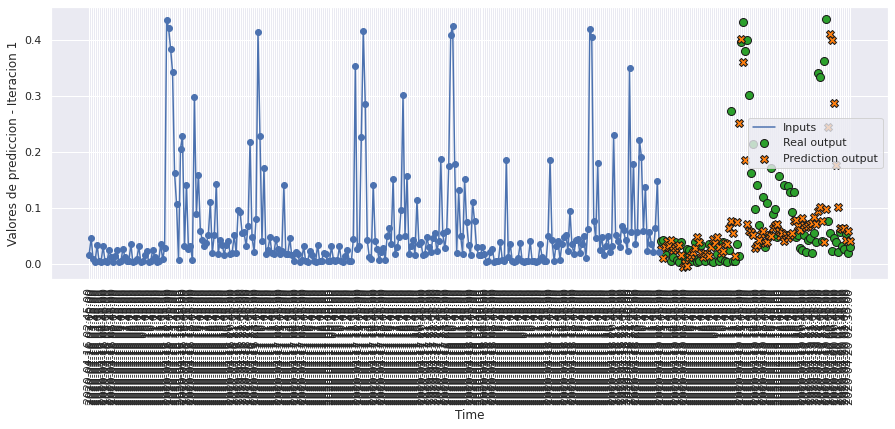

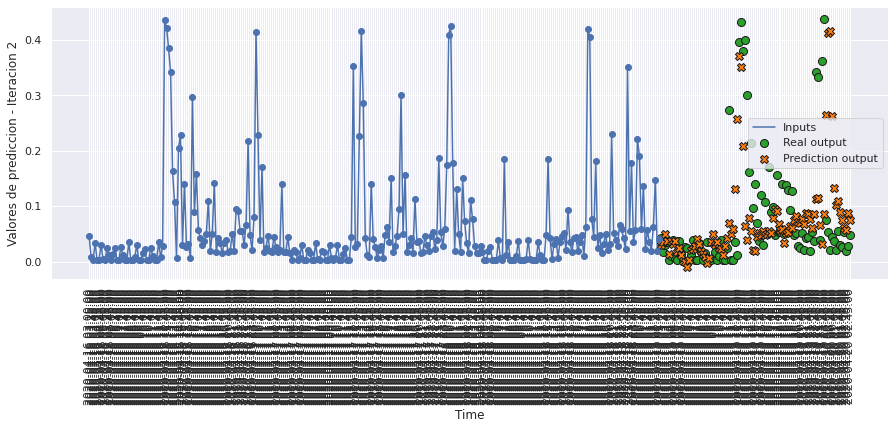

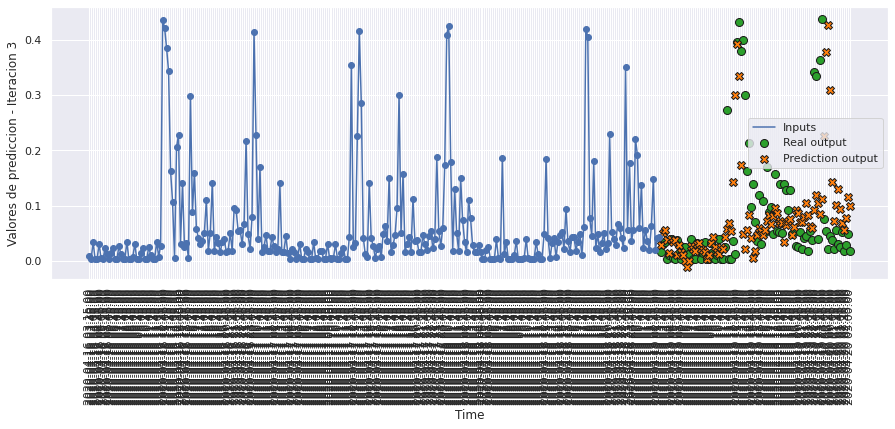

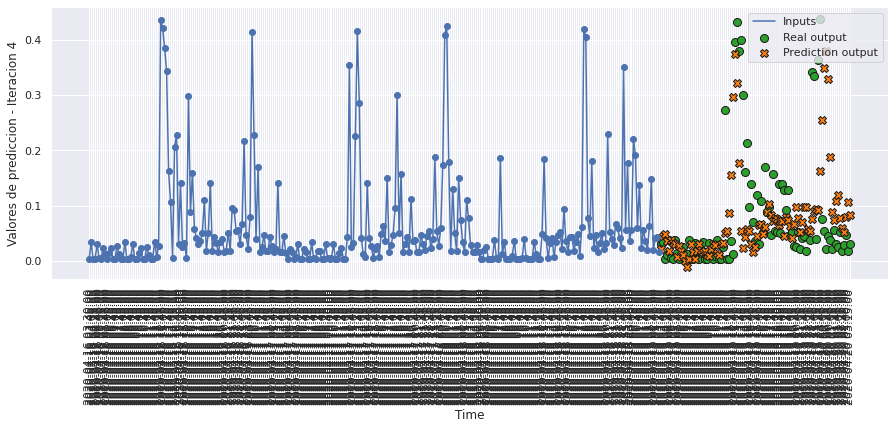

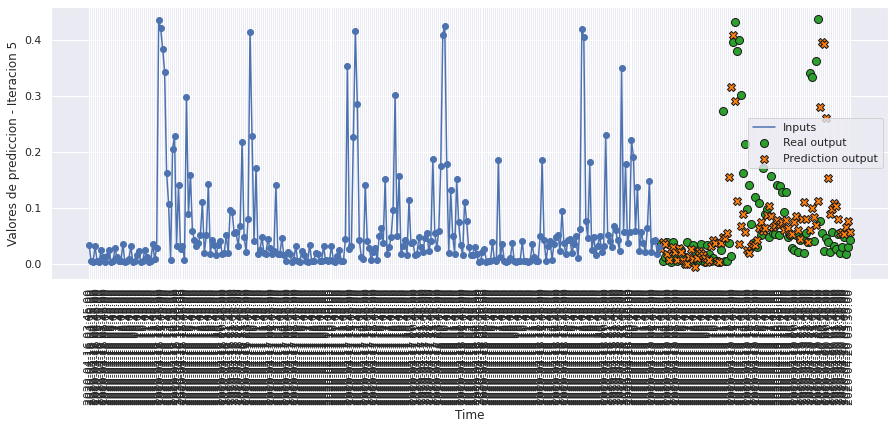

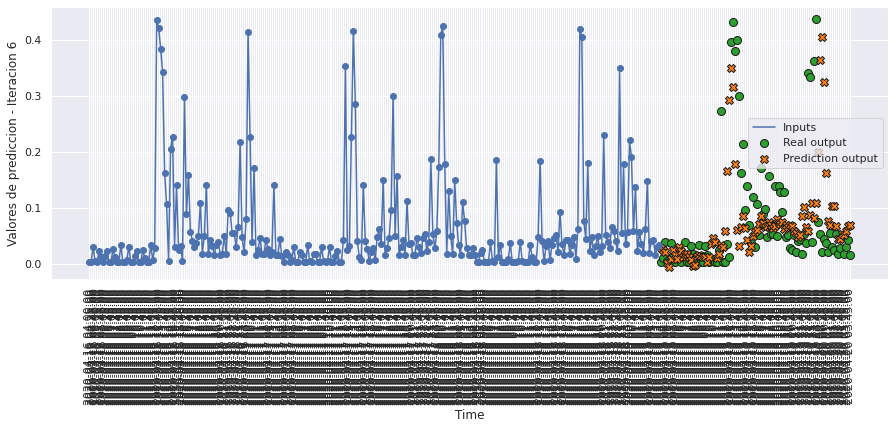

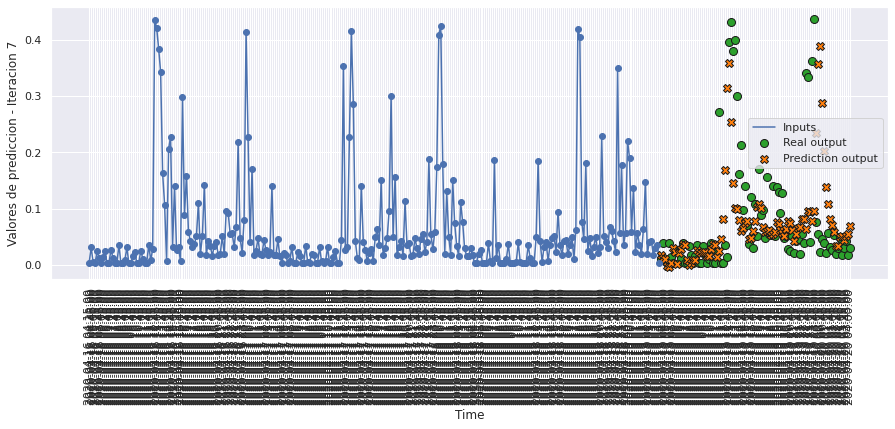

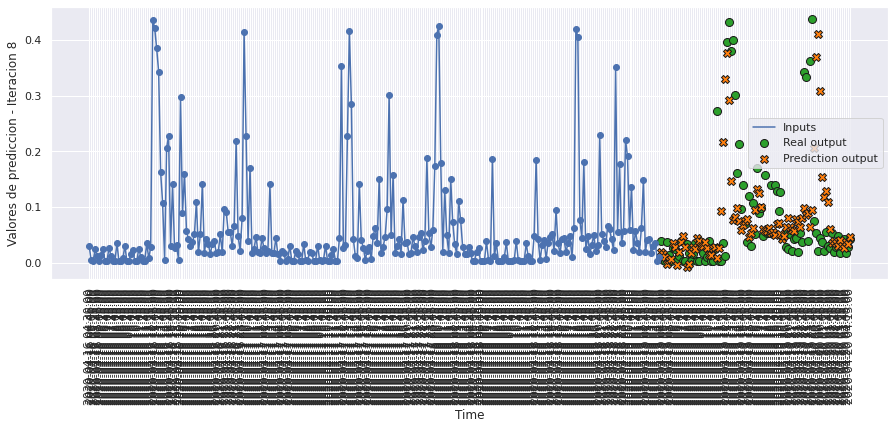

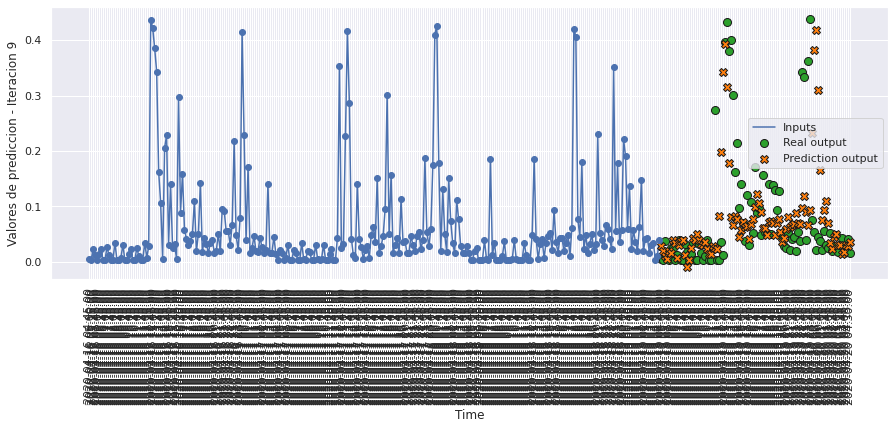

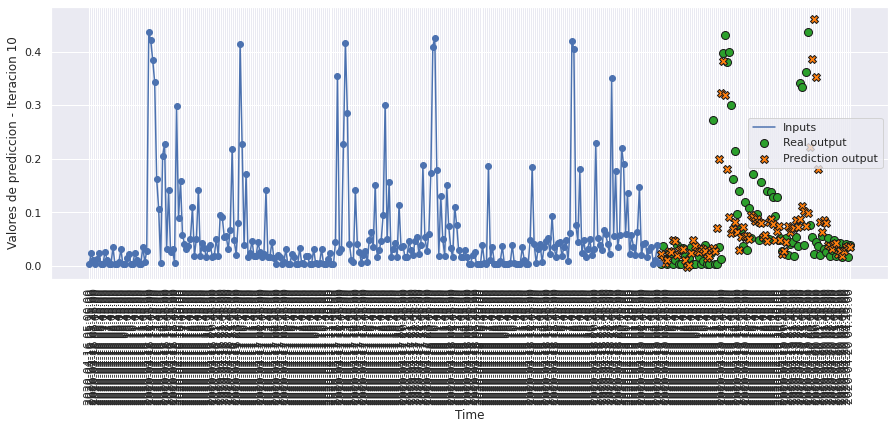

In [160]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict10, 10, 0)

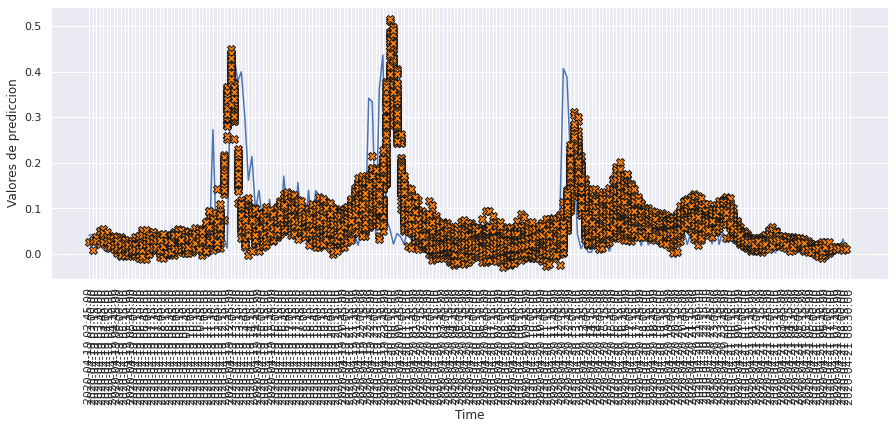

In [161]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict10, 120)

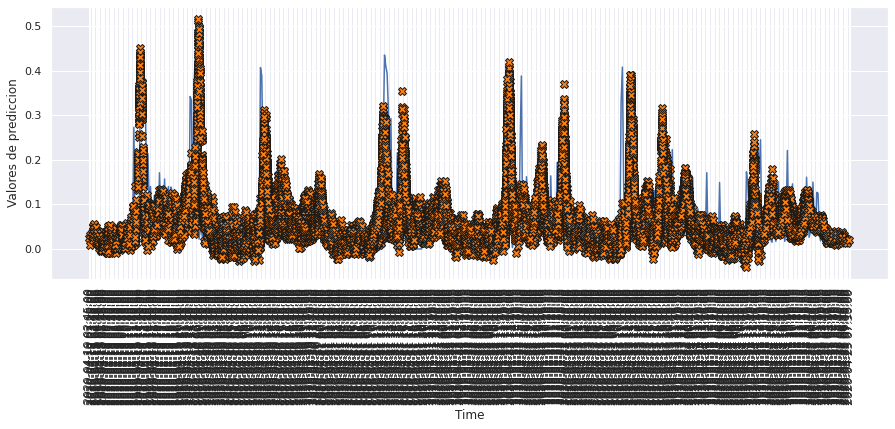

In [162]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict10, 500)

# MODELO 11: GRU DOS CAPAS

### Construimos el modelo

In [163]:
def build_model11():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.GRU(128, activation='tanh', return_sequences=True),
        tf.keras.layers.GRU(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [164]:
model11 = build_model11()
model11.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_1 (GRU)                 (None, 288, 128)          52608     
                                                                 
 gru_2 (GRU)                 (None, 128)               99072     
                                                                 
 dense_11 (Dense)            (None, 96)                12384     
                                                                 
Total params: 164,064
Trainable params: 164,064
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [165]:
history11 = model11.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 24s 63ms/step - loss: 0.0065 - mae: 0.0482 - mse: 0.0065 - smape: 0.8625 - val_loss: 0.0066 - val_mae: 0.0492 - val_mse: 0.0066 - val_smape: 0.9304
Epoch 2/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0060 - mae: 0.0469 - mse: 0.0060 - smape: 0.8483 - val_loss: 0.0066 - val_mae: 0.0478 - val_mse: 0.0066 - val_smape: 0.8850
Epoch 3/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0058 - mae: 0.0455 - mse: 0.0058 - smape: 0.8148 - val_loss: 0.0066 - val_mae: 0.0481 - val_mse: 0.0066 - val_smape: 0.8683
Epoch 4/200
351/351 [==============================] - 21s 61ms/step - loss: 0.0056 - mae: 0.0443 - mse: 0.0056 - smape: 0.7924 - val_loss: 0.0067 - val_mae: 0.0470 - val_mse: 0.0067 - val_smape: 0.8360
Epoch 5/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0055 - mae: 0.0437 - mse: 0.0055 - smape: 0.7852 - val_loss: 0.0069 - val_mae: 0.0479 - val_mse: 0.0069 - val

351/351 [==============================] - 23s 65ms/step - loss: 0.0018 - mae: 0.0277 - mse: 0.0018 - smape: 0.6968 - val_loss: 0.0089 - val_mae: 0.0495 - val_mse: 0.0089 - val_smape: 0.9105
Epoch 82/200
351/351 [==============================] - 23s 64ms/step - loss: 0.0018 - mae: 0.0275 - mse: 0.0018 - smape: 0.6957 - val_loss: 0.0090 - val_mae: 0.0500 - val_mse: 0.0090 - val_smape: 0.9146
Epoch 83/200
351/351 [==============================] - 23s 65ms/step - loss: 0.0017 - mae: 0.0274 - mse: 0.0017 - smape: 0.6950 - val_loss: 0.0088 - val_mae: 0.0496 - val_mse: 0.0088 - val_smape: 0.9157
Epoch 84/200
351/351 [==============================] - 22s 64ms/step - loss: 0.0017 - mae: 0.0273 - mse: 0.0017 - smape: 0.6945 - val_loss: 0.0088 - val_mae: 0.0494 - val_mse: 0.0088 - val_smape: 0.9198
Epoch 85/200
351/351 [==============================] - 23s 65ms/step - loss: 0.0017 - mae: 0.0272 - mse: 0.0017 - smape: 0.6935 - val_loss: 0.0091 - val_mae: 0.0503 - val_mse: 0.0091 - val_smape: 

In [166]:
hist11 = pd.DataFrame(history11.history)
hist11['epoch'] = history11.epoch
hist11

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006456,0.048205,0.006456,0.862500,0.006611,0.049219,0.006611,0.930385,0
1,0.006022,0.046904,0.006022,0.848342,0.006591,0.047762,0.006591,0.884955,1
2,0.005797,0.045531,0.005797,0.814771,0.006636,0.048104,0.006636,0.868254,2
3,0.005589,0.044336,0.005589,0.792426,0.006695,0.047001,0.006695,0.836035,3
4,0.005481,0.043682,0.005481,0.785191,0.006897,0.047903,0.006897,0.860046,4
...,...,...,...,...,...,...,...,...,...
97,0.001481,0.025792,0.001481,0.684337,0.008985,0.050353,0.008985,0.935004,97
98,0.001465,0.025691,0.001465,0.683838,0.009026,0.050510,0.009026,0.934617,98
99,0.001452,0.025578,0.001452,0.682579,0.009007,0.050429,0.009007,0.930243,99
100,0.001439,0.025495,0.001439,0.682216,0.009041,0.050702,0.009041,0.930122,100


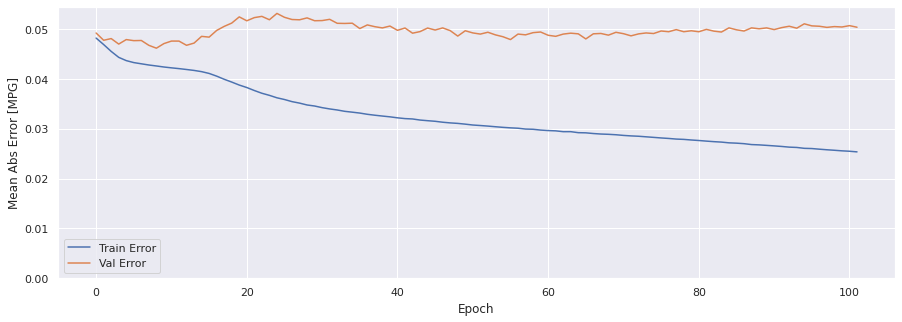

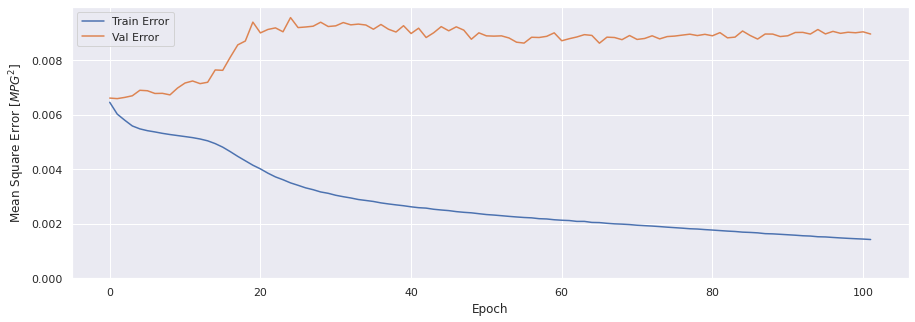

In [167]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history11)

### Evaluar predicciones

In [168]:
score_train11 = model11.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train11[0]}')
print(f'MAE:{score_train11[1]}')
print(f'MSE:{score_train11[2]}')
print(f'SMAPE:{score_train11[3]}')

1401/1401 [==============================] - 30s 20ms/step - loss: 0.0015 - mae: 0.0256 - mse: 0.0015 - smape: 0.6785
Loss:0.0014859241200610995
MAE:0.025622189044952393
MSE:0.0014859241200610995
SMAPE:0.6785498857498169


In [169]:
score_val11 = model11.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val11[0]}')
print(f'MAE:{score_val11[1]}')
print(f'MSE:{score_val11[2]}')
print(f'SMAPE:{score_val11[3]}')

291/291 [==============================] - 6s 21ms/step - loss: 0.0090 - mae: 0.0504 - mse: 0.0090 - smape: 0.9198
Loss:0.008960148319602013
MAE:0.05037914589047432
MSE:0.008960148319602013
SMAPE:0.9197597503662109


In [170]:
score_test11 = model11.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test11[0]}')
print(f'MAE:{score_test11[1]}')
print(f'MSE:{score_test11[2]}')
print(f'SMAPE:{score_test11[3]}')

291/291 [==============================] - 6s 21ms/step - loss: 0.0081 - mae: 0.0517 - mse: 0.0081 - smape: 0.9152
Loss:0.008101175539195538
MAE:0.05171869695186615
MSE:0.008101175539195538
SMAPE:0.9151613712310791


### Comparativa de resultados

In [171]:
result = hist11.iloc[-1]
comparativa11 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test11[1], score_test11[2], score_test11[3], math.sqrt(score_test11[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa11.style.set_caption("Método de ventana de varios pasos - GRU dos capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.025369,0.001423,0.680999,0.037720
VALIDACION,0.050379,0.008960,0.919911,0.094658
TEST,0.051719,0.008101,0.915161,0.090007


### Obtener predicciones

In [172]:
trainPredict11 = model11.predict(scaled_trainX)
testPredict11 = model11.predict(scaled_testX)

### Visualización de las predicciones

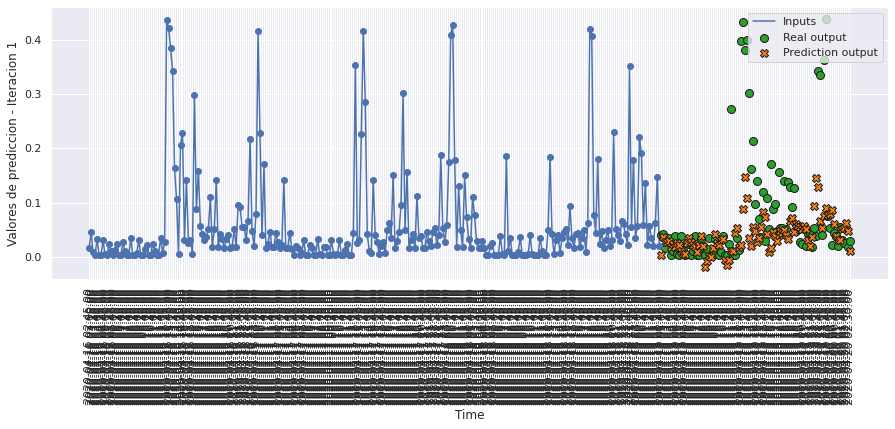

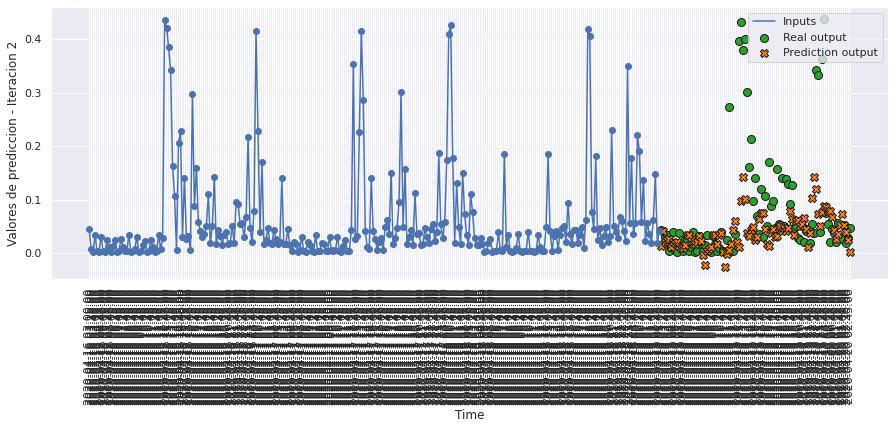

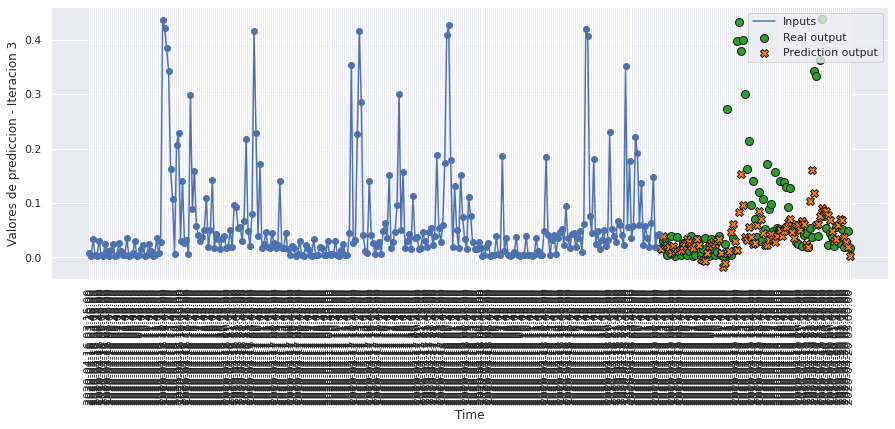

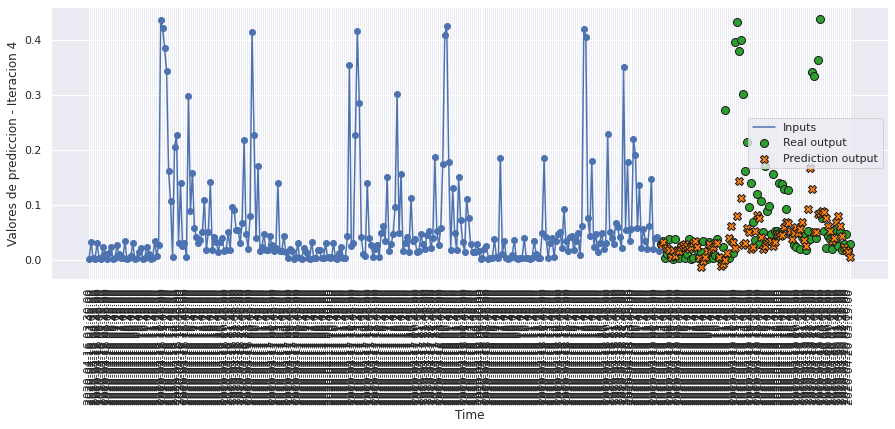

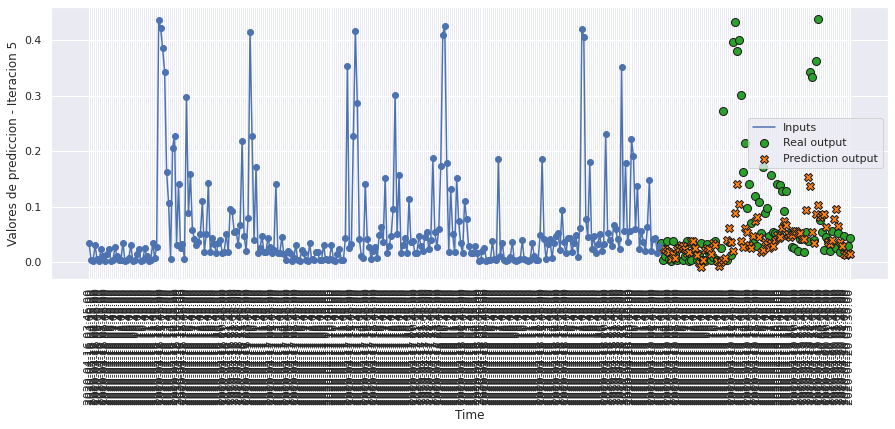

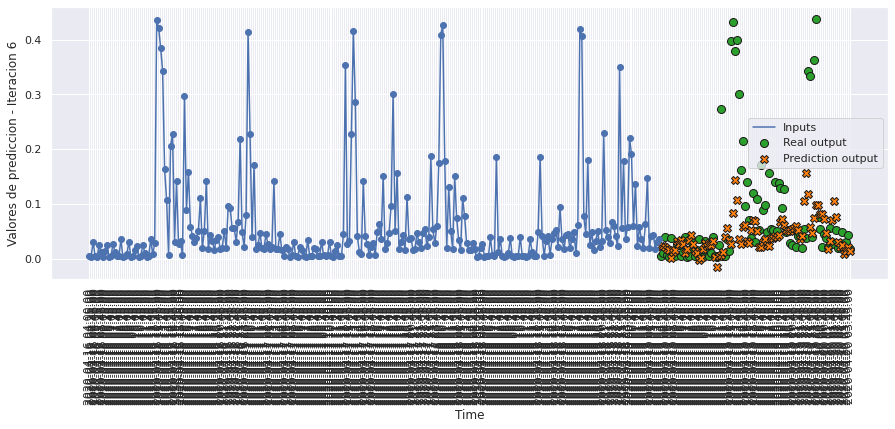

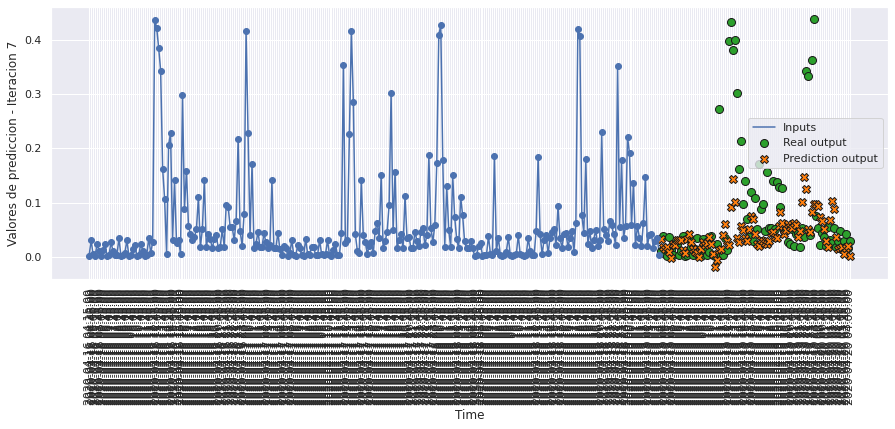

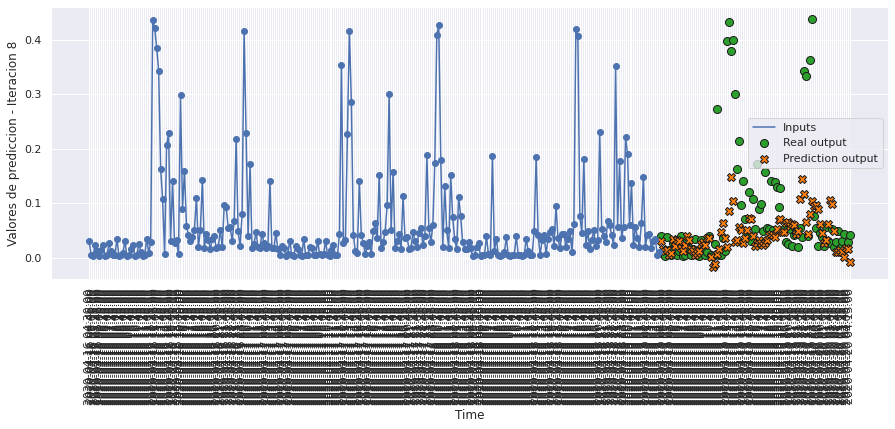

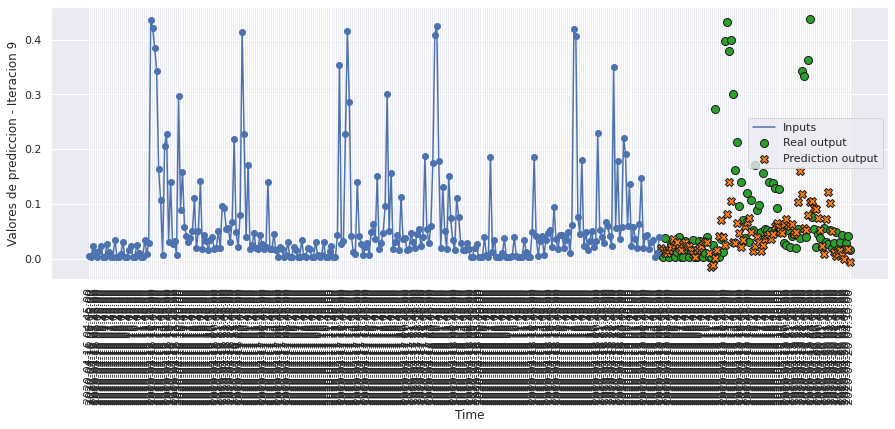

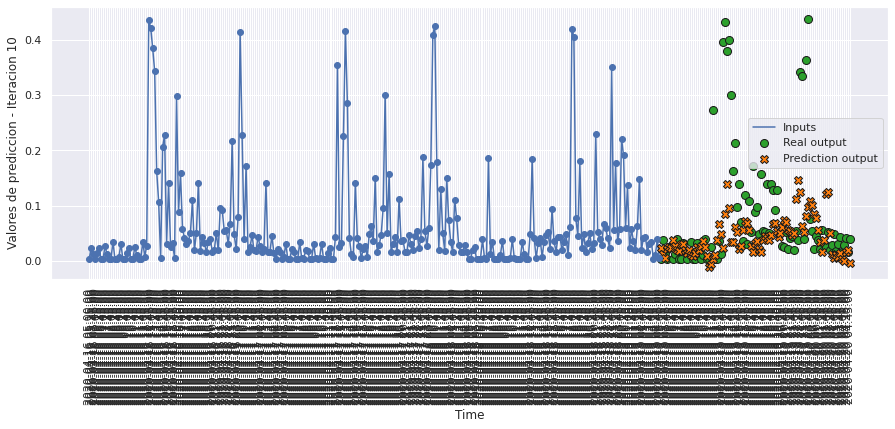

In [173]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict11, 10, 0)

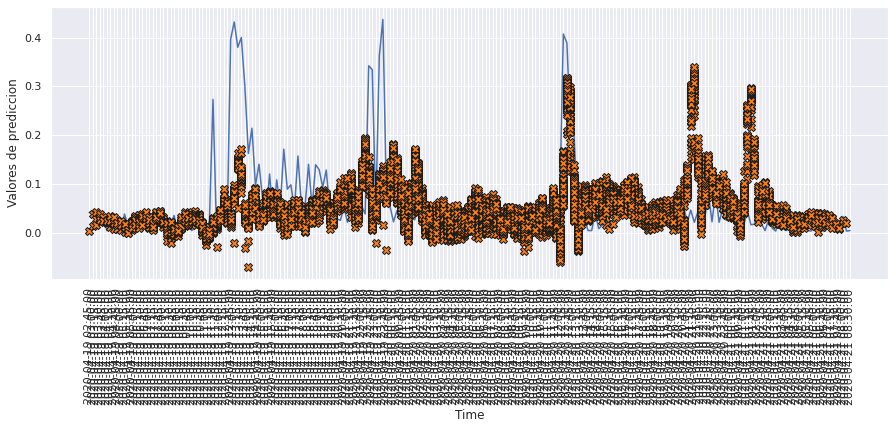

In [174]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict11, 120)

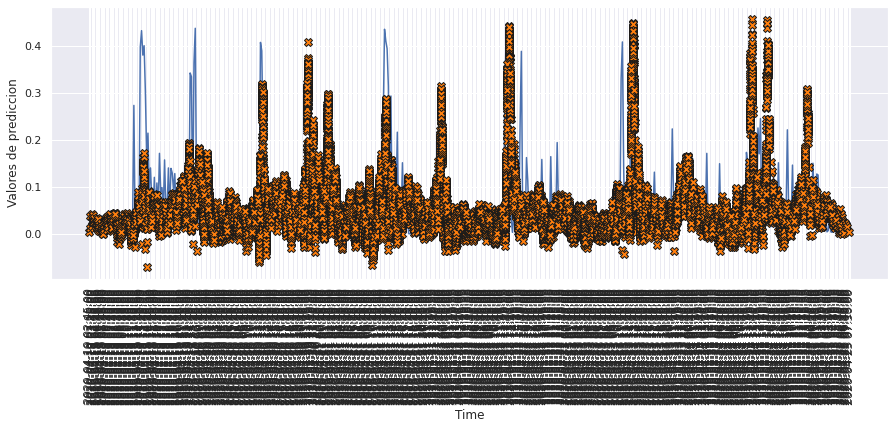

In [175]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict11, 500)

# MODELO 12: LSTM UNRESTRICTED UNA CAPA

### Construimos el modelo

In [176]:
def build_model12():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [177]:
model12 = build_model12()
model12.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 288, 128)          69632     
                                                                 
 flatten_4 (Flatten)         (None, 36864)             0         
                                                                 
 dense_12 (Dense)            (None, 96)                3539040   
                                                                 
Total params: 3,608,672
Trainable params: 3,608,672
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [178]:
history12 = model12.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 14s 37ms/step - loss: 0.0185 - mae: 0.0710 - mse: 0.0185 - smape: 1.0235 - val_loss: 0.0076 - val_mae: 0.0564 - val_mse: 0.0076 - val_smape: 1.0096
Epoch 2/200
351/351 [==============================] - 13s 36ms/step - loss: 0.0064 - mae: 0.0517 - mse: 0.0064 - smape: 0.9659 - val_loss: 0.0077 - val_mae: 0.0571 - val_mse: 0.0077 - val_smape: 1.0582
Epoch 3/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0062 - mae: 0.0500 - mse: 0.0062 - smape: 0.9397 - val_loss: 0.0072 - val_mae: 0.0529 - val_mse: 0.0072 - val_smape: 1.0016
Epoch 4/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0059 - mae: 0.0477 - mse: 0.0059 - smape: 0.8981 - val_loss: 0.0069 - val_mae: 0.0509 - val_mse: 0.0069 - val_smape: 0.9617
Epoch 5/200
351/351 [==============================] - 12s 36ms/step - loss: 0.0056 - mae: 0.0459 - mse: 0.0056 - smape: 0.8598 - val_loss: 0.0067 - val_mae: 0.0475 - val_mse: 0.0067 - val

351/351 [==============================] - 12s 35ms/step - loss: 0.0016 - mae: 0.0289 - mse: 0.0016 - smape: 0.8000 - val_loss: 0.0126 - val_mae: 0.0740 - val_mse: 0.0126 - val_smape: 1.2200
Epoch 82/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0016 - mae: 0.0286 - mse: 0.0016 - smape: 0.7970 - val_loss: 0.0127 - val_mae: 0.0741 - val_mse: 0.0127 - val_smape: 1.2171
Epoch 83/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0016 - mae: 0.0285 - mse: 0.0016 - smape: 0.7966 - val_loss: 0.0128 - val_mae: 0.0746 - val_mse: 0.0128 - val_smape: 1.2303
Epoch 84/200
351/351 [==============================] - 12s 36ms/step - loss: 0.0015 - mae: 0.0284 - mse: 0.0015 - smape: 0.7958 - val_loss: 0.0125 - val_mae: 0.0737 - val_mse: 0.0125 - val_smape: 1.2256
Epoch 85/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0015 - mae: 0.0281 - mse: 0.0015 - smape: 0.7939 - val_loss: 0.0123 - val_mae: 0.0733 - val_mse: 0.0123 - val_smape: 

In [179]:
hist12 = pd.DataFrame(history12.history)
hist12['epoch'] = history12.epoch
hist12

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.018476,0.070989,0.018476,1.023457,0.007556,0.056401,0.007556,1.009611,0
1,0.006399,0.051709,0.006399,0.965936,0.007668,0.057068,0.007668,1.058195,1
2,0.006154,0.050008,0.006154,0.939658,0.007166,0.052947,0.007166,1.001582,2
3,0.005861,0.047707,0.005861,0.898138,0.006869,0.050903,0.006869,0.961695,3
4,0.005645,0.045903,0.005645,0.859805,0.006683,0.047547,0.006683,0.922475,4
...,...,...,...,...,...,...,...,...,...
103,0.001116,0.024817,0.001116,0.764286,0.012432,0.074691,0.012432,1.236817,103
104,0.001096,0.024619,0.001096,0.762283,0.012748,0.075719,0.012748,1.241714,104
105,0.001081,0.024493,0.001081,0.761075,0.012458,0.074916,0.012458,1.239340,105
106,0.001059,0.024263,0.001059,0.758275,0.012715,0.075535,0.012715,1.244320,106


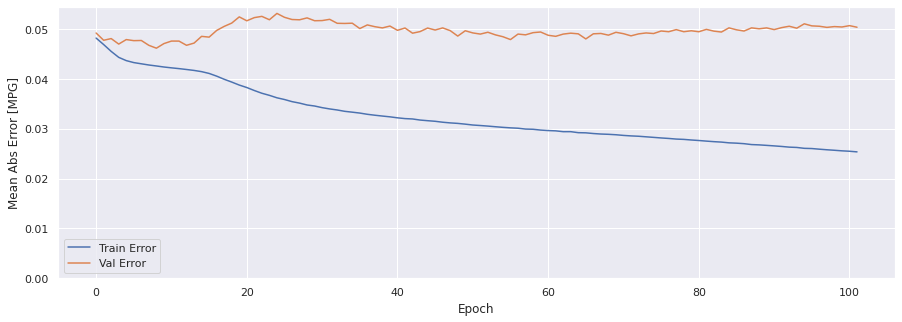

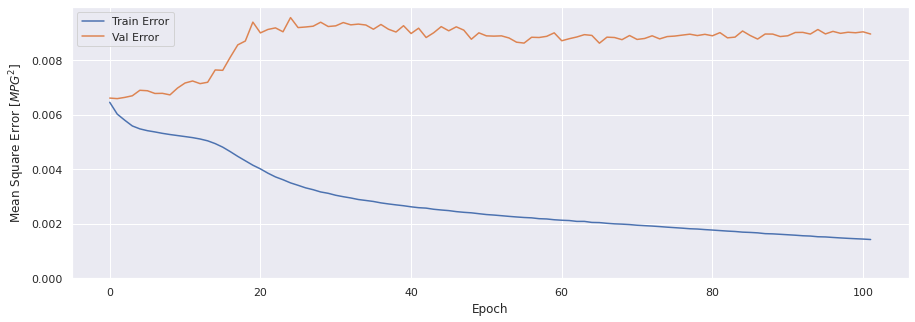

In [180]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history11)

### Evaluar predicciones

In [181]:
score_train12 = model12.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train12[0]}')
print(f'MAE:{score_train12[1]}')
print(f'MSE:{score_train12[2]}')
print(f'SMAPE:{score_train12[3]}')

1401/1401 [==============================] - 19s 14ms/step - loss: 9.1858e-04 - mae: 0.0226 - mse: 9.1858e-04 - smape: 0.7176
Loss:0.0009185803937725723
MAE:0.022566091269254684
MSE:0.0009185803937725723
SMAPE:0.7176434993743896


In [182]:
score_val12 = model12.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val12[0]}')
print(f'MAE:{score_val12[1]}')
print(f'MSE:{score_val12[2]}')
print(f'SMAPE:{score_val12[3]}')

291/291 [==============================] - 4s 15ms/step - loss: 0.0127 - mae: 0.0757 - mse: 0.0127 - smape: 1.2349
Loss:0.01272577978670597
MAE:0.07568931579589844
MSE:0.01272577978670597
SMAPE:1.2348992824554443


In [183]:
score_test12 = model12.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test12[0]}')
print(f'MAE:{score_test12[1]}')
print(f'MSE:{score_test12[2]}')
print(f'SMAPE:{score_test12[3]}')

291/291 [==============================] - 4s 15ms/step - loss: 0.0121 - mae: 0.0769 - mse: 0.0121 - smape: 1.2232
Loss:0.012083319015800953
MAE:0.07685364037752151
MSE:0.012083319015800953
SMAPE:1.2231944799423218


### Comparativa de resultados

In [184]:
result = hist12.iloc[-1]
comparativa12 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test12[1], score_test12[2], score_test12[3], math.sqrt(score_test12[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa12.style.set_caption("Método de ventana de varios pasos - LSTM UNRESTRICTED una capa")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.024142,0.001046,0.757094,0.032348
VALIDACION,0.075689,0.012726,1.235126,0.112809
TEST,0.076854,0.012083,1.223194,0.109924


### Obtener predicciones

In [185]:
trainPredict12 = model12.predict(scaled_trainX)
testPredict12 = model12.predict(scaled_testX)

### Visualización de las predicciones

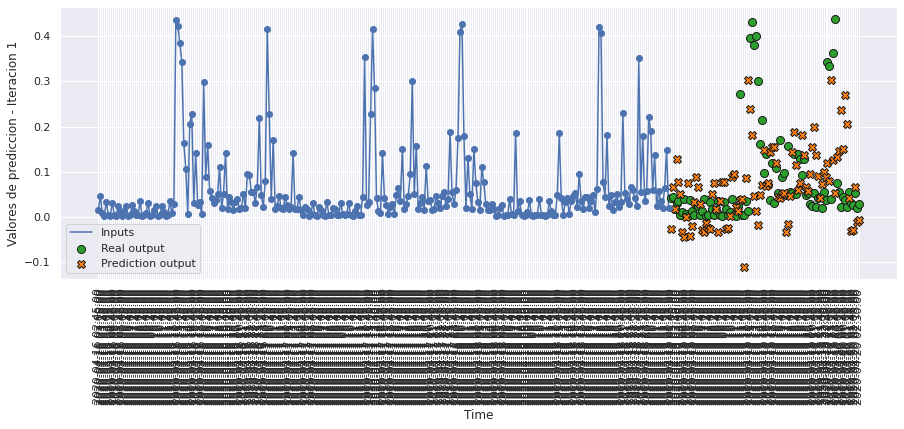

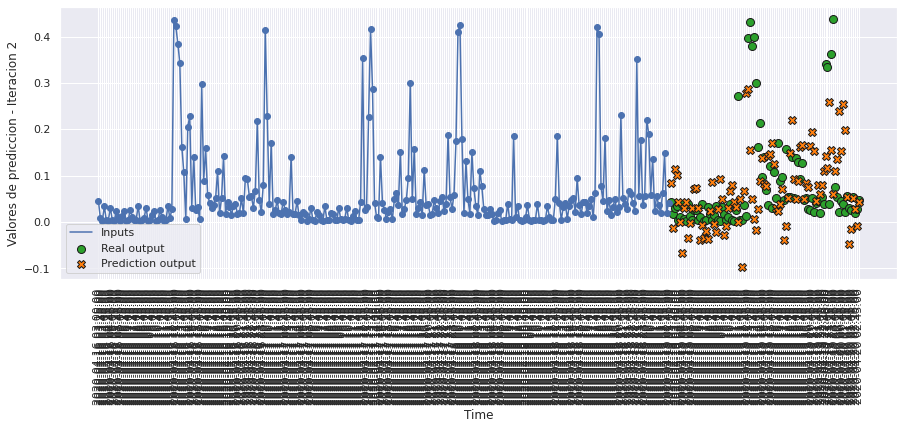

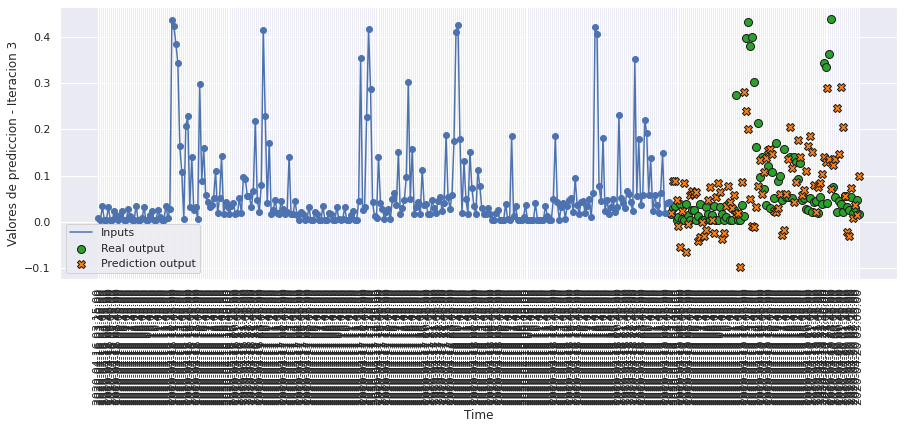

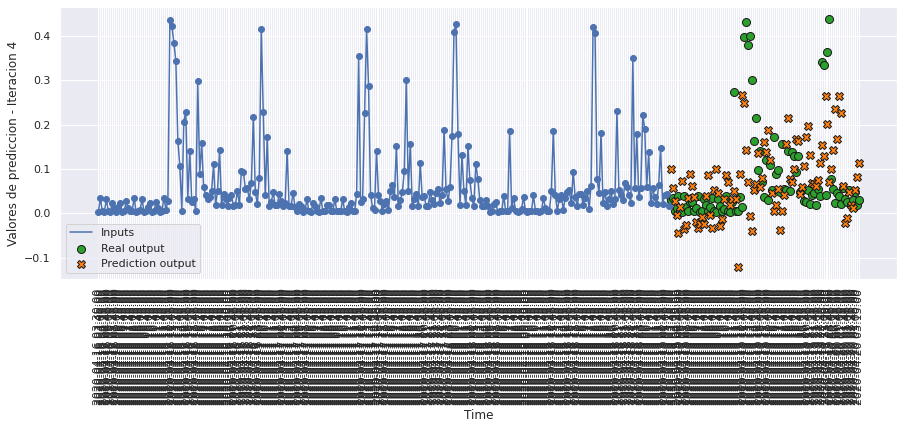

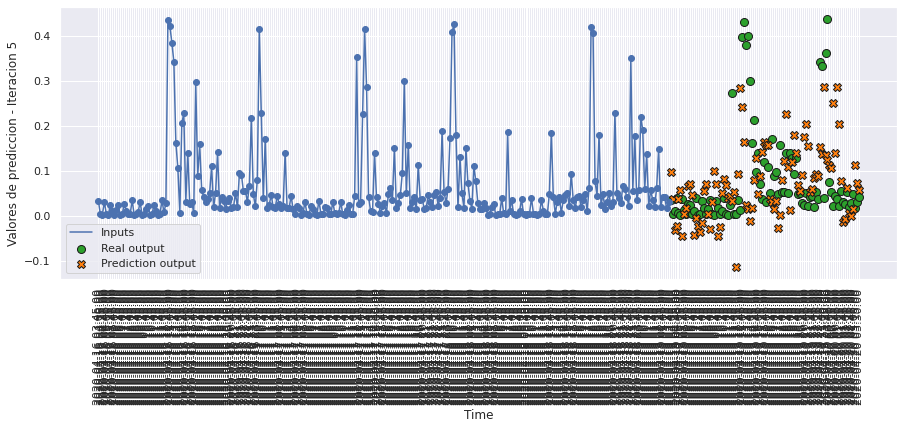

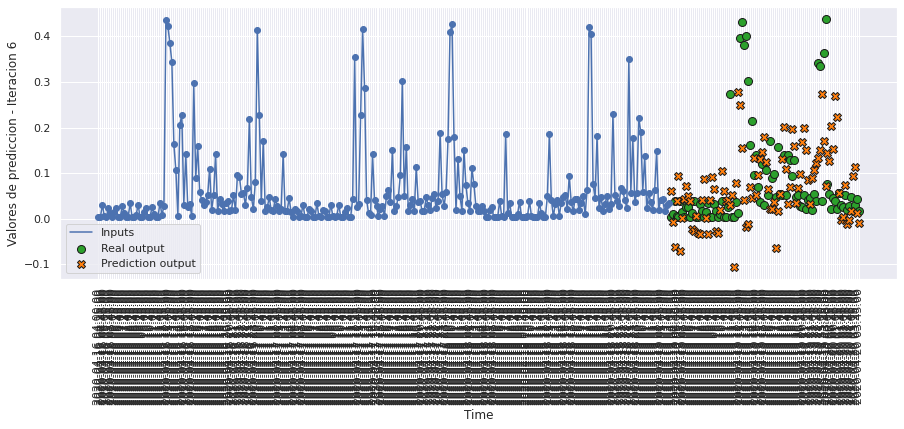

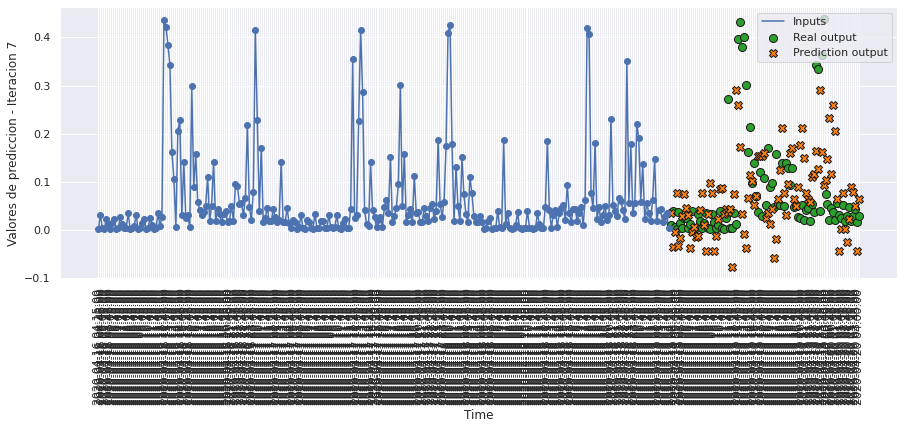

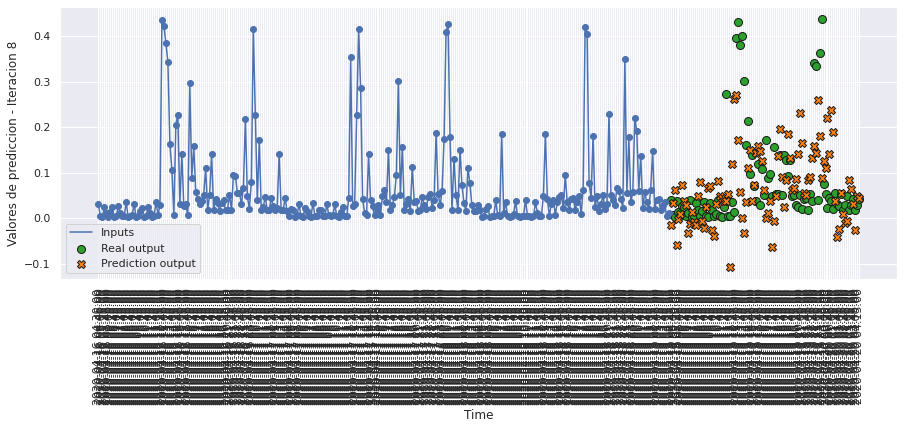

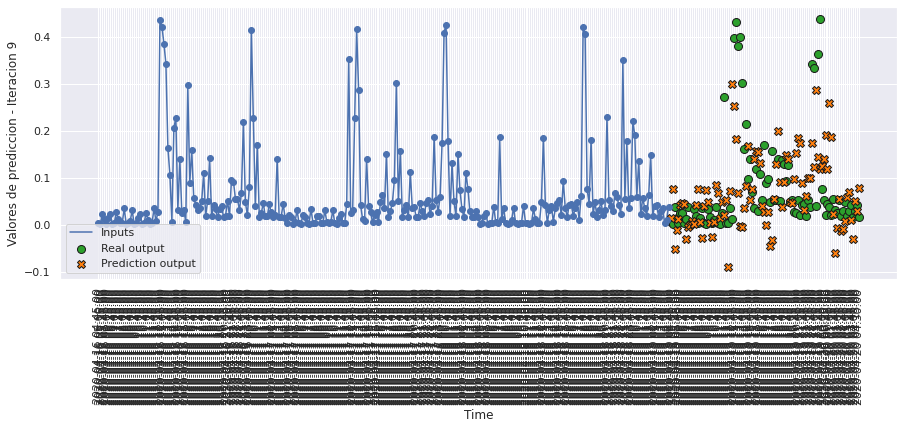

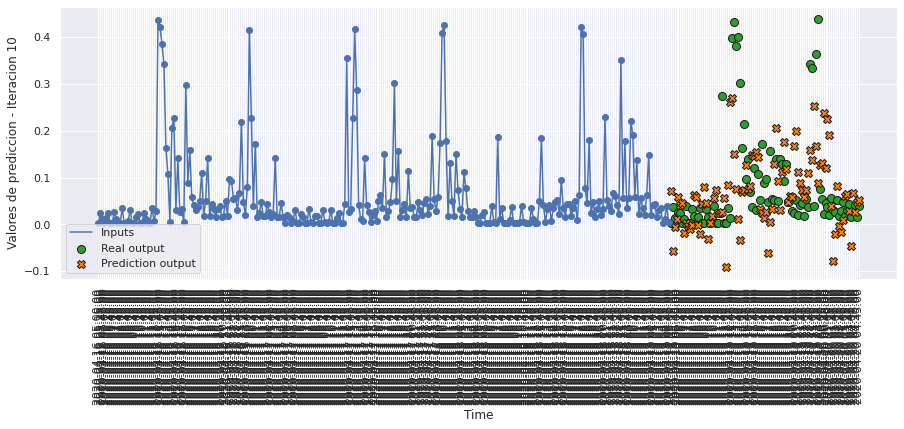

In [186]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict12, 10, 0)

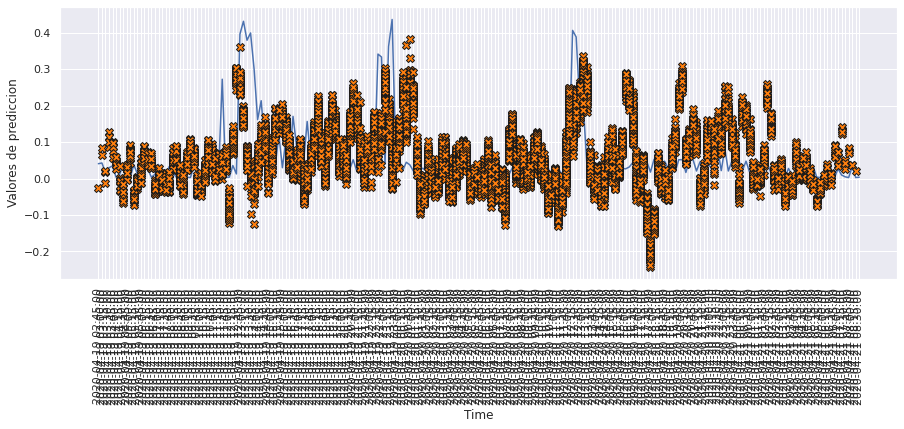

In [187]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict12, 120)

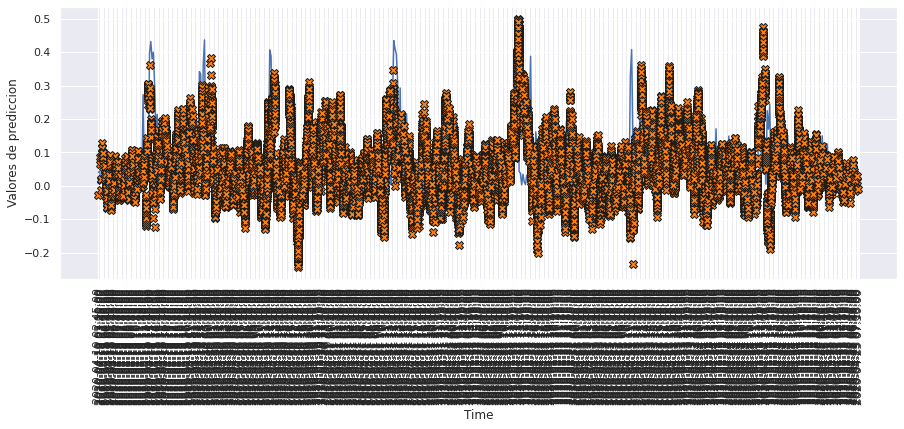

In [188]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict12, 500)

# MODELO 13: LSTM UNRESTRICTED DOS CAPAS

### Construimos el modelo

In [189]:
def build_model13():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [190]:
model13 = build_model13()
model13.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_11 (LSTM)              (None, 288, 128)          69632     
                                                                 
 lstm_12 (LSTM)              (None, 288, 128)          131584    
                                                                 
 flatten_5 (Flatten)         (None, 36864)             0         
                                                                 
 dense_13 (Dense)            (None, 96)                3539040   
                                                                 
Total params: 3,740,256
Trainable params: 3,740,256
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [191]:
history13 = model13.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 26s 67ms/step - loss: 0.0082 - mae: 0.0527 - mse: 0.0082 - smape: 0.8820 - val_loss: 0.0065 - val_mae: 0.0458 - val_mse: 0.0065 - val_smape: 0.8928
Epoch 2/200
351/351 [==============================] - 23s 65ms/step - loss: 0.0056 - mae: 0.0443 - mse: 0.0056 - smape: 0.7967 - val_loss: 0.0064 - val_mae: 0.0452 - val_mse: 0.0064 - val_smape: 0.8519
Epoch 3/200
351/351 [==============================] - 23s 65ms/step - loss: 0.0055 - mae: 0.0437 - mse: 0.0055 - smape: 0.7880 - val_loss: 0.0065 - val_mae: 0.0452 - val_mse: 0.0065 - val_smape: 0.8624
Epoch 4/200
351/351 [==============================] - 23s 64ms/step - loss: 0.0054 - mae: 0.0435 - mse: 0.0054 - smape: 0.7841 - val_loss: 0.0065 - val_mae: 0.0465 - val_mse: 0.0065 - val_smape: 0.8424
Epoch 5/200
351/351 [==============================] - 23s 66ms/step - loss: 0.0054 - mae: 0.0433 - mse: 0.0054 - smape: 0.7849 - val_loss: 0.0066 - val_mae: 0.0476 - val_mse: 0.0066 - val

Epoch 41/200
351/351 [==============================] - 23s 65ms/step - loss: 1.5253e-04 - mae: 0.0096 - mse: 1.5253e-04 - smape: 0.4691 - val_loss: 0.0123 - val_mae: 0.0748 - val_mse: 0.0123 - val_smape: 1.2536
Epoch 42/200
351/351 [==============================] - 23s 65ms/step - loss: 1.3672e-04 - mae: 0.0091 - mse: 1.3672e-04 - smape: 0.4548 - val_loss: 0.0122 - val_mae: 0.0745 - val_mse: 0.0122 - val_smape: 1.2450
Epoch 43/200
351/351 [==============================] - 23s 67ms/step - loss: 1.2969e-04 - mae: 0.0089 - mse: 1.2969e-04 - smape: 0.4473 - val_loss: 0.0121 - val_mae: 0.0741 - val_mse: 0.0121 - val_smape: 1.2462
Epoch 44/200
351/351 [==============================] - 23s 66ms/step - loss: 1.2562e-04 - mae: 0.0087 - mse: 1.2562e-04 - smape: 0.4428 - val_loss: 0.0122 - val_mae: 0.0743 - val_mse: 0.0122 - val_smape: 1.2423
Epoch 45/200
351/351 [==============================] - 23s 64ms/step - loss: 1.1830e-04 - mae: 0.0085 - mse: 1.1830e-04 - smape: 0.4343 - val_loss: 0.0

Epoch 80/200
351/351 [==============================] - 23s 66ms/step - loss: 4.3670e-05 - mae: 0.0051 - mse: 4.3670e-05 - smape: 0.3091 - val_loss: 0.0111 - val_mae: 0.0699 - val_mse: 0.0111 - val_smape: 1.2070
Epoch 81/200
351/351 [==============================] - 22s 63ms/step - loss: 3.9882e-05 - mae: 0.0049 - mse: 3.9882e-05 - smape: 0.3002 - val_loss: 0.0111 - val_mae: 0.0698 - val_mse: 0.0111 - val_smape: 1.2047
Epoch 82/200
351/351 [==============================] - 23s 65ms/step - loss: 3.9059e-05 - mae: 0.0048 - mse: 3.9059e-05 - smape: 0.2979 - val_loss: 0.0110 - val_mae: 0.0695 - val_mse: 0.0110 - val_smape: 1.2050
Epoch 83/200
351/351 [==============================] - 23s 65ms/step - loss: 3.9349e-05 - mae: 0.0049 - mse: 3.9349e-05 - smape: 0.2978 - val_loss: 0.0110 - val_mae: 0.0696 - val_mse: 0.0110 - val_smape: 1.2020
Epoch 84/200
351/351 [==============================] - 23s 66ms/step - loss: 3.8788e-05 - mae: 0.0048 - mse: 3.8788e-05 - smape: 0.2965 - val_loss: 0.0

In [192]:
hist13 = pd.DataFrame(history13.history)
hist13['epoch'] = history13.epoch
hist13

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.008240,0.052705,0.008240,0.882044,0.006460,0.045791,0.006460,0.892807,0
1,0.005573,0.044284,0.005573,0.796730,0.006444,0.045196,0.006444,0.851926,1
2,0.005478,0.043724,0.005478,0.788001,0.006459,0.045217,0.006459,0.862365,2
3,0.005421,0.043462,0.005421,0.784143,0.006457,0.046544,0.006457,0.842447,3
4,0.005381,0.043346,0.005381,0.784903,0.006570,0.047600,0.006570,0.878684,4
...,...,...,...,...,...,...,...,...,...
97,0.000033,0.004416,0.000033,0.277596,0.010778,0.068451,0.010778,1.193321,97
98,0.000033,0.004407,0.000033,0.276470,0.010760,0.068350,0.010760,1.193879,98
99,0.000030,0.004226,0.000030,0.268889,0.010828,0.068623,0.010828,1.196576,99
100,0.000029,0.004151,0.000029,0.265334,0.010825,0.068707,0.010825,1.192966,100


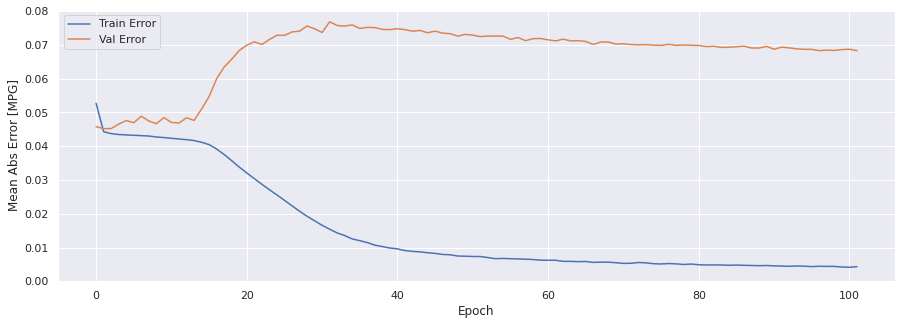

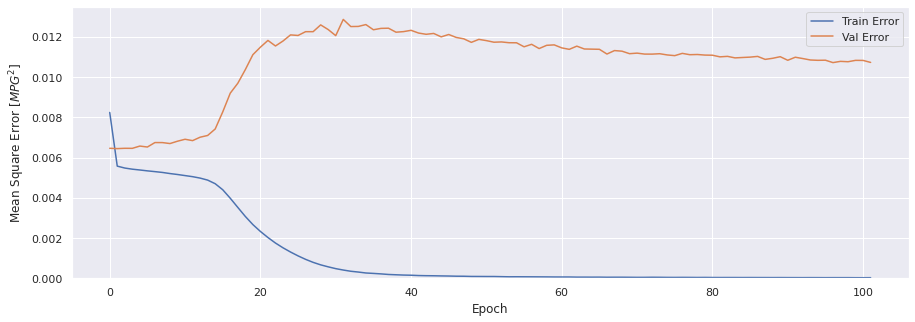

In [193]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history13)

### Evaluar predicciones

In [194]:
score_train13 = model13.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train13[0]}')
print(f'MAE:{score_train13[1]}')
print(f'MSE:{score_train13[2]}')
print(f'SMAPE:{score_train13[3]}')

1401/1401 [==============================] - 34s 24ms/step - loss: 2.9165e-05 - mae: 0.0041 - mse: 2.9165e-05 - smape: 0.2575
Loss:2.9165097657823935e-05
MAE:0.004144746344536543
MSE:2.9165097657823935e-05
SMAPE:0.25746214389801025


In [195]:
score_val13 = model13.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val13[0]}')
print(f'MAE:{score_val13[1]}')
print(f'MSE:{score_val13[2]}')
print(f'SMAPE:{score_val13[3]}')

291/291 [==============================] - 8s 26ms/step - loss: 0.0107 - mae: 0.0683 - mse: 0.0107 - smape: 1.1885
Loss:0.010725877247750759
MAE:0.06829018145799637
MSE:0.010725877247750759
SMAPE:1.1885062456130981


In [196]:
score_test13 = model13.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test13[0]}')
print(f'MAE:{score_test13[1]}')
print(f'MSE:{score_test13[2]}')
print(f'SMAPE:{score_test13[3]}')

291/291 [==============================] - 8s 26ms/step - loss: 0.0098 - mae: 0.0674 - mse: 0.0098 - smape: 1.1568
Loss:0.009763544425368309
MAE:0.06742651015520096
MSE:0.009763544425368309
SMAPE:1.1567589044570923


### Comparativa de resultados

In [197]:
result = hist13.iloc[-1]
comparativa13 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test13[1], score_test13[2], score_test13[3], math.sqrt(score_test13[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa13.style.set_caption("Método de ventana de varios pasos - LSTM UNRESTRICTED dos capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.004332,0.000032,0.273266,0.005613
VALIDACION,0.068290,0.010726,1.188536,0.103566
TEST,0.067427,0.009764,1.156759,0.098811


### Obtener predicciones

In [198]:
trainPredict13 = model13.predict(scaled_trainX)
testPredict13 = model13.predict(scaled_testX)

### Visualización de las predicciones

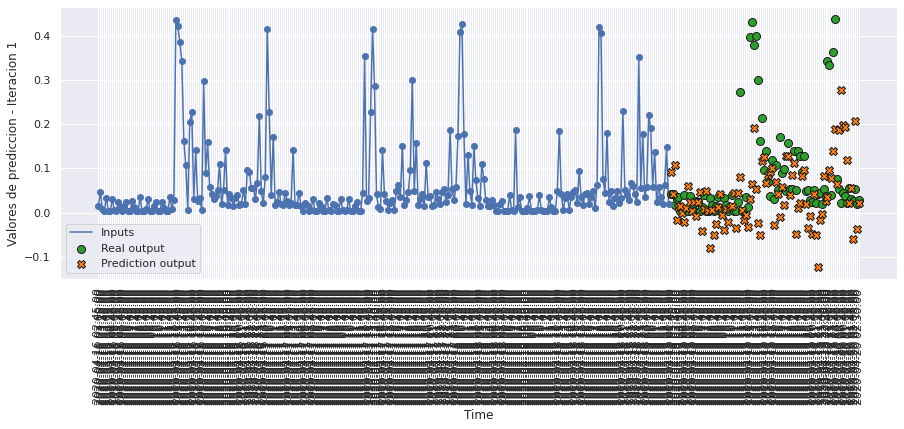

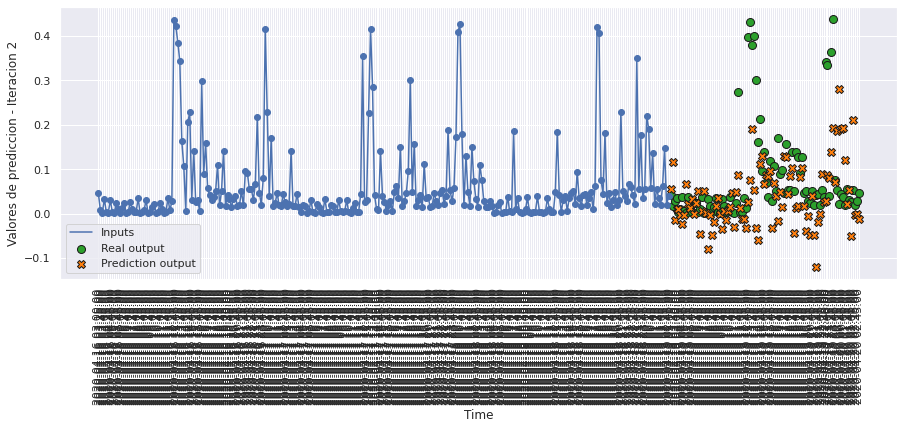

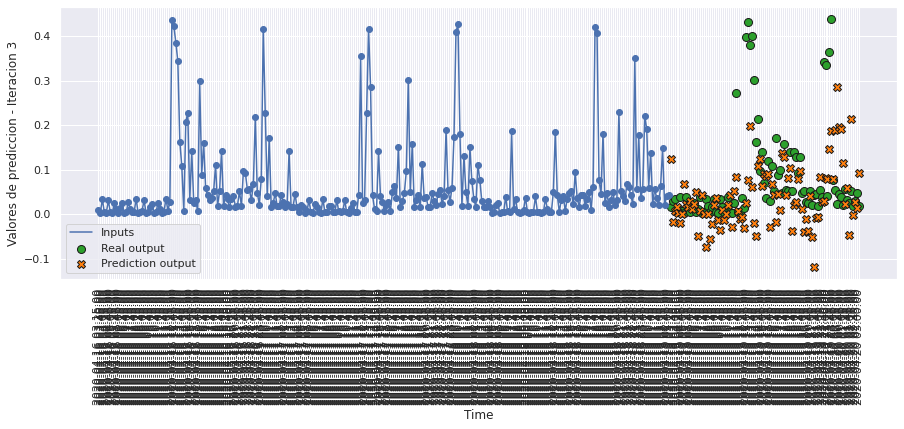

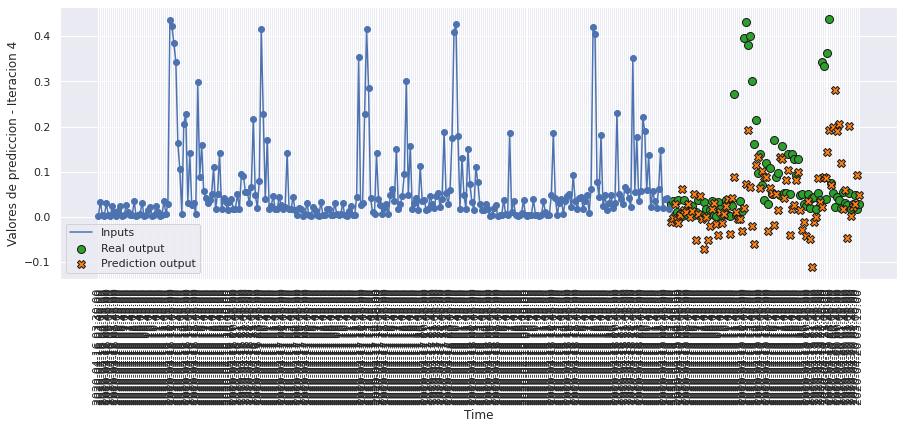

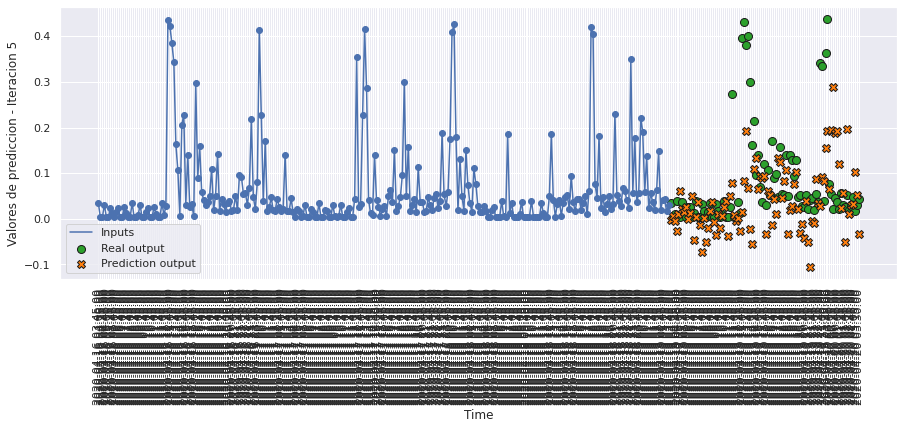

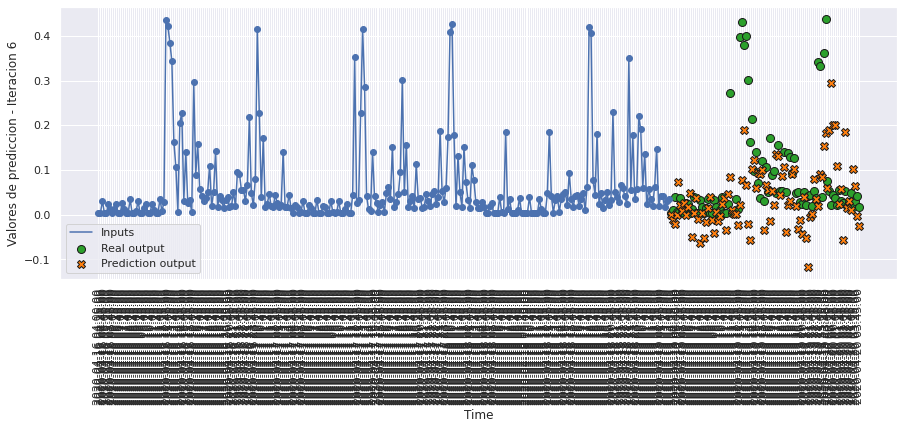

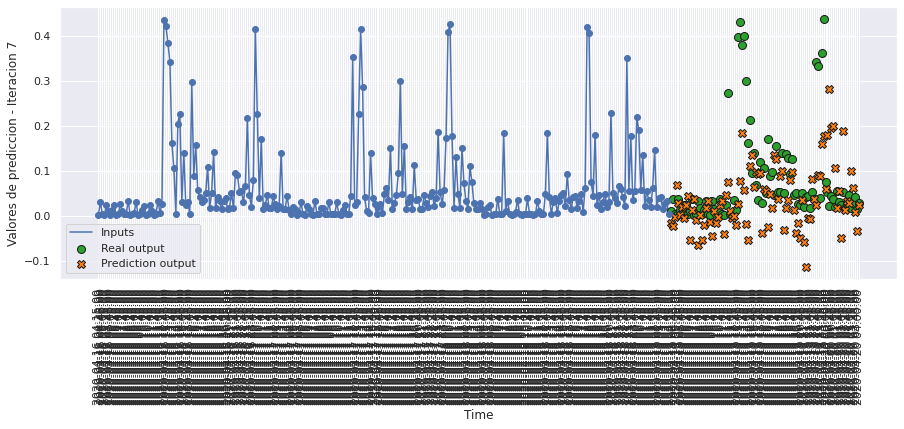

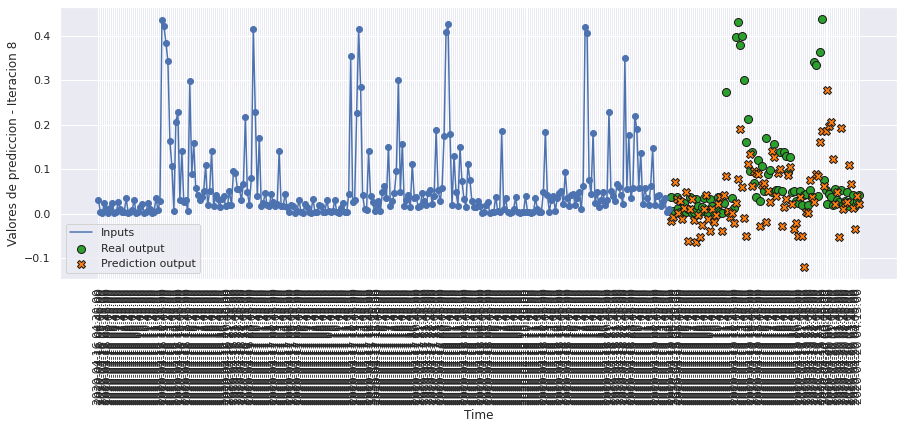

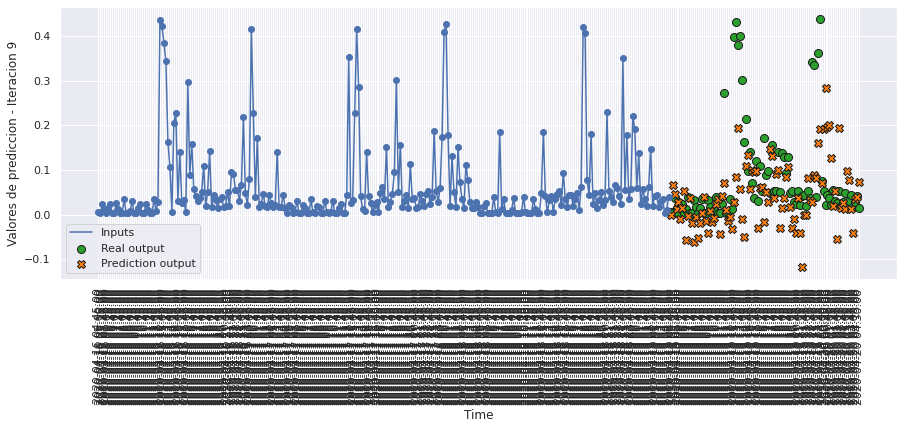

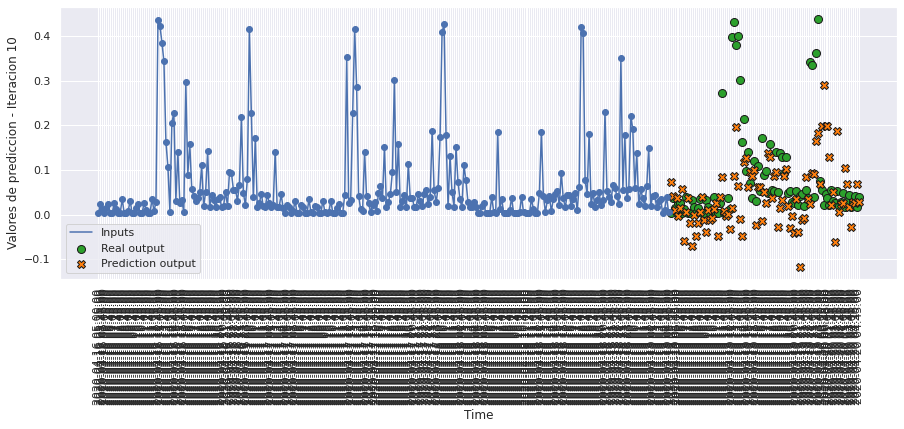

In [199]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict13, 10, 0)

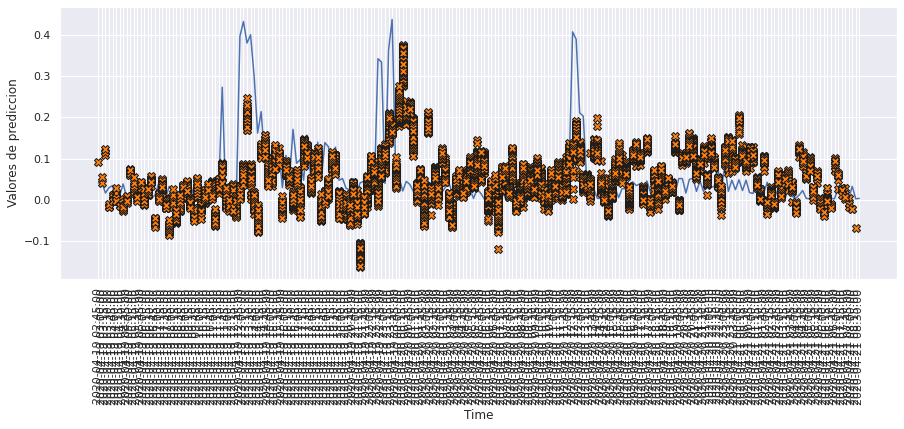

In [200]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict13, 120)

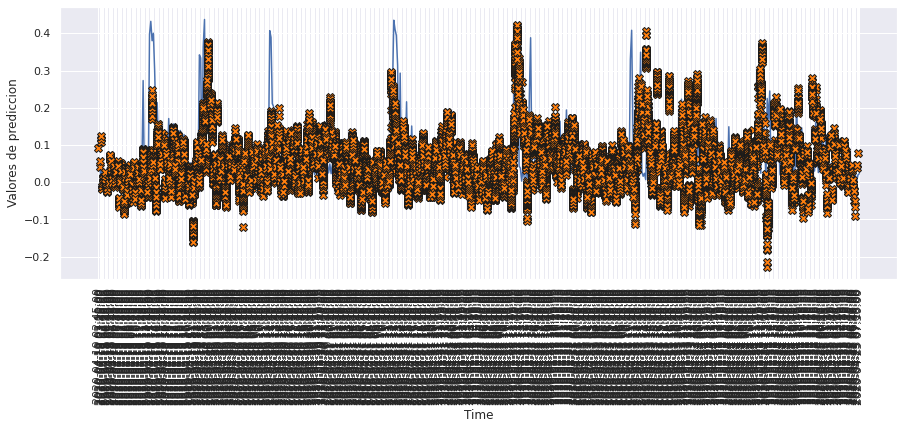

In [201]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict13, 500)

# Comparación de modelos

In [202]:
idx = ['LSTM 1 Layer', 'LSTM 2 Layer', 'LSTM 3 Layer', 'Bidirectional LSTM', 
         'Conv 1D', 'Conv 1D con LSTM', 'ConvLSTM1D', 'ConvLSTM2D', 'LSTM Encode Decode', 
         'GRU 1 Layer', 'GRU 2 Layer', 'LSTM unrestricted 1 layer', 'LSTM unrestricted 2 layer']

col = ['TR_MAE', 'TR_MSE', 'TR_SMAPE', 'TR_RMSE',
       'V_MAE', 'V_MSE', 'V_SMAPE', 'V_RMSE',
       'TS_MAE', 'TS_MSE', 'TS_SMAPE', 'TS_RMSE']

datos = [[score_train1[1], score_train1[2], score_train1[3], math.sqrt(score_train1[2]),
            score_val1[1],   score_val1[2],   score_val1[3],   math.sqrt(score_val1[2]),
           score_test1[1],  score_test1[2],  score_test1[3],  math.sqrt(score_test1[2])],
         [score_train2[1], score_train2[2], score_train2[3], math.sqrt(score_train2[2]),
            score_val2[1],   score_val2[2],   score_val2[3],   math.sqrt(score_val2[2]),
           score_test2[1],  score_test2[2],  score_test2[3],  math.sqrt(score_test2[2])],
         [score_train3[1], score_train3[2], score_train3[3], math.sqrt(score_train3[2]),
            score_val3[1],   score_val3[2],   score_val3[3],   math.sqrt(score_val3[2]),
           score_test3[1],  score_test3[2],  score_test3[3],  math.sqrt(score_test3[2])],
         [score_train4[1], score_train4[2], score_train4[3], math.sqrt(score_train4[2]),
            score_val4[1],   score_val4[2],   score_val4[3],   math.sqrt(score_val4[2]),
           score_test4[1],  score_test4[2],  score_test4[3],  math.sqrt(score_test4[2])],
         [score_train5[1], score_train5[2], score_train5[3], math.sqrt(score_train5[2]),
            score_val5[1],   score_val5[2],   score_val5[3],   math.sqrt(score_val5[2]),
           score_test5[1],  score_test5[2],  score_test5[3],  math.sqrt(score_test5[2])],
         [score_train6[1], score_train6[2], score_train6[3], math.sqrt(score_train6[2]),
            score_val6[1],   score_val6[2],   score_val6[3],   math.sqrt(score_val6[2]),
           score_test6[1],  score_test6[2],  score_test6[3],  math.sqrt(score_test6[2])],
         [score_train7[1], score_train7[2], score_train7[3], math.sqrt(score_train7[2]),
            score_val7[1],   score_val7[2],   score_val7[3],   math.sqrt(score_val7[2]),
           score_test7[1],  score_test7[2],  score_test7[3],  math.sqrt(score_test7[2])],
         [score_train8[1], score_train8[2], score_train8[3], math.sqrt(score_train8[2]),
            score_val8[1],   score_val8[2],   score_val8[3],   math.sqrt(score_val8[2]),
           score_test8[1],  score_test8[2],  score_test8[3],  math.sqrt(score_test8[2])],
         [score_train9[1], score_train9[2], score_train9[3], math.sqrt(score_train9[2]),
            score_val9[1],   score_val9[2],   score_val9[3],   math.sqrt(score_val9[2]),
           score_test9[1],  score_test9[2],  score_test9[3],  math.sqrt(score_test9[2])],
         [score_train10[1], score_train10[2], score_train10[3], math.sqrt(score_train10[2]),
            score_val10[1],   score_val10[2],   score_val10[3],   math.sqrt(score_val10[2]),
           score_test10[1],  score_test10[2],  score_test10[3],  math.sqrt(score_test10[2])],
         [score_train11[1], score_train11[2], score_train11[3], math.sqrt(score_train11[2]),
            score_val11[1],   score_val11[2],   score_val11[3],   math.sqrt(score_val11[2]),
           score_test11[1],  score_test11[2],  score_test11[3],  math.sqrt(score_test11[2])],
         [score_train12[1], score_train12[2], score_train12[3], math.sqrt(score_train12[2]),
            score_val12[1],   score_val12[2],   score_val12[3],   math.sqrt(score_val12[2]),
           score_test12[1],  score_test12[2],  score_test12[3],  math.sqrt(score_test12[2])],
         [score_train13[1], score_train13[2], score_train13[3], math.sqrt(score_train13[2]),
            score_val13[1],   score_val13[2],   score_val13[3],   math.sqrt(score_val13[2]),
           score_test13[1],  score_test13[2],  score_test13[3],  math.sqrt(score_test13[2])]]

comparativa = pd.DataFrame(datos, columns = col, index = idx)
comparativa.style.set_caption("Tabla de comparación de todos los modelos - Método de ventana fecha y valor 288 - 96")

,TR_MAE,TR_MSE,TR_SMAPE,TR_RMSE,V_MAE,V_MSE,V_SMAPE,V_RMSE,TS_MAE,TS_MSE,TS_SMAPE,TS_RMSE
LSTM 1 Layer,0.032098,0.002598,0.717653,0.050970,0.047730,0.008442,0.852143,0.091881,0.049294,0.007532,0.831647,0.086790
LSTM 2 Layer,0.025493,0.001467,0.659625,0.038302,0.050006,0.009351,0.870154,0.096698,0.052123,0.008299,0.887368,0.091097
LSTM 3 Layer,0.022246,0.001096,0.624587,0.033110,0.052163,0.009556,0.911267,0.097754,0.052901,0.008086,0.926417,0.089921
Bidirectional LSTM,0.030160,0.002220,0.710397,0.047113,0.049836,0.008849,0.878539,0.094071,0.049658,0.007571,0.846647,0.087013
Conv 1D,0.040407,0.003672,0.886493,0.060598,0.059936,0.008754,1.144560,0.093563,0.056191,0.007427,1.070987,0.086179
Conv 1D con LSTM,0.028810,0.001884,0.719854,0.043410,0.065204,0.011022,1.105981,0.104985,0.061945,0.009105,1.048523,0.095421
ConvLSTM1D,0.036549,0.002660,0.882804,0.051573,0.076538,0.011718,1.254549,0.108250,0.070054,0.009766,1.173037,0.098825
ConvLSTM2D,0.036310,0.002635,0.877007,0.051329,0.074289,0.011337,1.248686,0.106477,0.063600,0.008773,1.168804,0.093663
LSTM Encode Decode,0.023290,0.001389,0.608997,0.037267,0.051358,0.010537,0.816113,0.102652,0.051400,0.009046,0.797016,0.095113
GRU 1 Layer,0.033970,0.002977,0.750240,0.054558,0.048617,0.008658,0.886895,0.093049,0.049934,0.007712,0.852758,0.087819


<AxesSubplot:title={'center':'Comparativa del error en los modelos para el día del método de ventana de varios pasos fecha y valor'}>

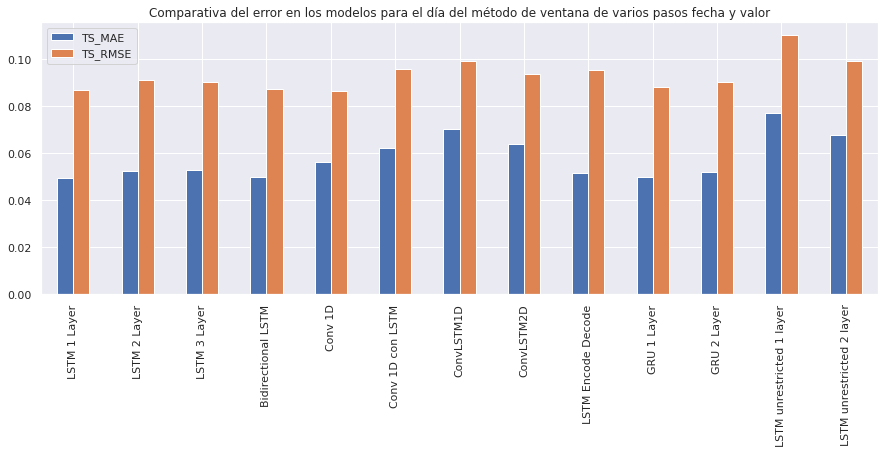

In [203]:
comparativa.loc[:, ['TS_MAE', 'TS_RMSE']].plot(kind='bar', title = 'Comparativa del error en los modelos para el día del método de ventana de varios pasos fecha y valor')

<AxesSubplot:title={'center':'Comparativa del error porcentual absoluto medio simétrico para el día del método de ventana de varios pasos fecha y valor'}>

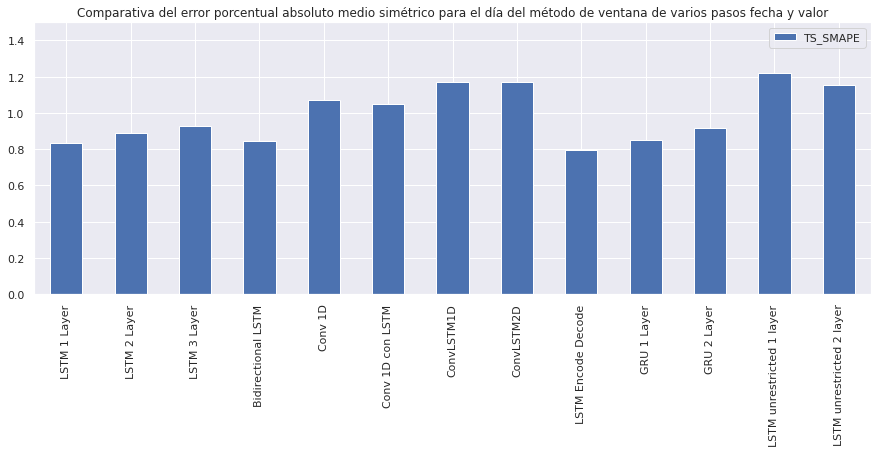

In [204]:
comparativa.loc[:, 'TS_SMAPE'].plot(kind='bar', legend=(['SMAPE']), ylim=(0, 1.5), 
                    title = 'Comparativa del error porcentual absoluto medio simétrico para el día del método de ventana de varios pasos fecha y valor')

# Elección de modelo

In [207]:
model2.save('../../models/datetime_and_value/dayModel/1/')

INFO:tensorflow:Assets written to: ../../models/datetime_and_value/dayModel/1/assets


INFO:tensorflow:Assets written to: ../../models/datetime_and_value/dayModel/1/assets
